In [3]:
featurizer,mol_to_data = (molNet.featurizer.get_molecule_featurizer_info,None)

In [4]:
featurizer = featurizer()

featurizer["isListFeat"] = featurizer["instance"].apply(lambda f: isinstance(f,FeaturizerList))
featurizer.drop(featurizer.index[featurizer["isListFeat"]], inplace=True)
featurizer=featurizer[featurizer.dtype!=bool]
featurizer=featurizer[featurizer.length>0]
#featurizer=featurizer[featurizer.length<2]

featurizer=featurizer.sort_values("length")
featurizer

,length,dtype,instance,class,module,isListFeat
molNet.featurizer._manual_molecule_featurizer.molecule_num_fragments,1,<class 'numpy.int32'>,NumFragments_Featurizer,<class 'molNet.featurizer._manual_molecule_fea...,molNet.featurizer._manual_molecule_featurizer,False
molNet.featurizer._autogen_rdkit_feats_numeric_molecule_featurizer.molecule_MaxEStateIndex_featurizer,1,<class 'numpy.float32'>,Molecule_MaxEStateIndex_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_numeric...,False
molNet.featurizer._autogen_rdkit_feats_numeric_molecule_featurizer.molecule_fr_ArN_featurizer,1,<class 'numpy.int32'>,Molecule_fr_ArN_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_numeric...,False
molNet.featurizer._autogen_rdkit_feats_numeric_molecule_featurizer.molecule_InertialShapeFactor_featurizer,1,<class 'numpy.float32'>,Molecule_InertialShapeFactor_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_numeric...,False
molNet.featurizer._autogen_rdkit_feats_numeric_molecule_featurizer.molecule_fr_dihydropyridine_featurizer,1,<class 'numpy.int32'>,Molecule_fr_dihydropyridine_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_numeric...,False
...,...,...,...,...,...,...
molNet.featurizer._autogen_rdkit_feats_array_molecule_featurizer.molecule_MORSE_featurizer,224,<class 'numpy.float32'>,Molecule_MORSE_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_array_m...,False
molNet.featurizer._autogen_rdkit_feats_array_molecule_featurizer.molecule_GETAWAY_featurizer,273,<class 'numpy.float32'>,Molecule_GETAWAY_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_array_m...,False
molNet.featurizer._autogen_rdkit_feats_array_molecule_featurizer.molecule_ErGFingerprint_featurizer,315,<class 'numpy.float32'>,Molecule_ErGFingerprint_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_array_m...,False
molNet.featurizer._autogen_rdkit_feats_vec_molecule_featurizer.molecule_HashedAtomPairFingerprint_featurizer,2048,<class 'numpy.int32'>,Molecule_HashedAtomPairFingerprint_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_vec_mol...,False


In [5]:
path=os.path.join(molNet.get_user_folder(),"autodata","ecdf")
dataloader = "ESOL"
dl_path=os.path.join(path,"raw_features",dataloader)
featurizer["ecfd_path"]=[os.path.join(dl_path,*mod.split("."))+".dat" for mod in featurizer.index]

def _cz(r):
    if not os.path.exists(r["ecfd_path"]):
        return np.nan
    #try:
    return np.memmap(r["ecfd_path"], dtype=r["dtype"], mode='r',).size
    #except (ValueError,FileNotFoundError):
    #    return np.nan
featurizer["current_size"] = featurizer[["ecfd_path","dtype"]].apply(
            _cz,
            axis=1)
featurizer[~np.isnan(featurizer["current_size"])]

,length,dtype,instance,class,module,isListFeat,ecfd_path,current_size
molNet.featurizer._manual_molecule_featurizer.molecule_num_fragments,1,<class 'numpy.int32'>,NumFragments_Featurizer,<class 'molNet.featurizer._manual_molecule_fea...,molNet.featurizer._manual_molecule_featurizer,False,/home/jupyteruser/jupyter_data/.molNet/autodat...,1144
molNet.featurizer._autogen_rdkit_feats_numeric_molecule_featurizer.molecule_MaxEStateIndex_featurizer,1,<class 'numpy.float32'>,Molecule_MaxEStateIndex_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_numeric...,False,/home/jupyteruser/jupyter_data/.molNet/autodat...,1144
molNet.featurizer._autogen_rdkit_feats_numeric_molecule_featurizer.molecule_fr_ArN_featurizer,1,<class 'numpy.int32'>,Molecule_fr_ArN_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_numeric...,False,/home/jupyteruser/jupyter_data/.molNet/autodat...,1144
molNet.featurizer._autogen_rdkit_feats_numeric_molecule_featurizer.molecule_InertialShapeFactor_featurizer,1,<class 'numpy.float32'>,Molecule_InertialShapeFactor_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_numeric...,False,/home/jupyteruser/jupyter_data/.molNet/autodat...,1144
molNet.featurizer._autogen_rdkit_feats_numeric_molecule_featurizer.molecule_fr_dihydropyridine_featurizer,1,<class 'numpy.int32'>,Molecule_fr_dihydropyridine_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_numeric...,False,/home/jupyteruser/jupyter_data/.molNet/autodat...,1144
...,...,...,...,...,...,...,...,...
molNet.featurizer._autogen_rdkit_feats_array_molecule_featurizer.molecule_MORSE_featurizer,224,<class 'numpy.float32'>,Molecule_MORSE_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_array_m...,False,/home/jupyteruser/jupyter_data/.molNet/autodat...,256256
molNet.featurizer._autogen_rdkit_feats_array_molecule_featurizer.molecule_GETAWAY_featurizer,273,<class 'numpy.float32'>,Molecule_GETAWAY_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_array_m...,False,/home/jupyteruser/jupyter_data/.molNet/autodat...,312312
molNet.featurizer._autogen_rdkit_feats_array_molecule_featurizer.molecule_ErGFingerprint_featurizer,315,<class 'numpy.float32'>,Molecule_ErGFingerprint_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_array_m...,False,/home/jupyteruser/jupyter_data/.molNet/autodat...,360360
molNet.featurizer._autogen_rdkit_feats_vec_molecule_featurizer.molecule_HashedAtomPairFingerprint_featurizer,2048,<class 'numpy.int32'>,Molecule_HashedAtomPairFingerprint_Featurizer,<class 'molNet.featurizer._autogen_rdkit_feats...,molNet.featurizer._autogen_rdkit_feats_vec_mol...,False,/home/jupyteruser/jupyter_data/.molNet/autodat...,2342912


In [6]:
loader = PreparedMolDataLoader(dataloaderclass())
def load_mols(loader, limit=None) -> List[Mol]:
    if limit is not None and limit > 0:
        return loader.get_n_entries(limit)
    return [mol for mol in tqdm(
        loader, unit="mol", unit_scale=True, total=loader.expected_data_size
    )]
mols = load_mols(loader)

2021-11-30 09:29:21 23febc5ca9ab molNet[22734] INFO You are using a citable datasource ('ESOL'), please consider citing 'https://doi.org/10.1021/ci034243x'!
100%|██████████| 1.14k/1.14k [00:00<00:00, 10.7kmol/s]


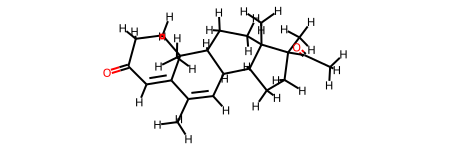

In [7]:
mols[0]

In [8]:
from molNet.mol.mol import parallel_featurize_mol

In [11]:
f=featurizer.iloc[1]
display(f["instance"])
a = np.memmap("test", dtype=f['dtype'], mode='w+', shape=(len(mols),f['length']))
parallel_featurize_mol(mols,f["instance"],target_array=a,cores=1)

{'name': 'Molecule_MaxEStateIndex_Featurizer', 'description': None, 'dtype': <class 'numpy.float32'>, 'norm': 'unity', 'length': 1}

2021-11-30 09:30:08 23febc5ca9ab molNet[22734] DEBUG using 1 cores to work on 1 fragments
100%|██████████| 1144/1144 [00:01<00:00, 960.39 mol/s]


memmap([[14.375746],
        [11.011616],
        [ 8.775561],
        ...,
        [13.335892],
        [11.390093],
        [ 7.986669]], dtype=float32)

In [ ]:
empty_bytes = (np.ones_like(a[0])*np.nan).astype(a.dtype)
empty_bytes

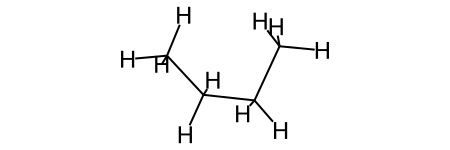

In [34]:
from rdkit import Chem
from molNet.utils.mol.properties import assert_conformers
mol = Chem.MolFromSmiles("CCCC")
mol2 = assert_conformers(mol)
mol3=prepare_mol_for_featurization(mol)
mol2

In [36]:
from multiprocessing import current_process,cpu_count
cpu_count()

64

In [13]:
import sys
import os

In [14]:
modp = os.path.dirname(os.path.dirname(os.path.abspath("")))
if modp not in sys.path:
    sys.path.insert(0,modp)
    sys.path.append(modp)

In [15]:
from IPython.core.display import Image
from tools.ecdf import ecdf_conf
from tools.ecdf._generate_ecdf_helper import test_mol, \
    _single_call_parallel_featurize_molfiles, get_molecule_featurizer, attach_output_dir_molecule_featurizer, \
    write_info, _single_call_check_distributionfiles, ECDFGroup,get_info, save_info
import matplotlib.pyplot as plt
import numpy as np
import inspect
from inspect import isfunction,getsource,getfile

from molNet.featurizer import normalization
from scipy._lib._util import getfullargspec_no_self as _getfullargspec
from pprint import pprint

In [16]:
import numba
from numba.core.registry import CPUDispatcher

norm_functions={}
for f in dir(normalization):
    func = getattr(normalization,f)
    #print(f,func,func.__class__)
    if (isfunction(func) or isinstance(func,CPUDispatcher)) and "norm" in func.__name__:
        norm_functions[func.__name__]=func
        print(getsource(func))

#del norm_functions['dual_sig_norm']

#ta=np.linspace(0,2,4).reshape(2,2)
#tv=0.1
#for nn,nf in norm_functions.items():
#    print(nn,end=" ")
#    print(nf(tv),end=" ")
#    print(nf(ta),end=" ")    
norm_functions
#

@jit(nopython=True)
def dual_sig_norm(x, m: float = 0, d1: float = 1, d2: float = 1):
    dt=max(d1/d2,d2/d1)*10
    s1=sig_norm(x, m, d1)
    s2=sig_norm(x, m, d2)
    st=sig_norm(x, m, dt)
    return s1*(1-st)+s2*st

@jit(nopython=True)
def genlog_norm(x, B: float = 1, M: float = 0, Q: float = 1, v: float = 0.1):
    # B=growth rate (-np.inf,np.inf)
    # M=shifts horizontally (-np.inf,np.inf)
    # Q=urvibess/stepness (0,np.inf)
    # v=stepness (1e-12,np.inf)
    return 1 / (1 + Q * np.exp(-B * (x - M))) ** (1 / v)

@jit(nopython=True)
def linear_norm(x, m: float = 1, c: float = 0):
    return x * m + c

@jit(nopython=True)
def min_max_norm(x, min: float = 0, max: float = 1):
    # if min>max:
    #    max,min=min,max
    # if min == max:
    #    max*= 1+1e-6
    ll:double = 0.0
    ul:double = 1.0
    return jitclip(linear_norm(x, m=1 / (max - min), c=-min / (max - min)),ll,ul)

@jit(nopython=True)
def sig_norm(x, m: float = 0, d: float = 1):
    return 1 / (1 + np.exp(-d * (x - 

{'dual_sig_norm': CPUDispatcher(<function dual_sig_norm at 0x7fa761844b80>),
 'genlog_norm': CPUDispatcher(<function genlog_norm at 0x7fa76777e670>),
 'linear_norm': CPUDispatcher(<function linear_norm at 0x7fa761844670>),
 'min_max_norm': CPUDispatcher(<function min_max_norm at 0x7fa761844820>),
 'sig_norm': CPUDispatcher(<function sig_norm at 0x7fa7618449d0>),
 'tanh_norm': CPUDispatcher(<function tanh_norm at 0x7fa7618444c0>)}

In [22]:
from scipy.stats import linregress
def fit_norm_classic(normf,x,y):
    sig = _getfullargspec(normf)
    if norm_functions['min_max_norm'] == normf:
        popt= [x.min(),x.max()]
        if popt[0]==popt[1]:
            return None
    elif norm_functions['linear_norm'] == normf:
        popt= linregress(x, y)[:2]
    
    else:
        return None
    normres=normf(x,*popt)
    r=np.sqrt(((normres-y)**2).mean())
    return {"error":r,
            "input_range":[x.min(),x.max()],
            "output_range":[normres.min(),normres.max()],
            "parameter":dict(zip(sig.args[1:],popt))}

fit_norm_classic_p=['min_max_norm','linear_norm']

from scipy.optimize import curve_fit
def fit_norm_scipy_curve(normf,x,y):
    bounds=(-np.inf, np.inf)#
    p0=None
    
    sig = _getfullargspec(normf)
    if len(x)<len(sig.args)-1:
        return None
    res=[]
    #edge_cases
    if norm_functions['min_max_norm'] == normf:
        bounds=(x.min(),x.max())
        p0= [x.min()+1e-32,x.max()-1e-32]
    elif norm_functions['genlog_norm'] == normf:
        bounds=([1e-32,-np.inf,0,1e-12],[np.inf,np.inf,np.inf,np.inf])
    elif norm_functions['dual_sig_norm'] == normf:
        bounds=([-np.inf,1e-32,1e-32],[np.inf,np.inf,np.inf])
    elif norm_functions['tanh_norm'] == normf:
        bounds=([-np.inf,1e-32],[np.inf,np.inf])
        p0= [x.mean(),1e-32]

    for method in [None,'dogbox']:
        r=None
        for i in range(10):
            try:
                if p0 is None:
                    _p0=np.random.rand(len(sig.args)-1)
                else:
                    _p0=p0
                #print(x)
                #print(normf(x,*_p0))
                
                popt, pcov = curve_fit(normf, x,y, method=method,p0=_p0,bounds=bounds)
                normres=normf(x,*popt)
                r=np.sqrt(((normres-y)**2).mean())
                if np.isnan(r):
                    raise ValueError("r is infinite")
                break
            except RuntimeError:
                pass
        if r is not None:
            
            res.append({"error":r,
                        "input_range":[x.min(),x.max()],
                        "output_range":[normres.min(),normres.max()],
                        "method":method,
                        "parameter":dict(zip(sig.args[1:],popt))})
    if len(res)==0:
        return None
    return sorted(res,key=lambda d:d["error"])[0]

fit_norm_scipy_curve_p=['dual_sig_norm', 'genlog_norm', 'linear_norm', 'min_max_norm', 'sig_norm','tanh_norm']

In [18]:
mf = get_molecule_featurizer(check_number=False)
attach_output_dir_molecule_featurizer(mf, ecdf_conf, create=False)

found 3641 molecule featurizer
543 remain after removal of ignored


In [19]:
egs={}
classes=[
    'molecule_featurizer',
    '_autogen_rdkit_feats_numeric_molecule_featurizer',
    '_autogen_rdkit_feats_list_molecule_featurizer',
    '_autogen_rdkit_feats_rdkit_vec_molecule_featurizer',
]
cf = lambda _f: getfile(_f.__class__).split(os.sep)[-1].replace(".py","")

classes.extend(set([cf(f) for f in mf])-set(classes))
for f in sorted(mf,key=lambda _f: classes.index(cf(_f))):
    #print(f)
    eg = ECDFGroup(f.feature_dist_gpckl, save_full_data=False, save_smooth_data=True)
    egs[f]=eg
#    display(eg.dist_data)
    

fits 0 dual_sig_norm missing
BCUT2D_LOGPHI_Featurizer
956 956
1434 1434
fit BCUT2D_LOGPHI_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99


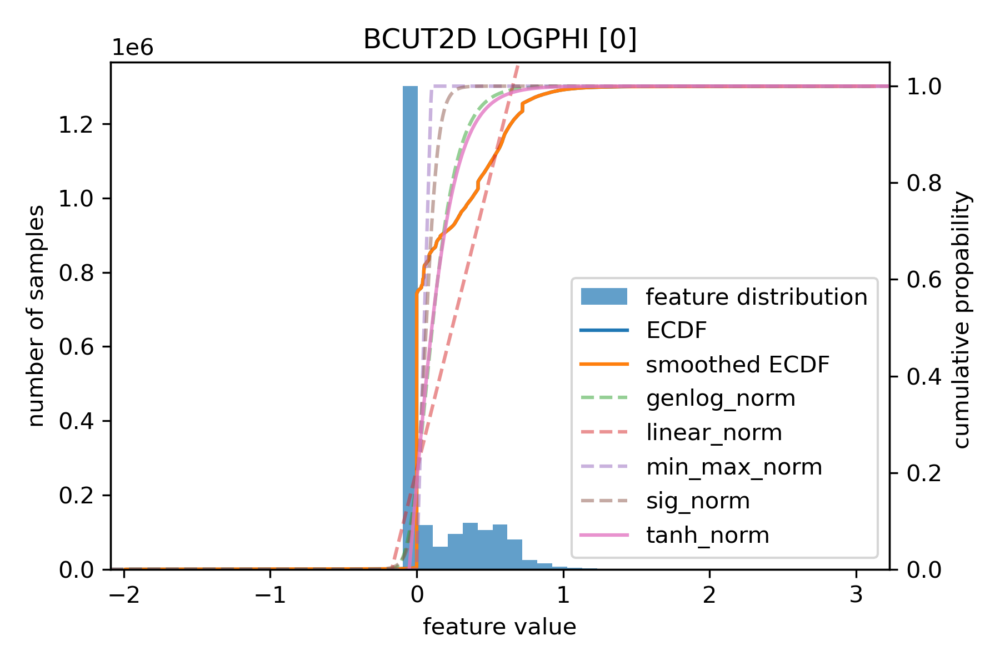

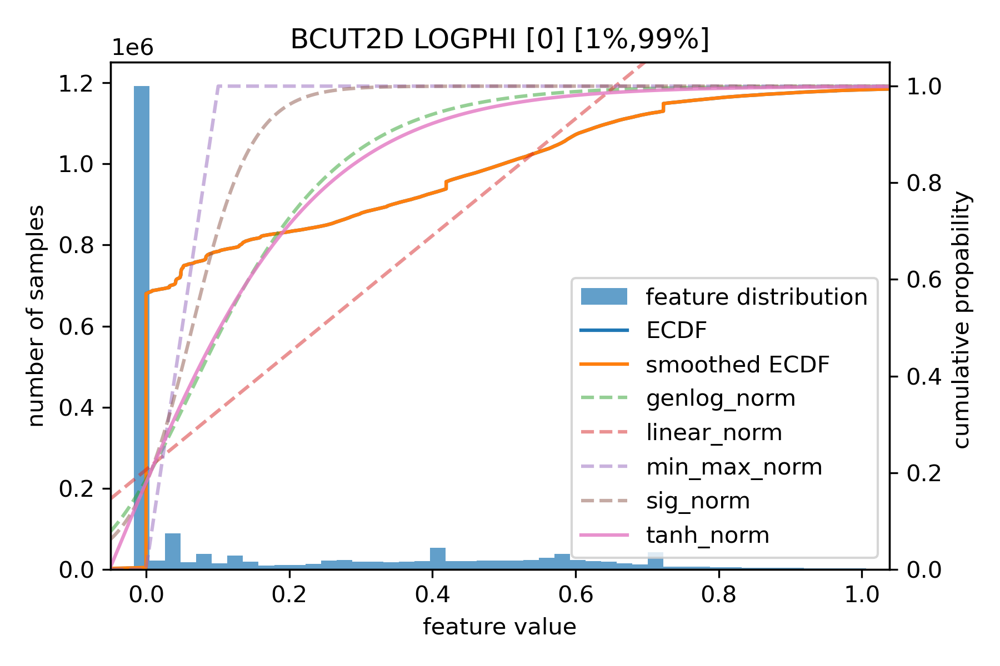

fits 0 genlog_norm missing
EState_VSA7_Featurizer
2 2
3 3
fit EState_VSA7_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


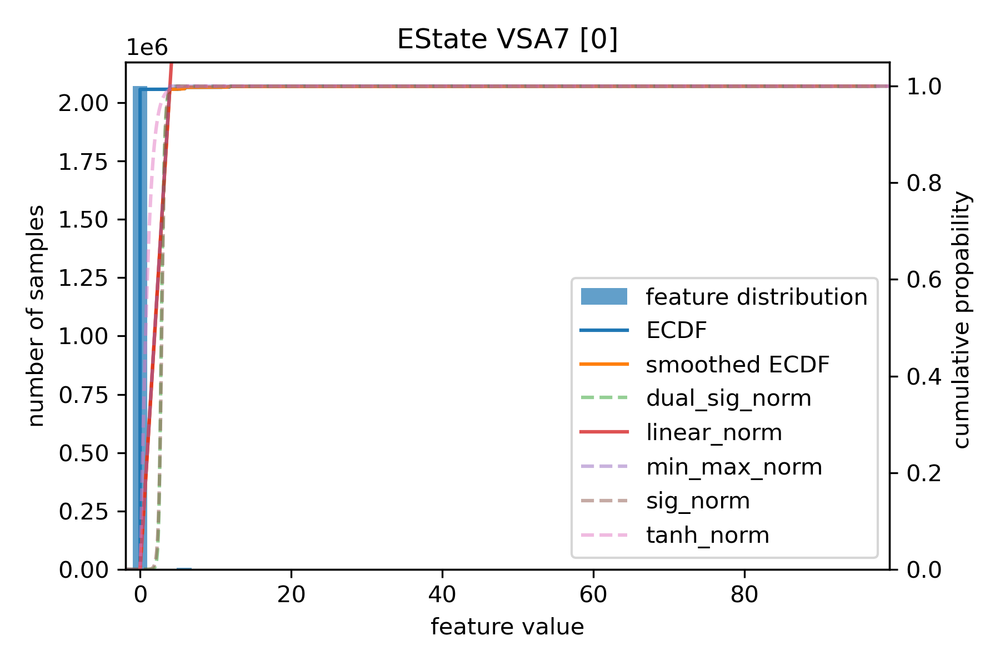

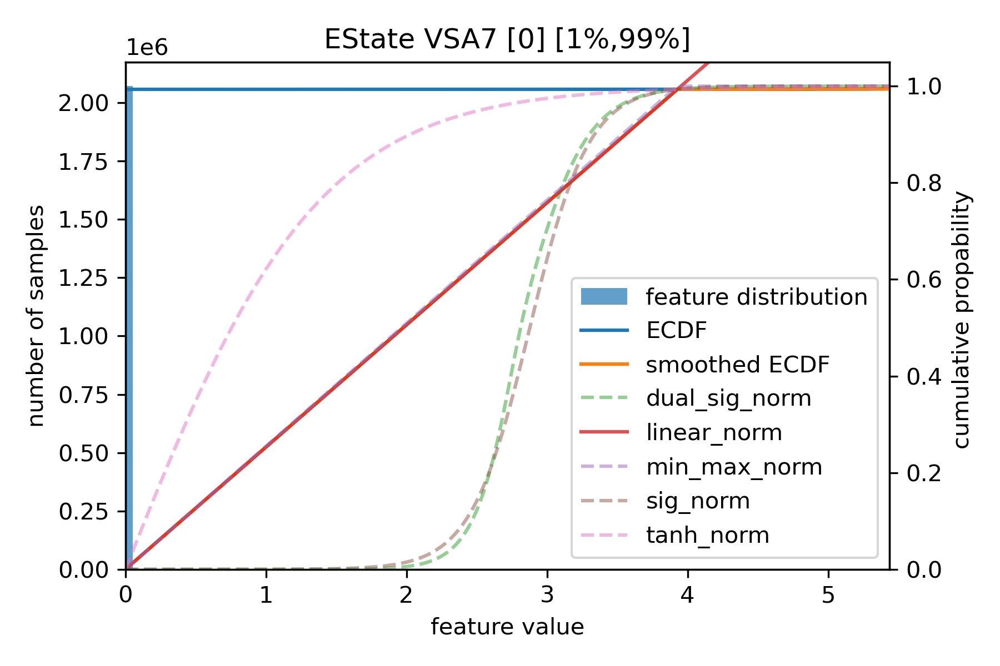

subfeats 0 missing
GetNumberAtomsAc_Featurizer
cannot create ecdf for GetNumberAtomsAc_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsAg_Featurizer
2 2
3 3
fit GetNumberAtomsAg_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


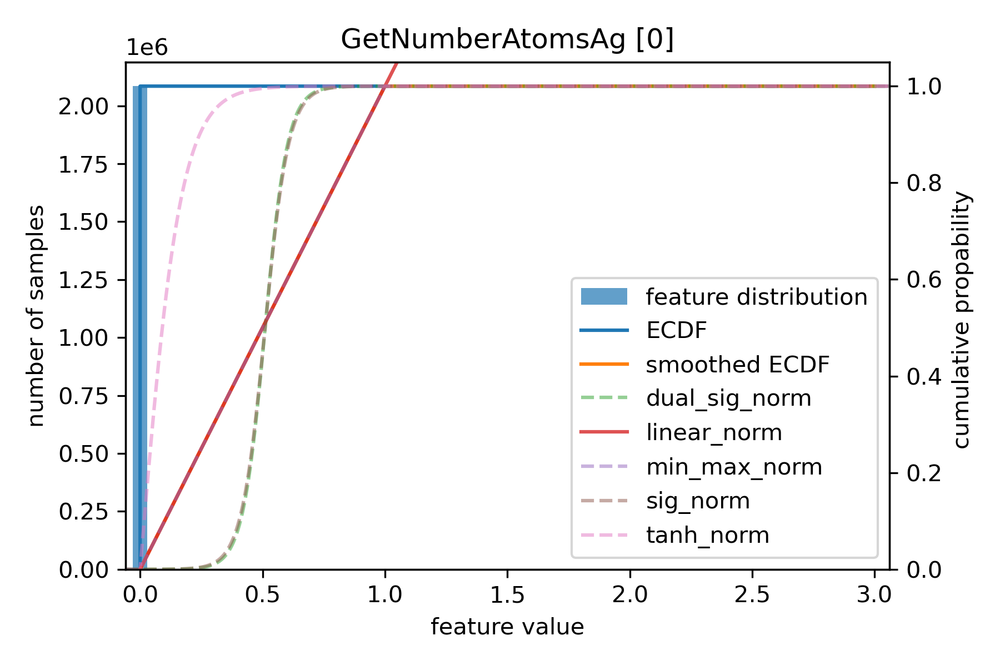

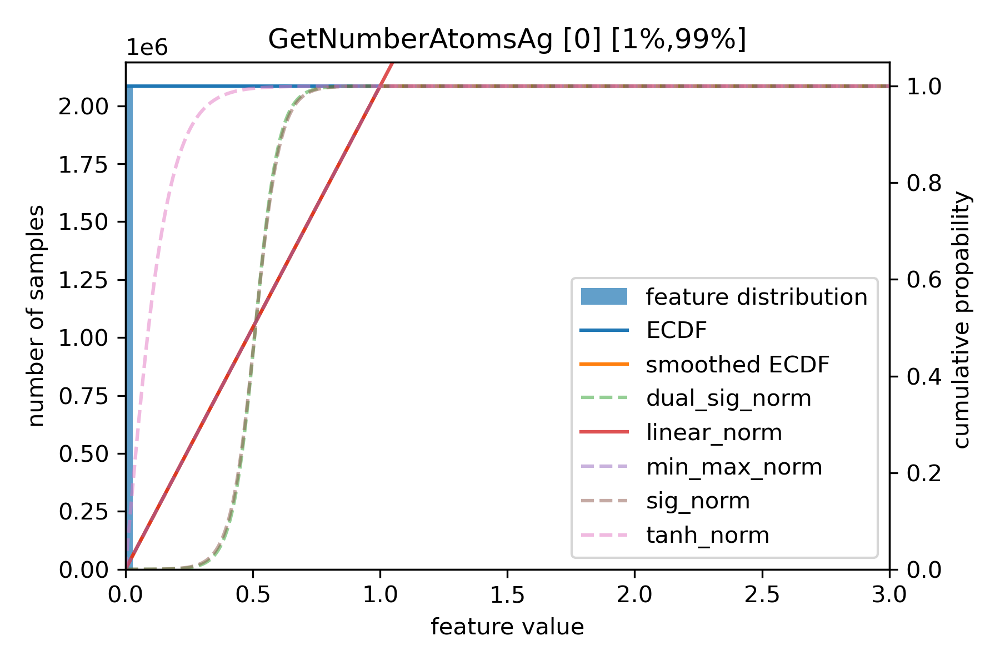

fits 0 genlog_norm missing
GetNumberAtomsAl_Featurizer
2 2
3 3
fit GetNumberAtomsAl_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


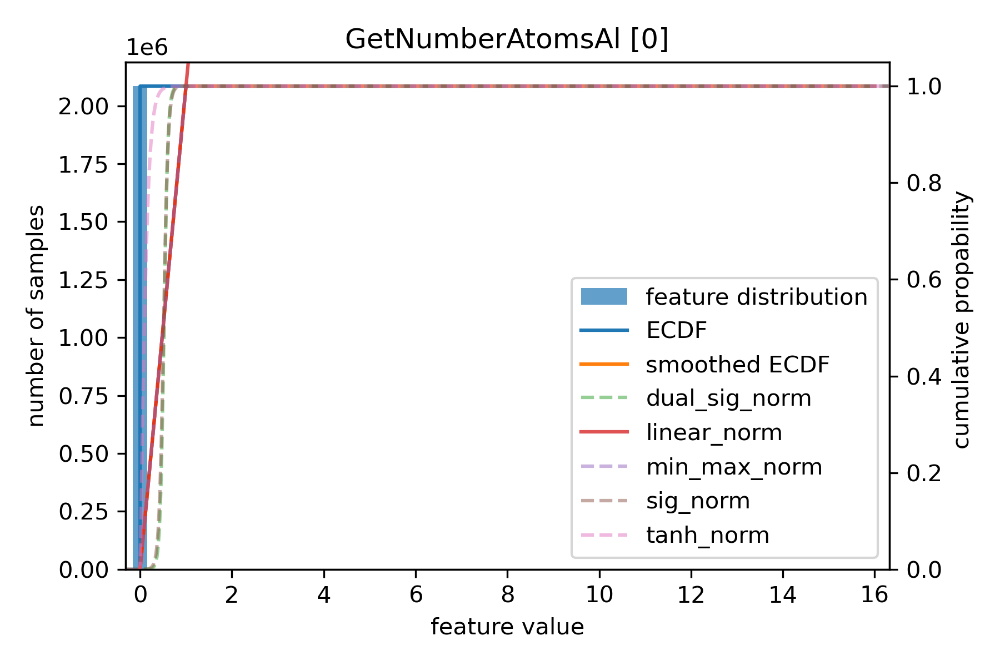

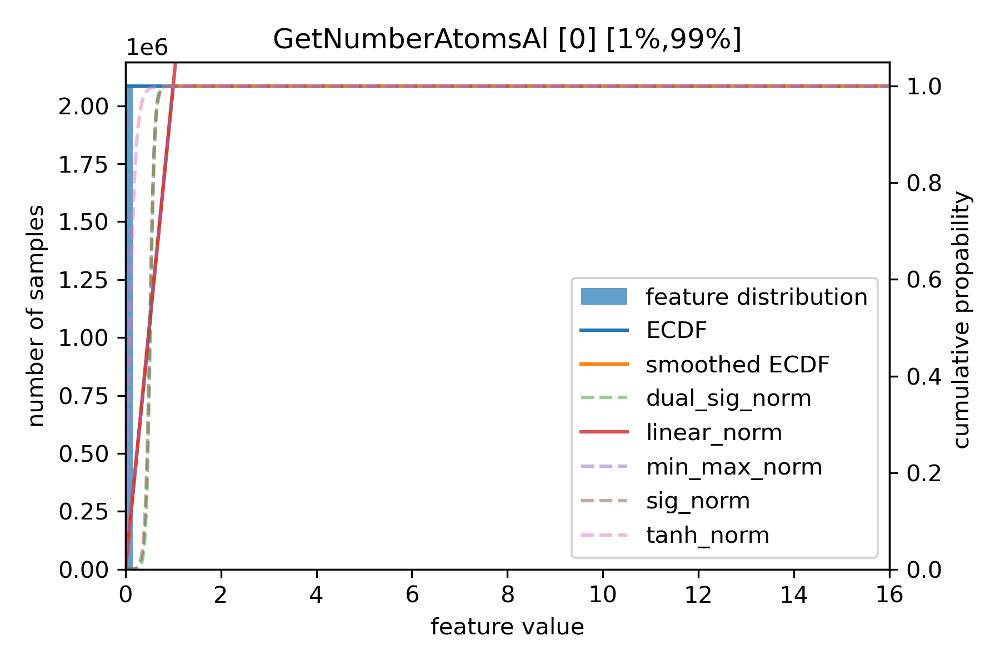

subfeats 0 missing
GetNumberAtomsAm_Featurizer
cannot create ecdf for GetNumberAtomsAm_Featurizer_0
subfeats 0 missing
GetNumberAtomsAr_Featurizer
cannot create ecdf for GetNumberAtomsAr_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsAs_Featurizer
2 2
3 3
fit GetNumberAtomsAs_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


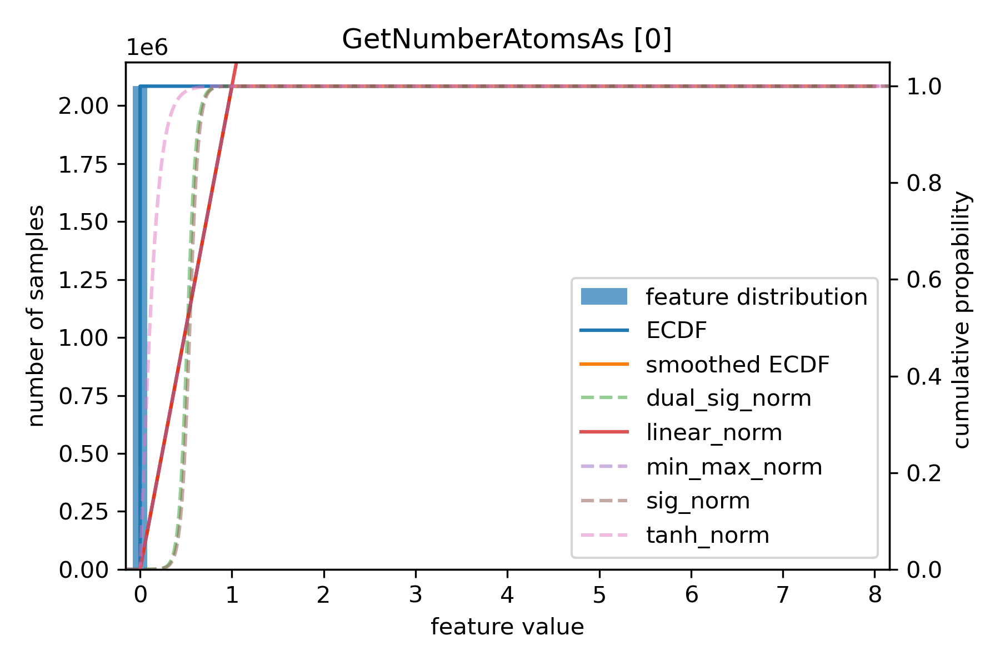

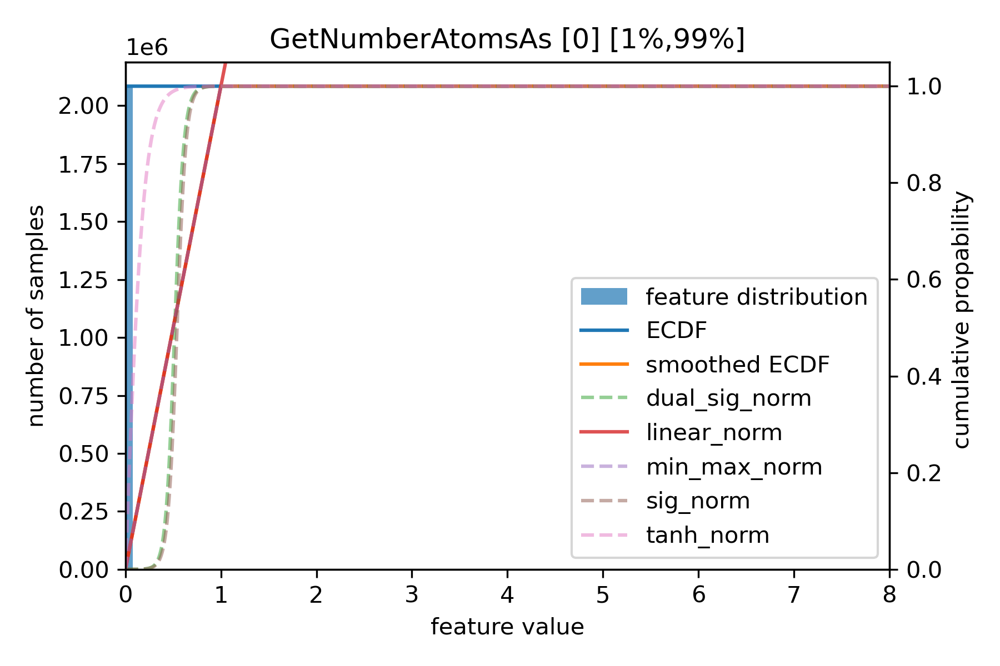

subfeats 0 missing
GetNumberAtomsAt_Featurizer
cannot create ecdf for GetNumberAtomsAt_Featurizer_0
subfeats 0 missing
GetNumberAtomsAu_Featurizer
cannot create ecdf for GetNumberAtomsAu_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsB_Featurizer
2 2
3 3
fit GetNumberAtomsB_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


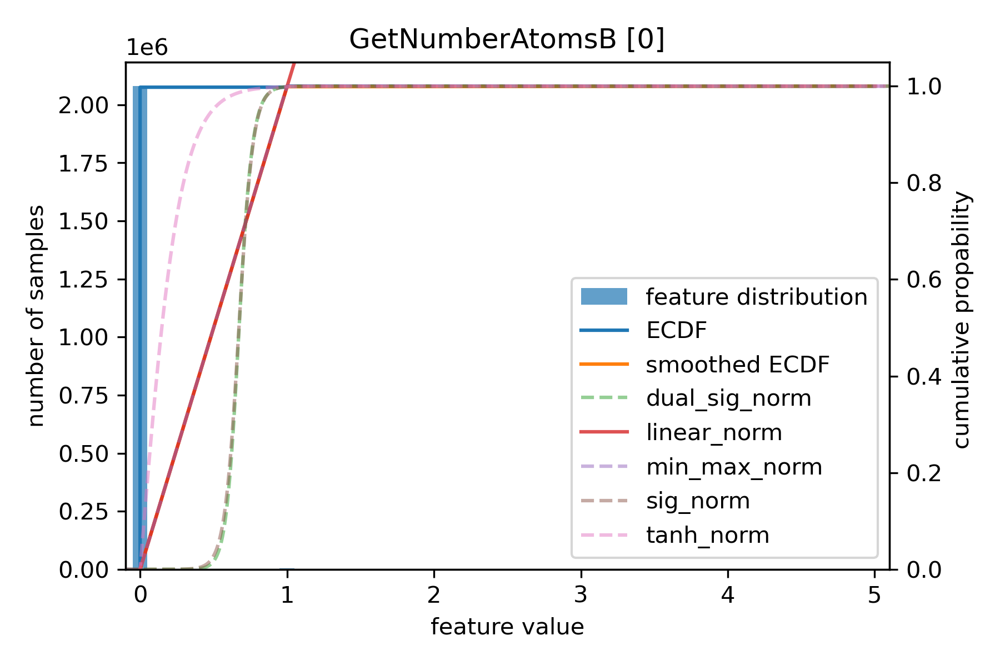

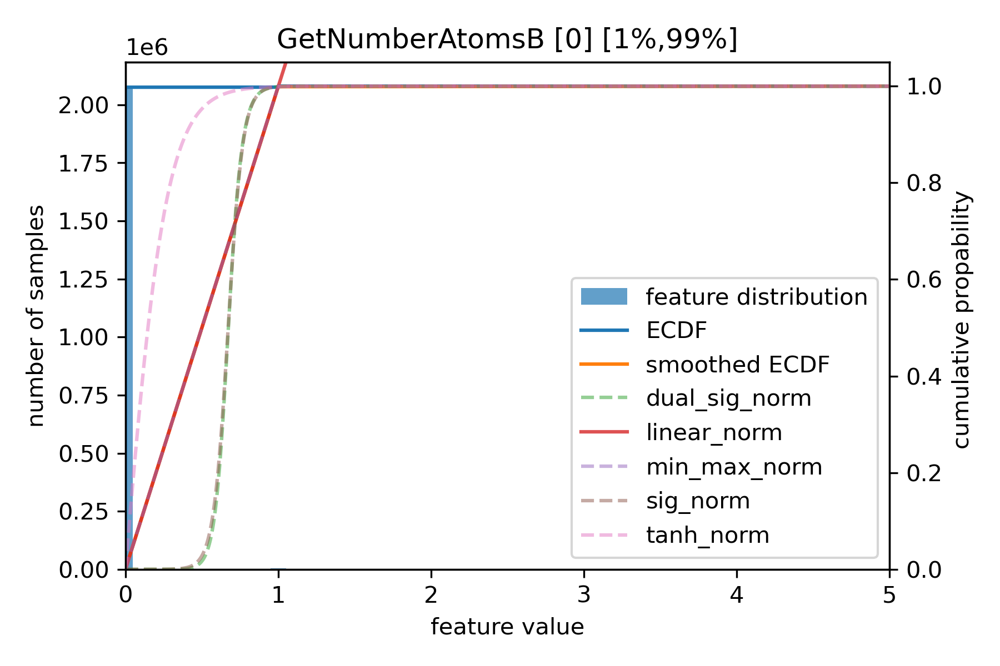

fits 0 dual_sig_norm missing
GetNumberAtomsBa_Featurizer
1 1
1 1
fit GetNumberAtomsBa_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBa_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBa_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBa_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBa_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBa_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99


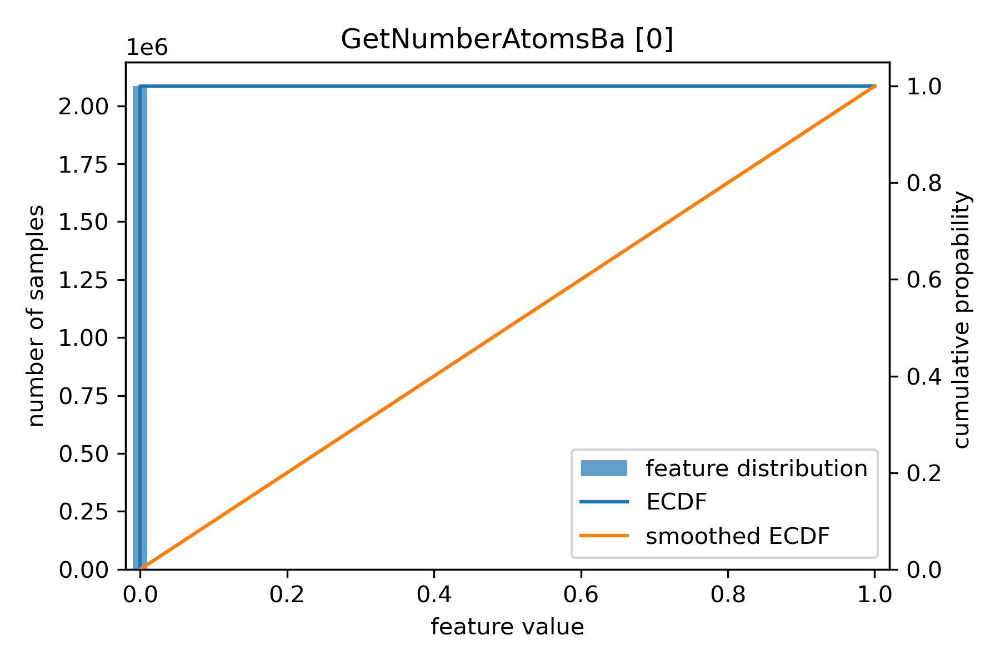

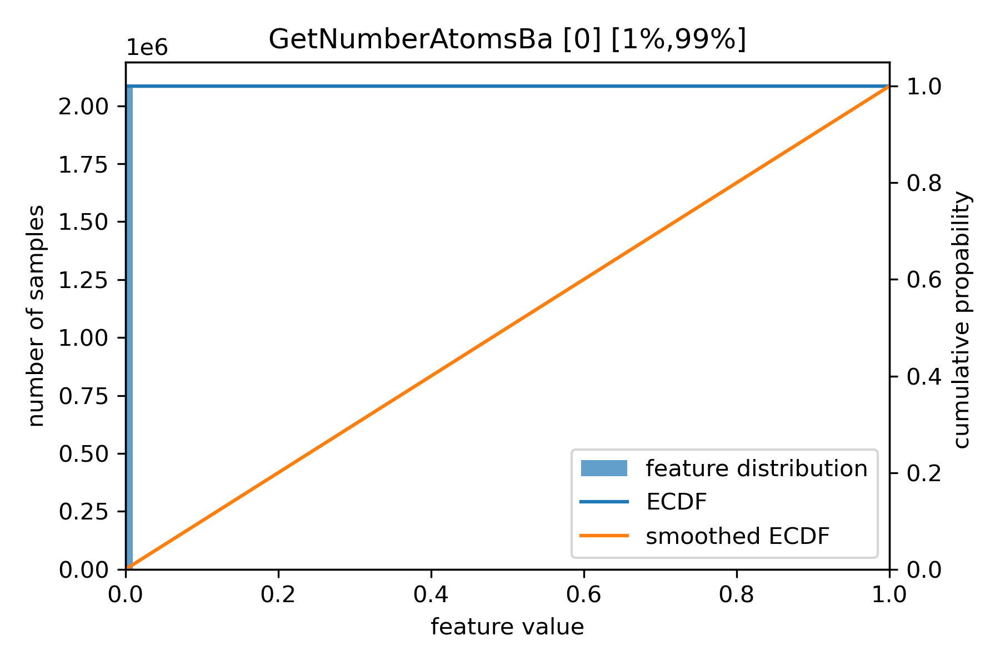

fits 0 dual_sig_norm missing
GetNumberAtomsBe_Featurizer
1 1
1 1
fit GetNumberAtomsBe_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBe_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBe_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBe_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBe_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBe_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99


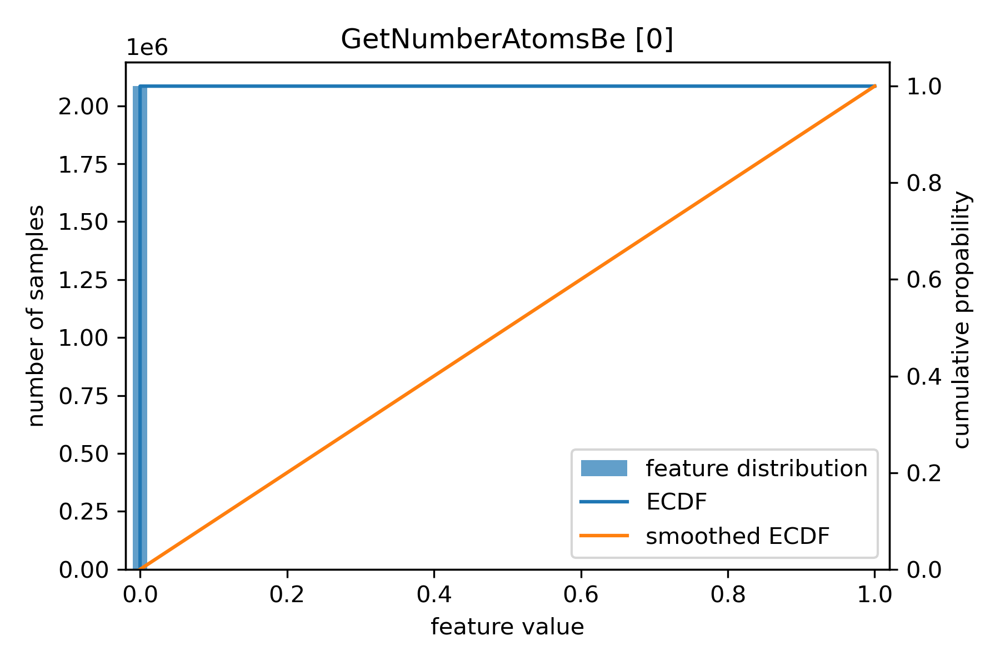

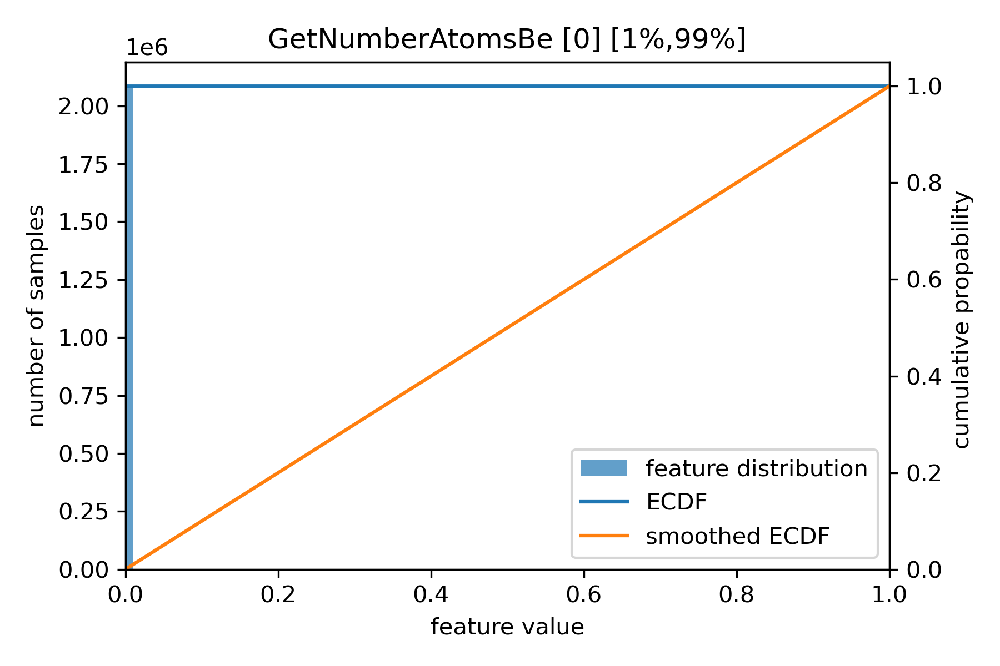

subfeats 0 missing
GetNumberAtomsBh_Featurizer
cannot create ecdf for GetNumberAtomsBh_Featurizer_0
fits 0 dual_sig_norm missing
GetNumberAtomsBi_Featurizer
1 1
1 1
fit GetNumberAtomsBi_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBi_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBi_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBi_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBi_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetNumberAtomsBi_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99


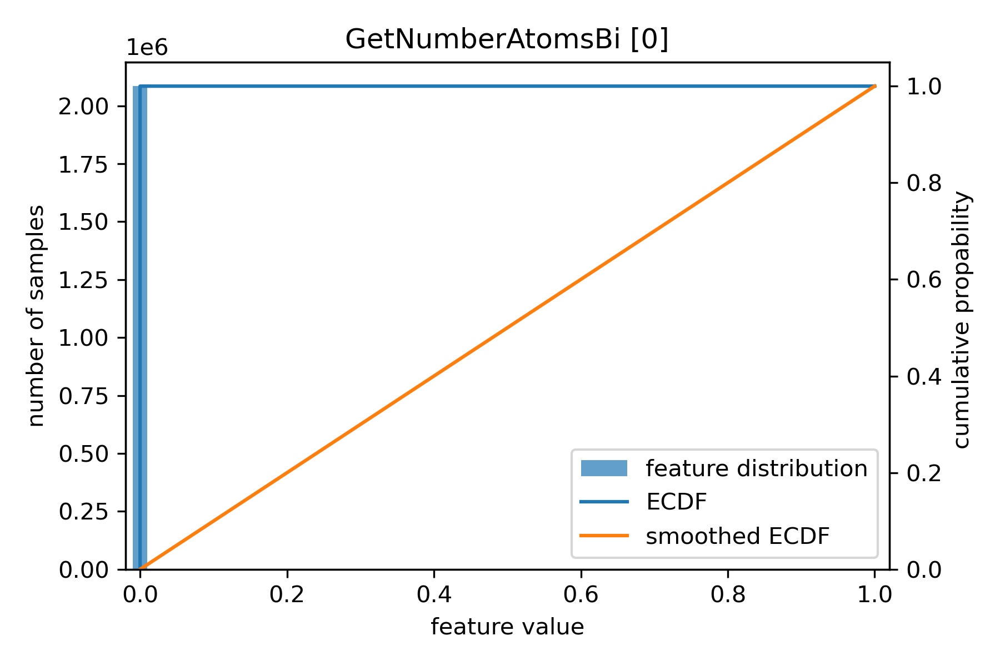

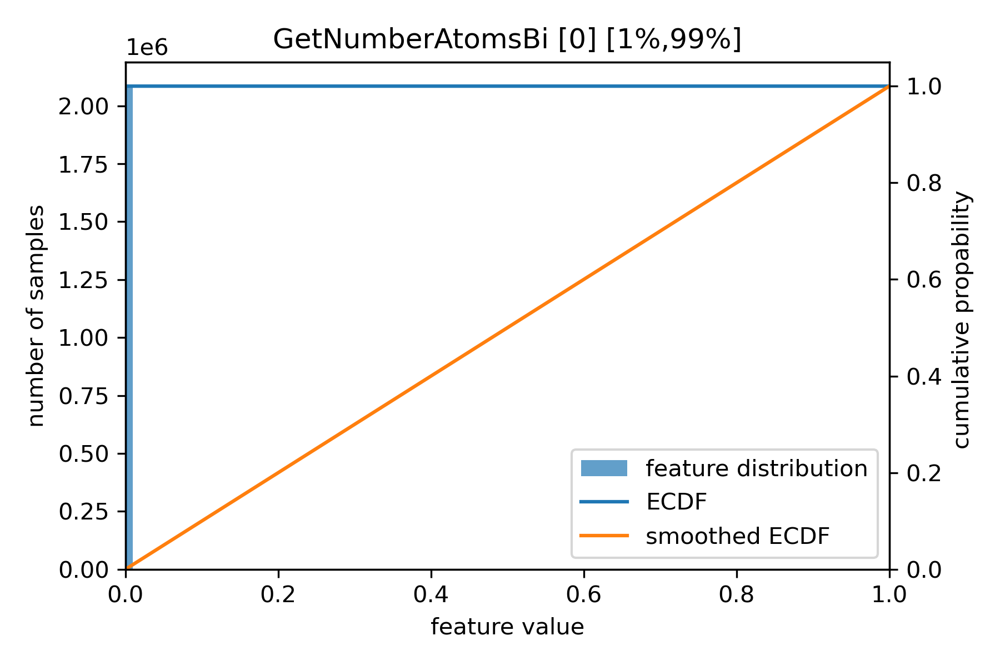

subfeats 0 missing
GetNumberAtomsBk_Featurizer
cannot create ecdf for GetNumberAtomsBk_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsCa_Featurizer
2 2
3 3
fit GetNumberAtomsCa_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


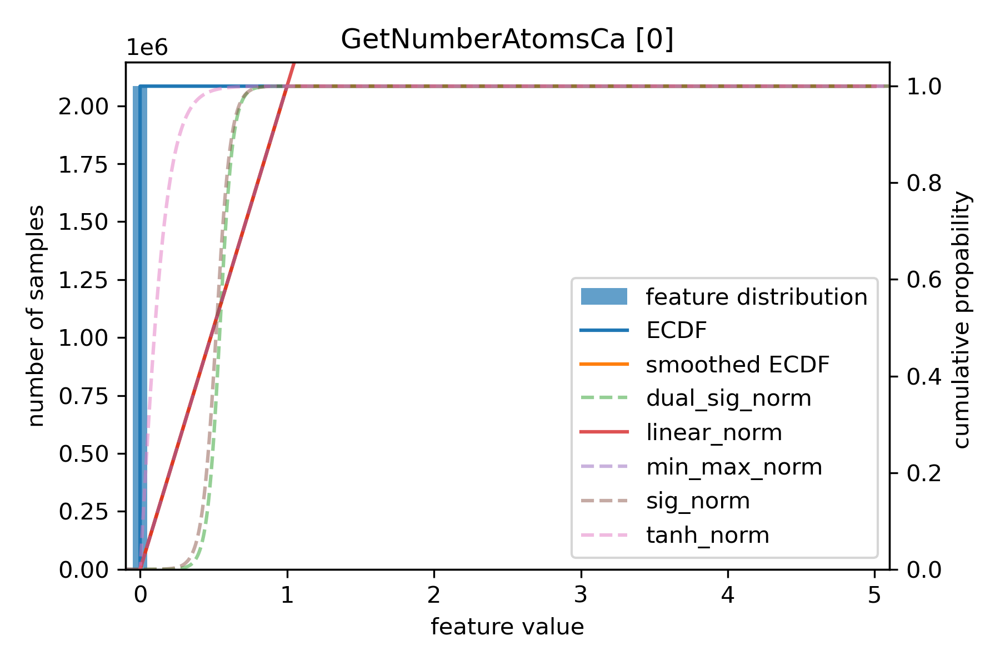

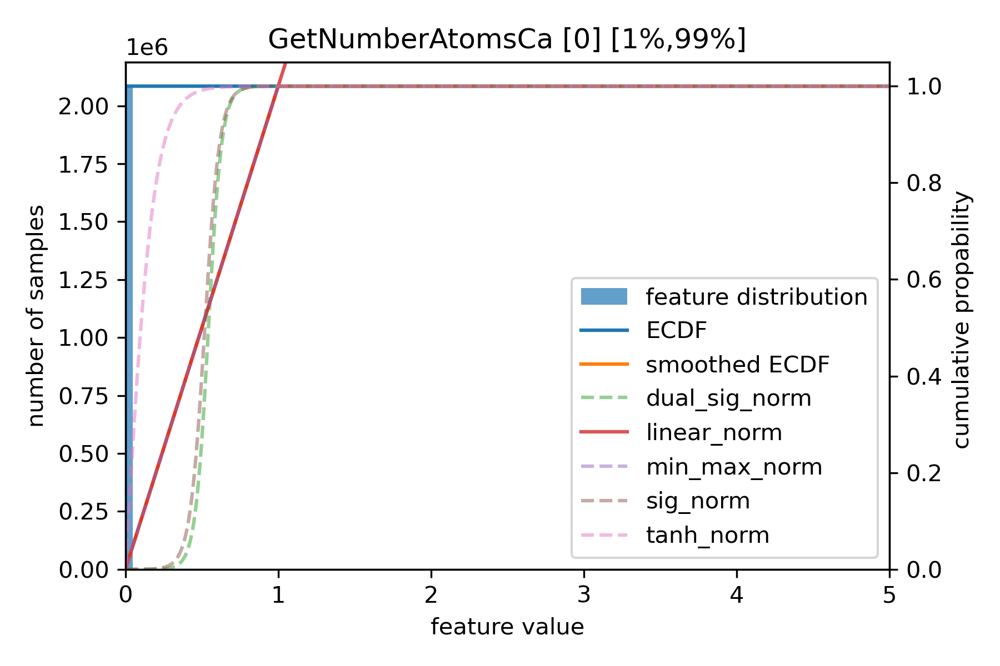

subfeats 0 missing
GetNumberAtomsCd_Featurizer
cannot create ecdf for GetNumberAtomsCd_Featurizer_0
subfeats 0 missing
GetNumberAtomsCe_Featurizer
cannot create ecdf for GetNumberAtomsCe_Featurizer_0
subfeats 0 missing
GetNumberAtomsCf_Featurizer
cannot create ecdf for GetNumberAtomsCf_Featurizer_0
subfeats 0 missing
GetNumberAtomsCm_Featurizer
cannot create ecdf for GetNumberAtomsCm_Featurizer_0
subfeats 0 missing
GetNumberAtomsCn_Featurizer
cannot create ecdf for GetNumberAtomsCn_Featurizer_0
subfeats 0 missing
GetNumberAtomsCo_Featurizer
cannot create ecdf for GetNumberAtomsCo_Featurizer_0
subfeats 0 missing
GetNumberAtomsCr_Featurizer
cannot create ecdf for GetNumberAtomsCr_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsCs_Featurizer
2 2
3 3
fit GetNumberAtomsCs_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


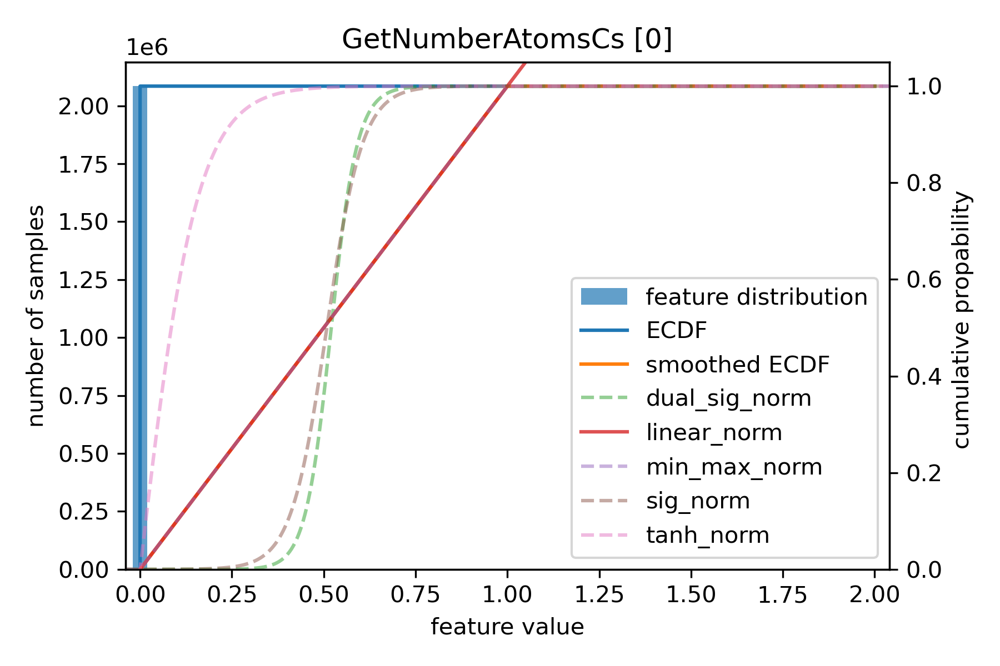

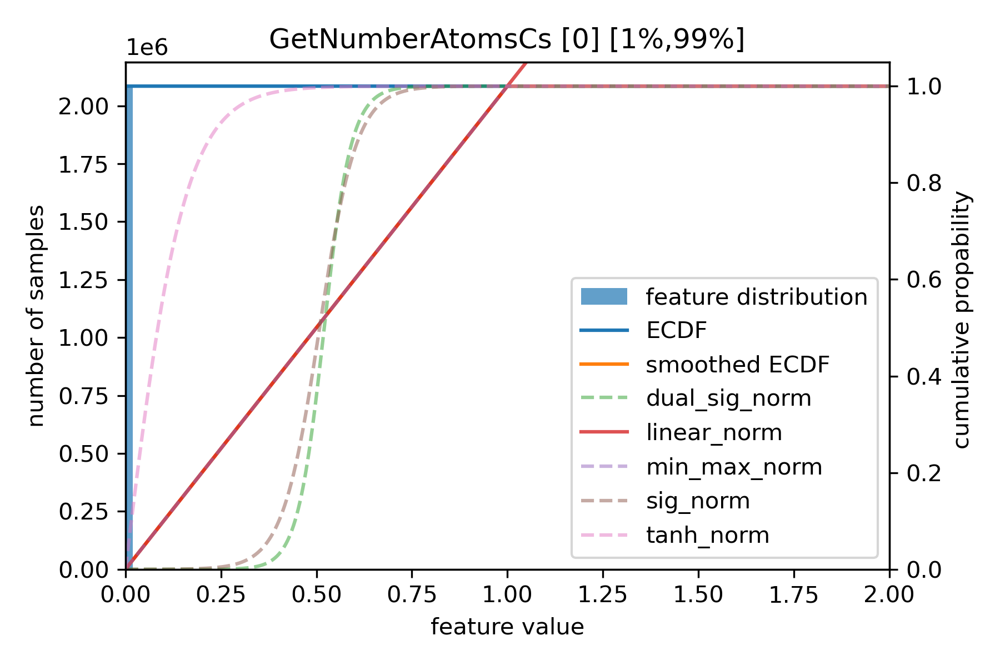

subfeats 0 missing
GetNumberAtomsCu_Featurizer
cannot create ecdf for GetNumberAtomsCu_Featurizer_0
subfeats 0 missing
GetNumberAtomsDb_Featurizer
cannot create ecdf for GetNumberAtomsDb_Featurizer_0
subfeats 0 missing
GetNumberAtomsDs_Featurizer
cannot create ecdf for GetNumberAtomsDs_Featurizer_0
subfeats 0 missing
GetNumberAtomsDy_Featurizer
cannot create ecdf for GetNumberAtomsDy_Featurizer_0
subfeats 0 missing
GetNumberAtomsEr_Featurizer
cannot create ecdf for GetNumberAtomsEr_Featurizer_0
subfeats 0 missing
GetNumberAtomsEs_Featurizer
cannot create ecdf for GetNumberAtomsEs_Featurizer_0
subfeats 0 missing
GetNumberAtomsEu_Featurizer
cannot create ecdf for GetNumberAtomsEu_Featurizer_0
subfeats 0 missing
GetNumberAtomsFe_Featurizer
cannot create ecdf for GetNumberAtomsFe_Featurizer_0
subfeats 0 missing
GetNumberAtomsFl_Featurizer
cannot create ecdf for GetNumberAtomsFl_Featurizer_0
subfeats 0 missing
GetNumberAtomsFm_Featurizer
cannot create ecdf for GetNumberAtomsFm_Featurizer_0


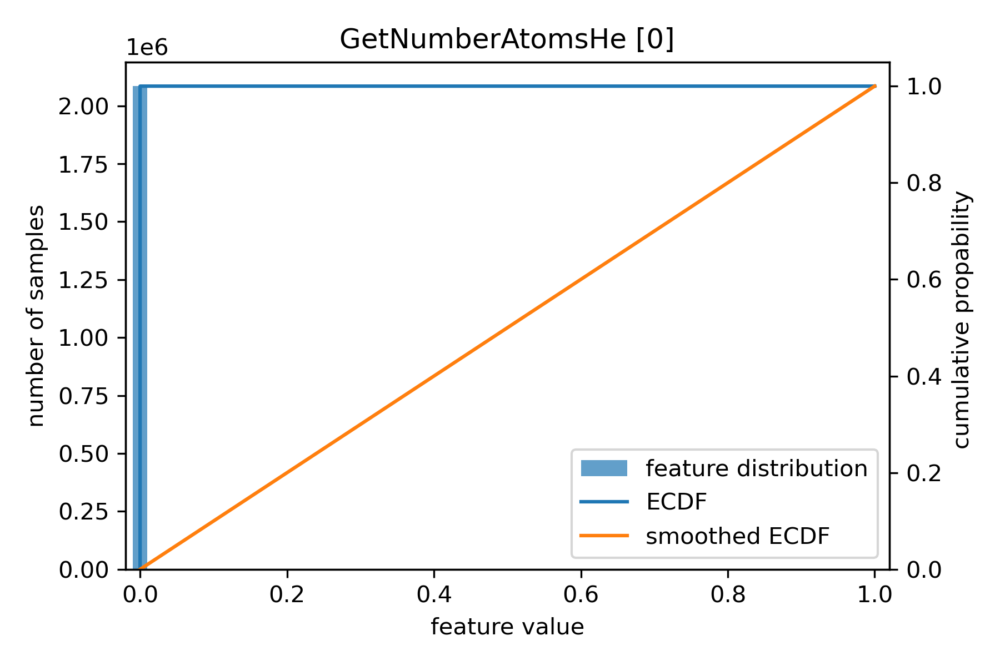

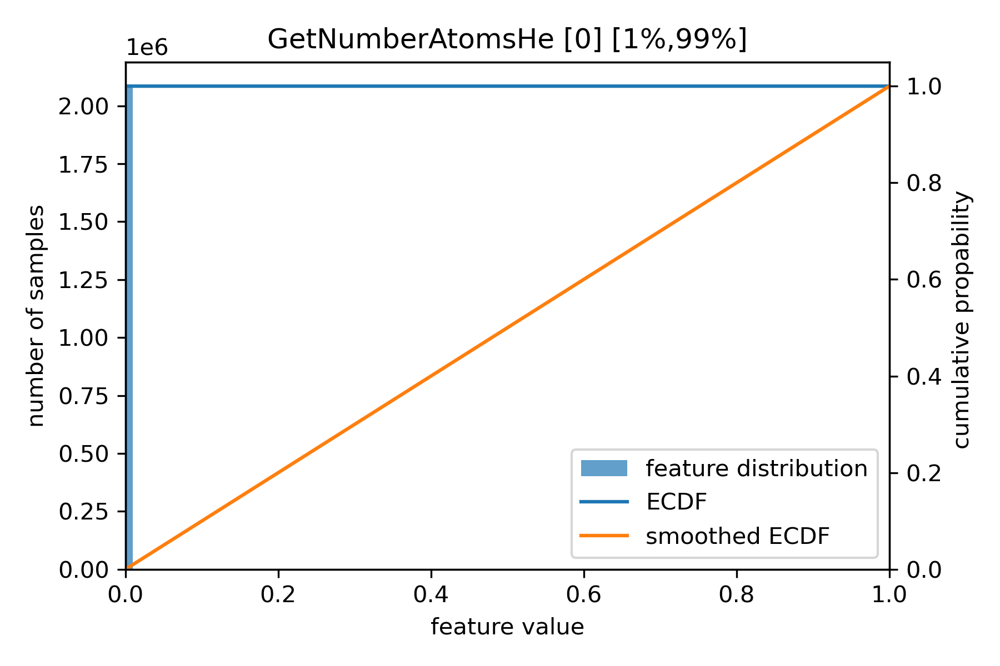

subfeats 0 missing
GetNumberAtomsHf_Featurizer
cannot create ecdf for GetNumberAtomsHf_Featurizer_0
subfeats 0 missing
GetNumberAtomsHg_Featurizer
cannot create ecdf for GetNumberAtomsHg_Featurizer_0
subfeats 0 missing
GetNumberAtomsHo_Featurizer
cannot create ecdf for GetNumberAtomsHo_Featurizer_0
subfeats 0 missing
GetNumberAtomsHs_Featurizer
cannot create ecdf for GetNumberAtomsHs_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsI_Featurizer
2 2
3 3
fit GetNumberAtomsI_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


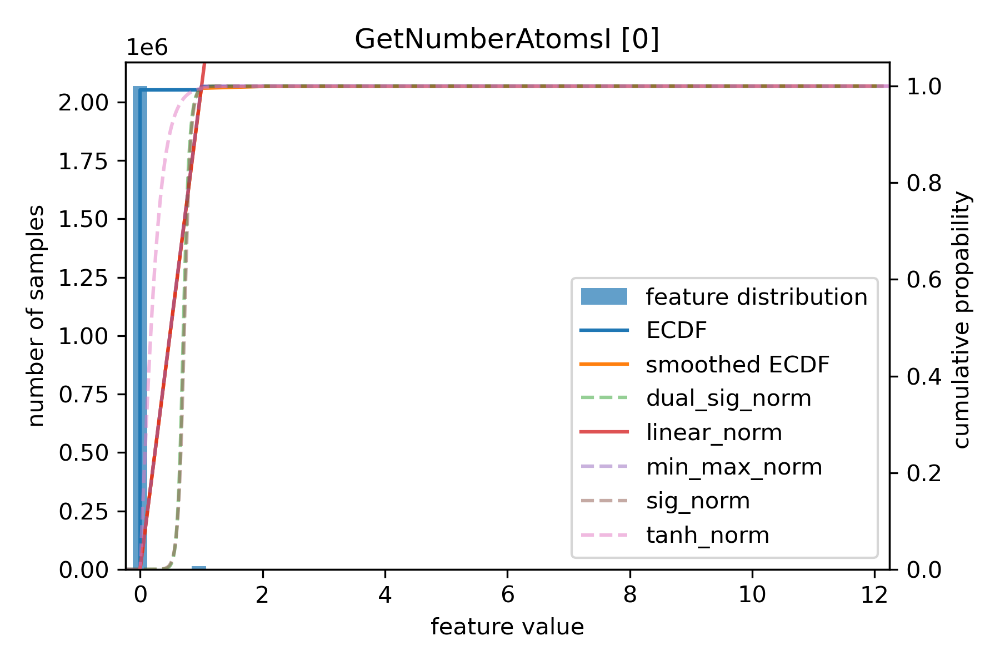

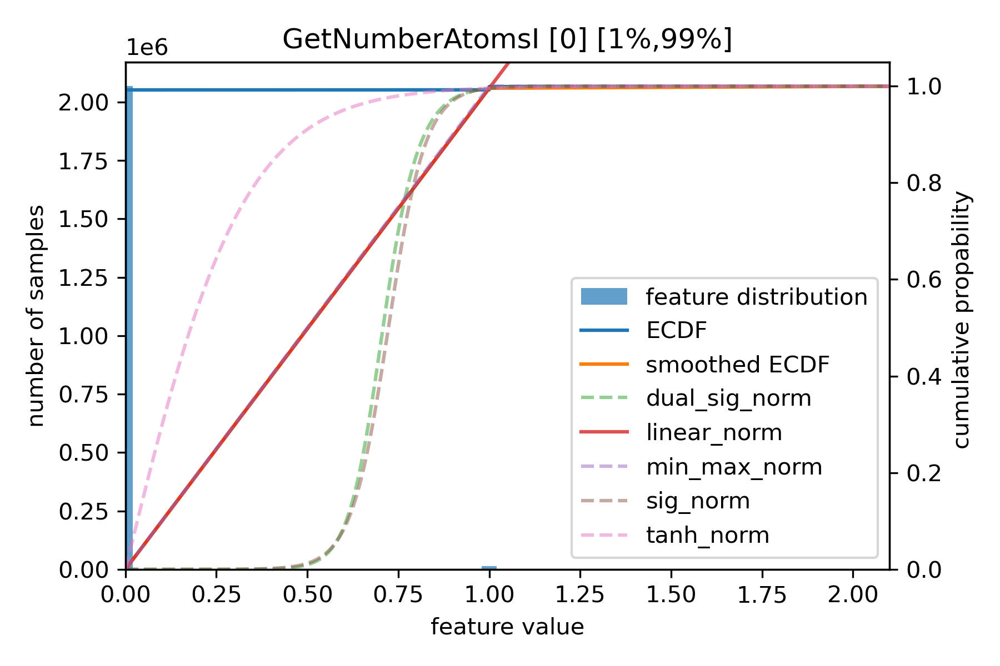

subfeats 0 missing
GetNumberAtomsIn_Featurizer
cannot create ecdf for GetNumberAtomsIn_Featurizer_0
subfeats 0 missing
GetNumberAtomsIr_Featurizer
cannot create ecdf for GetNumberAtomsIr_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsK_Featurizer
2 2
3 3
fit GetNumberAtomsK_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


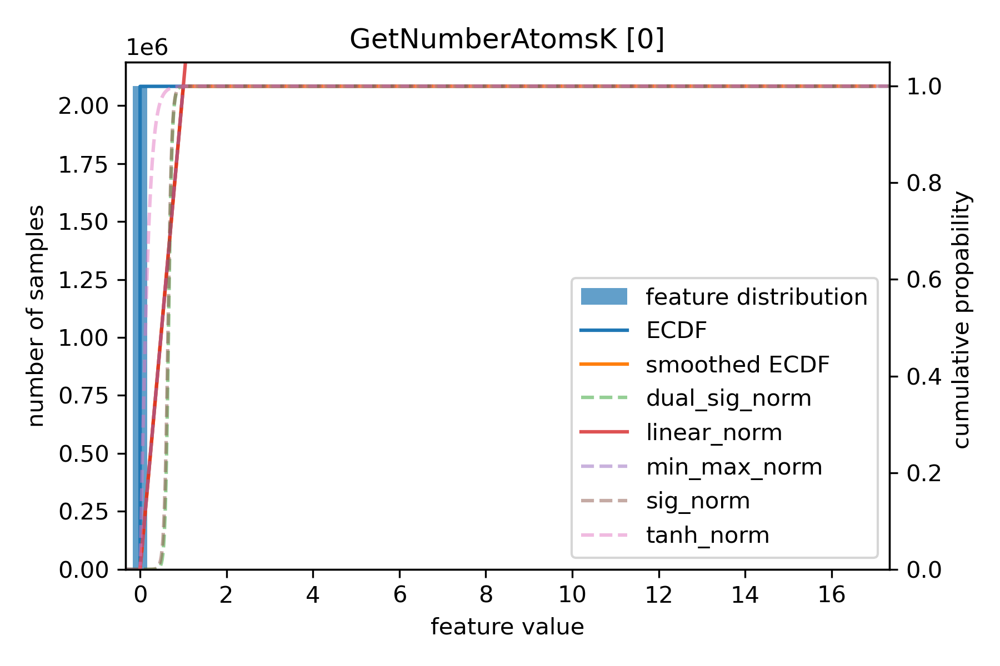

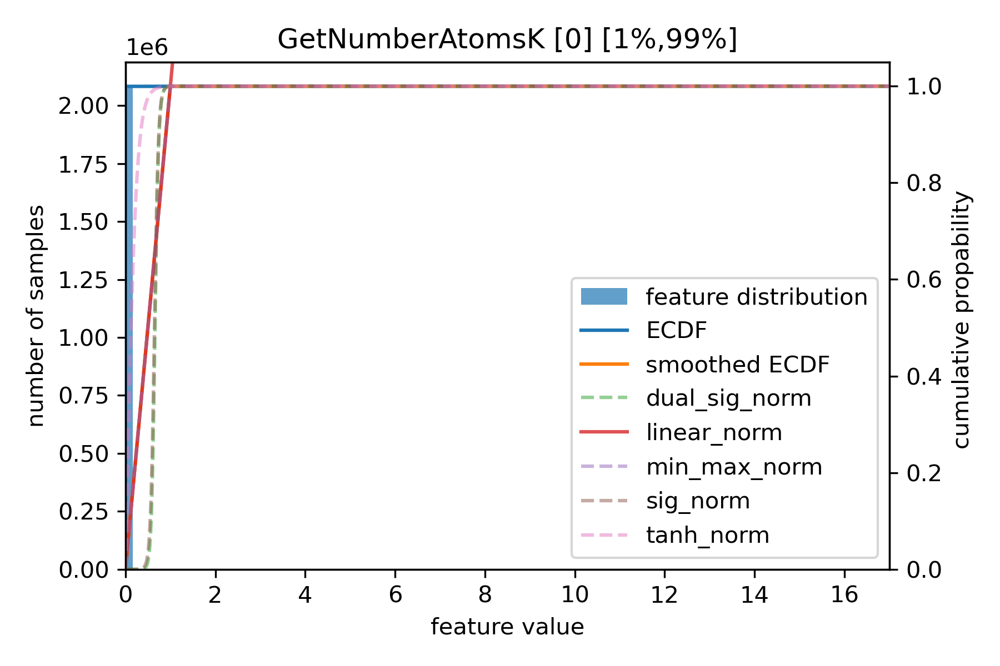

fits 0 dual_sig_norm missing
GetNumberAtomsKr_Featurizer
1 1
1 1
fit GetNumberAtomsKr_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetNumberAtomsKr_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetNumberAtomsKr_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetNumberAtomsKr_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetNumberAtomsKr_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetNumberAtomsKr_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99


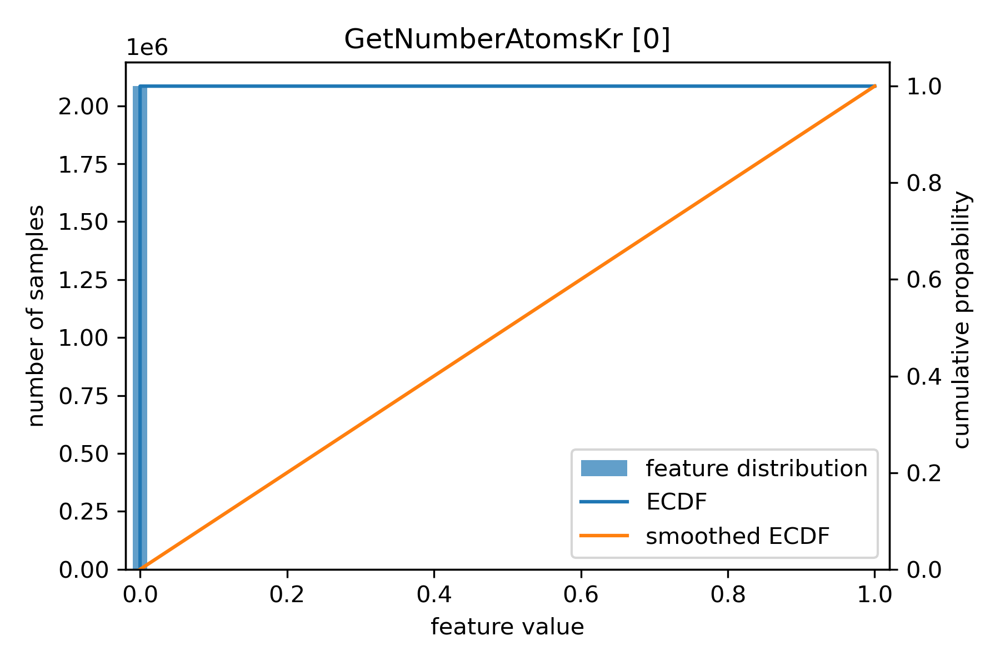

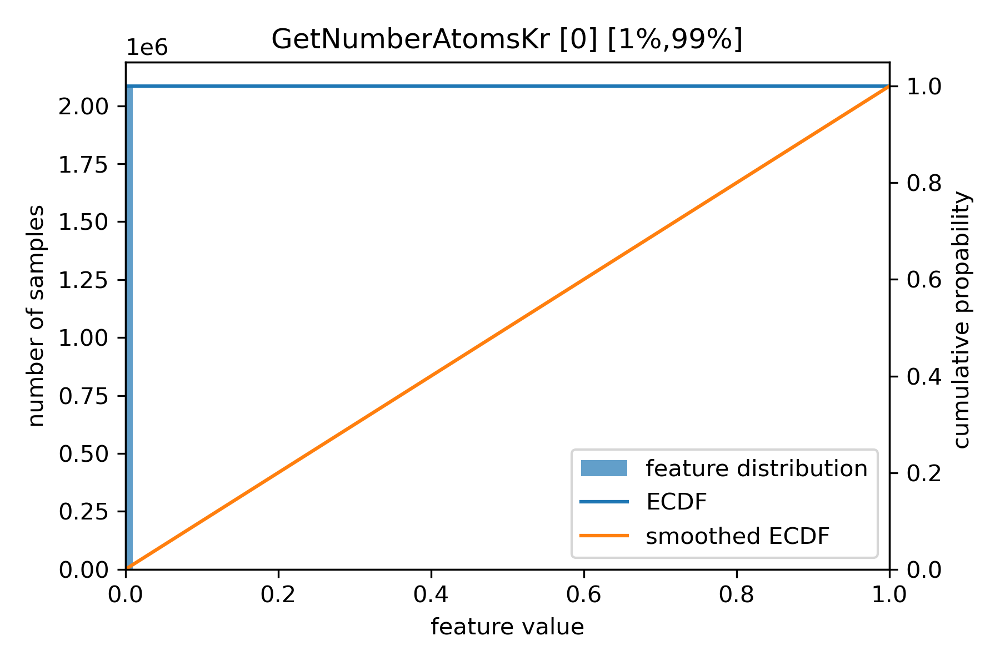

subfeats 0 missing
GetNumberAtomsLa_Featurizer
cannot create ecdf for GetNumberAtomsLa_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsLi_Featurizer
2 2
3 3
fit GetNumberAtomsLi_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


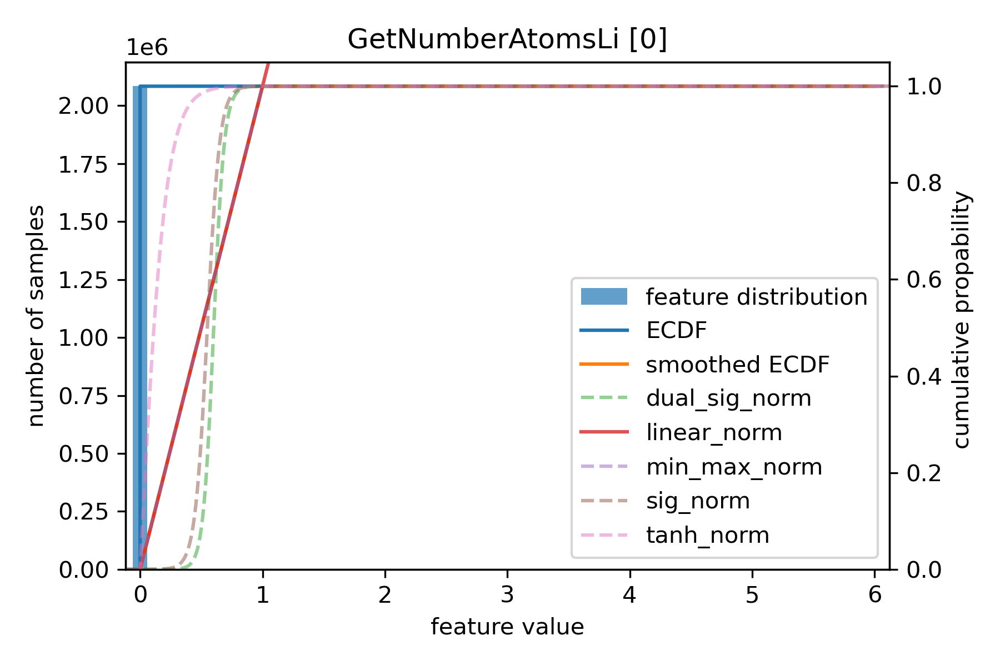

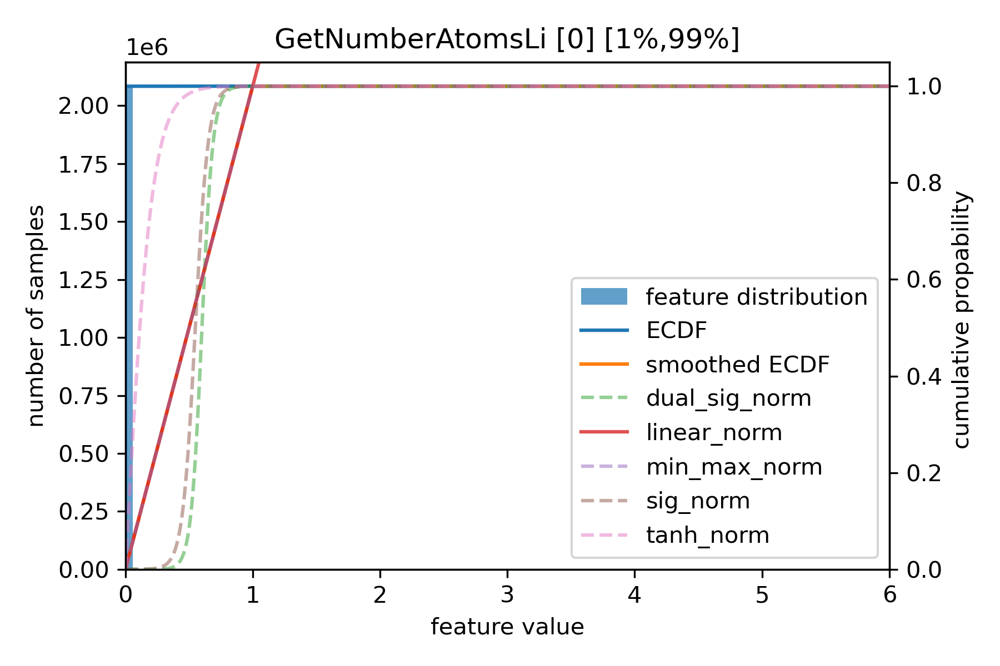

subfeats 0 missing
GetNumberAtomsLr_Featurizer
cannot create ecdf for GetNumberAtomsLr_Featurizer_0
subfeats 0 missing
GetNumberAtomsLu_Featurizer
cannot create ecdf for GetNumberAtomsLu_Featurizer_0
subfeats 0 missing
GetNumberAtomsLv_Featurizer
cannot create ecdf for GetNumberAtomsLv_Featurizer_0
subfeats 0 missing
GetNumberAtomsMc_Featurizer
cannot create ecdf for GetNumberAtomsMc_Featurizer_0
subfeats 0 missing
GetNumberAtomsMd_Featurizer
cannot create ecdf for GetNumberAtomsMd_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsMg_Featurizer
2 2
3 3
fit GetNumberAtomsMg_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


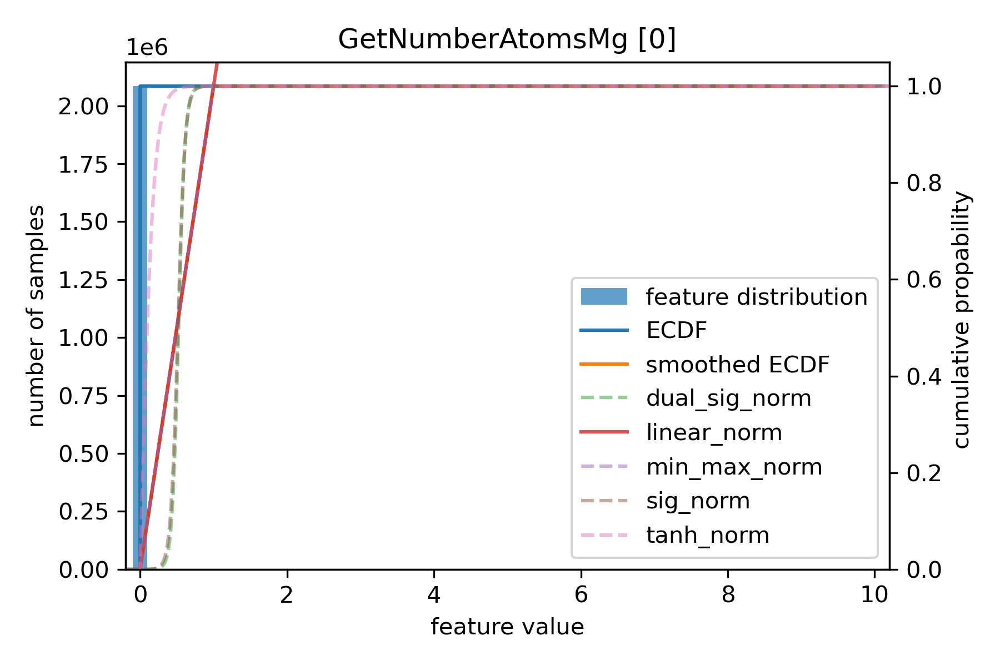

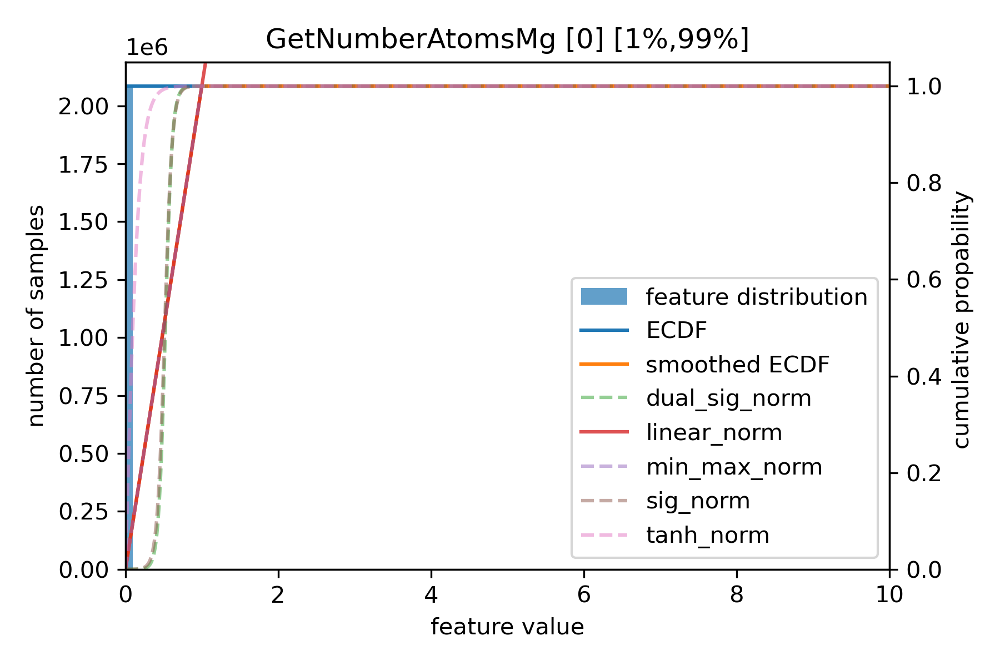

subfeats 0 missing
GetNumberAtomsMn_Featurizer
cannot create ecdf for GetNumberAtomsMn_Featurizer_0
subfeats 0 missing
GetNumberAtomsMo_Featurizer
cannot create ecdf for GetNumberAtomsMo_Featurizer_0
subfeats 0 missing
GetNumberAtomsMt_Featurizer
cannot create ecdf for GetNumberAtomsMt_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsNa_Featurizer
2 2
3 3
fit GetNumberAtomsNa_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


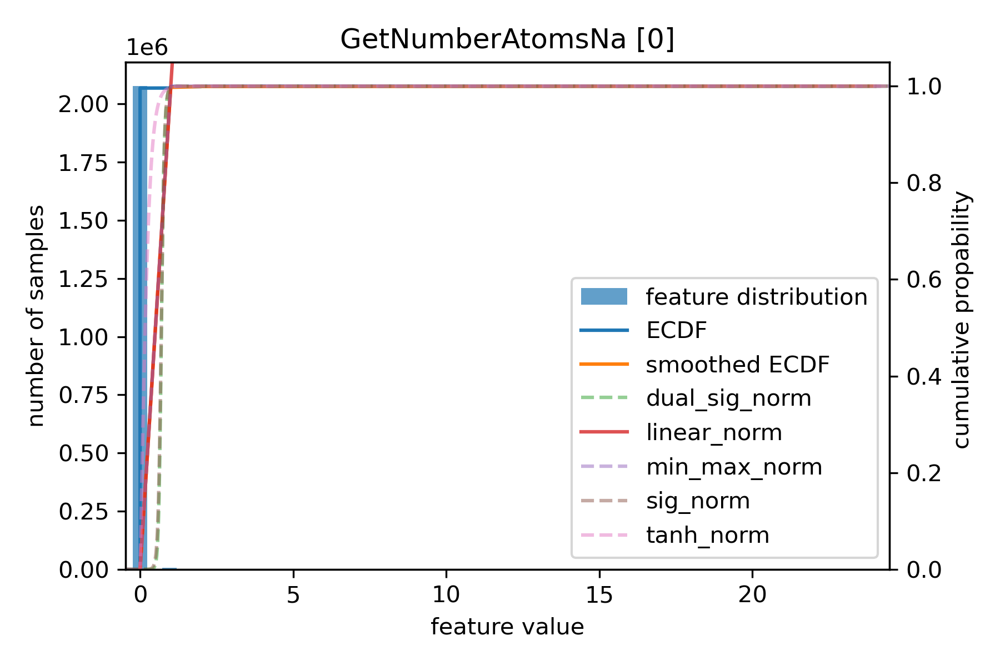

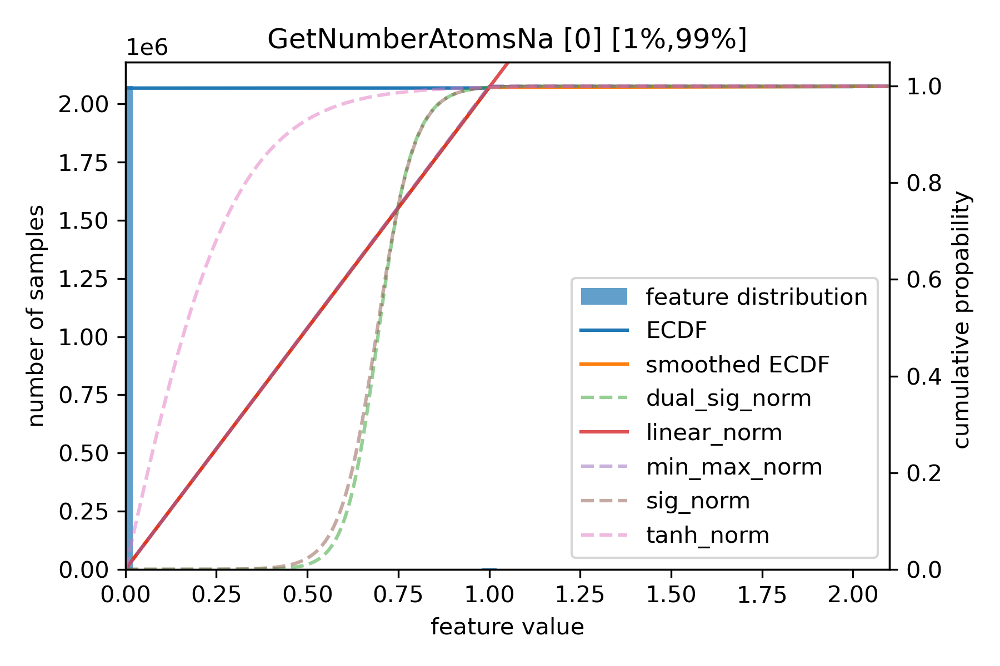

subfeats 0 missing
GetNumberAtomsNb_Featurizer
cannot create ecdf for GetNumberAtomsNb_Featurizer_0
subfeats 0 missing
GetNumberAtomsNd_Featurizer
cannot create ecdf for GetNumberAtomsNd_Featurizer_0
subfeats 0 missing
GetNumberAtomsNe_Featurizer
cannot create ecdf for GetNumberAtomsNe_Featurizer_0
subfeats 0 missing
GetNumberAtomsNh_Featurizer
cannot create ecdf for GetNumberAtomsNh_Featurizer_0
subfeats 0 missing
GetNumberAtomsNi_Featurizer
cannot create ecdf for GetNumberAtomsNi_Featurizer_0
subfeats 0 missing
GetNumberAtomsNo_Featurizer
cannot create ecdf for GetNumberAtomsNo_Featurizer_0
subfeats 0 missing
GetNumberAtomsNp_Featurizer
cannot create ecdf for GetNumberAtomsNp_Featurizer_0
subfeats 0 missing
GetNumberAtomsOg_Featurizer
cannot create ecdf for GetNumberAtomsOg_Featurizer_0
subfeats 0 missing
GetNumberAtomsOs_Featurizer
cannot create ecdf for GetNumberAtomsOs_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsP_Featurizer
2 2
3 3
fit GetNumberAtomsP_Featurizer_0 with 

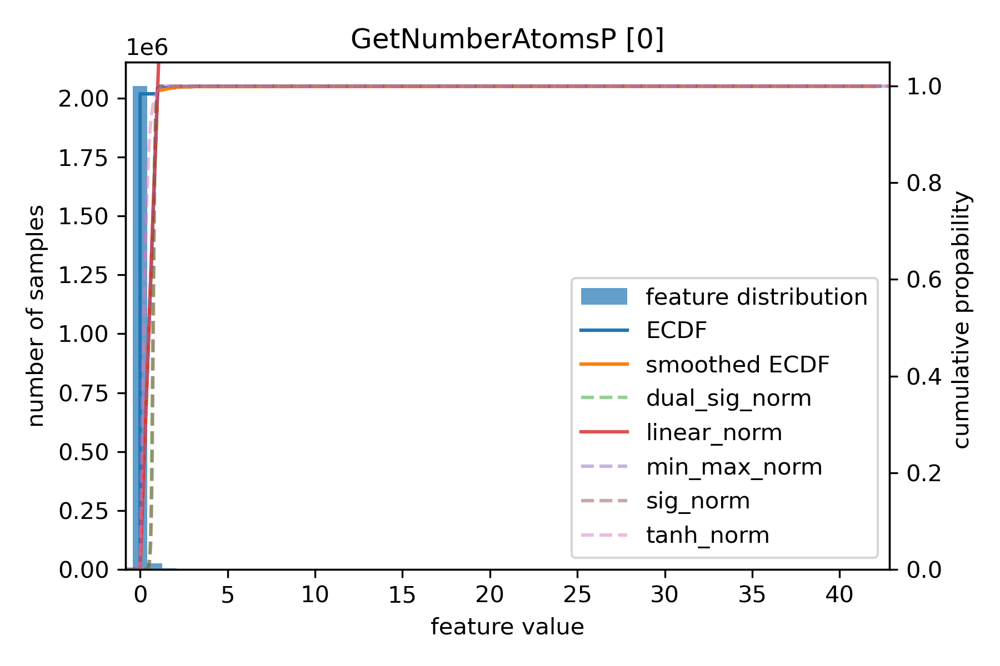

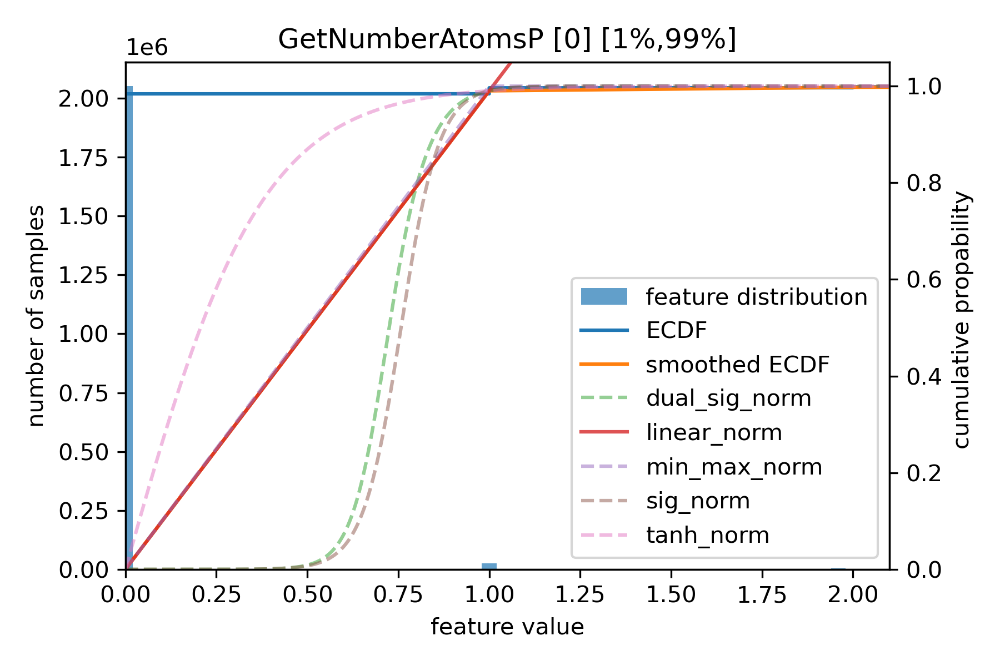

subfeats 0 missing
GetNumberAtomsPa_Featurizer
cannot create ecdf for GetNumberAtomsPa_Featurizer_0
subfeats 0 missing
GetNumberAtomsPb_Featurizer
cannot create ecdf for GetNumberAtomsPb_Featurizer_0
subfeats 0 missing
GetNumberAtomsPd_Featurizer
cannot create ecdf for GetNumberAtomsPd_Featurizer_0
subfeats 0 missing
GetNumberAtomsPm_Featurizer
cannot create ecdf for GetNumberAtomsPm_Featurizer_0
subfeats 0 missing
GetNumberAtomsPo_Featurizer
cannot create ecdf for GetNumberAtomsPo_Featurizer_0
subfeats 0 missing
GetNumberAtomsPr_Featurizer
cannot create ecdf for GetNumberAtomsPr_Featurizer_0
subfeats 0 missing
GetNumberAtomsPt_Featurizer
cannot create ecdf for GetNumberAtomsPt_Featurizer_0
subfeats 0 missing
GetNumberAtomsPu_Featurizer
cannot create ecdf for GetNumberAtomsPu_Featurizer_0
fits 0 dual_sig_norm missing
GetNumberAtomsRa_Featurizer
1 1
1 1
fit GetNumberAtomsRa_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetNumberAtomsRa_Featurizer_0 with genlog_norm usin

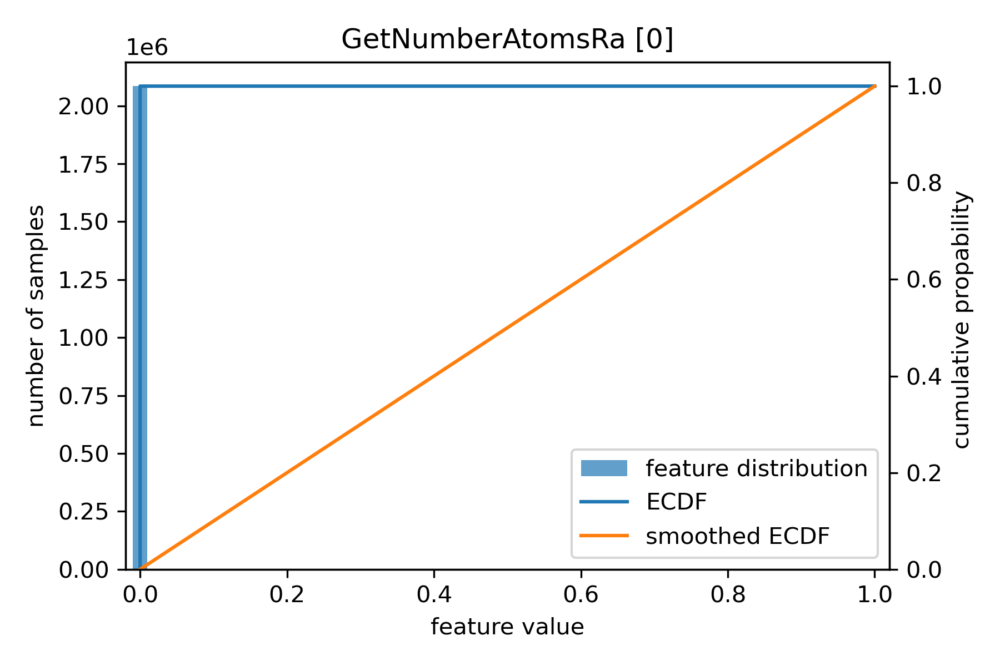

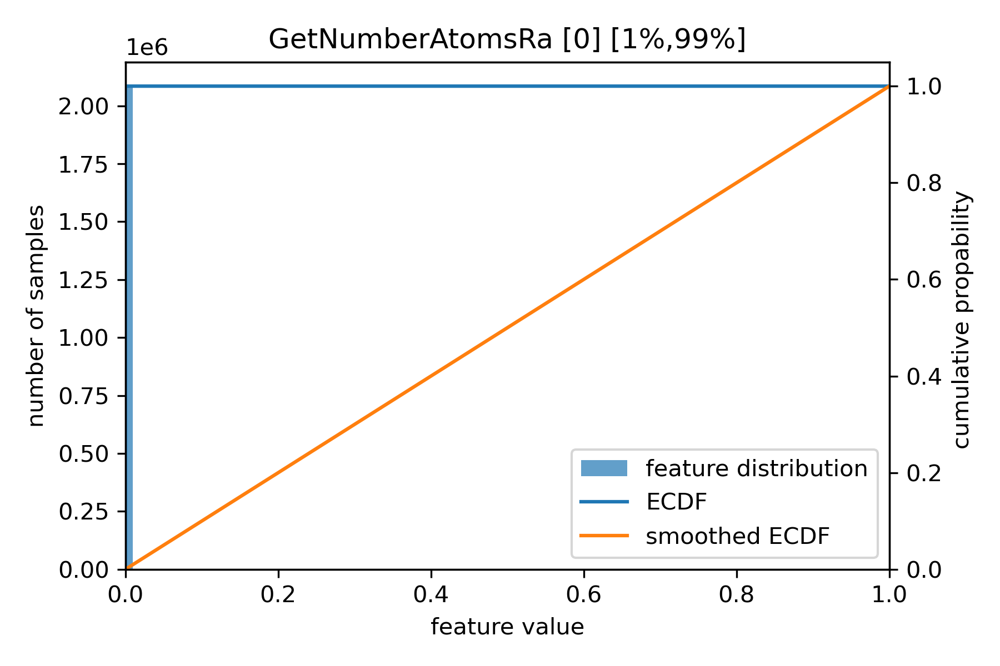

fits 0 genlog_norm missing
GetNumberAtomsRb_Featurizer
2 2
3 3
fit GetNumberAtomsRb_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


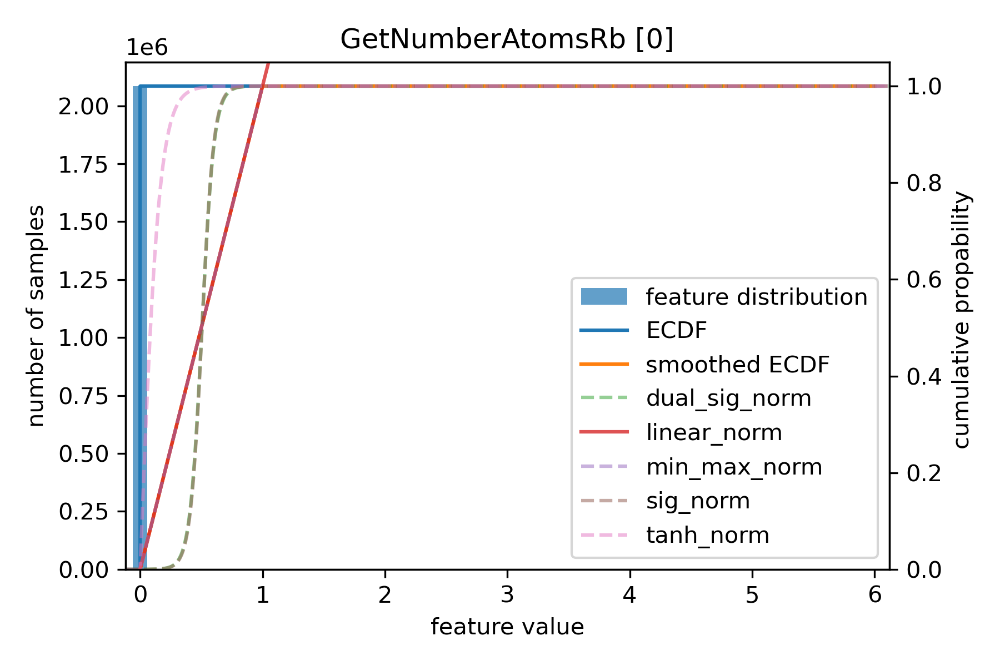

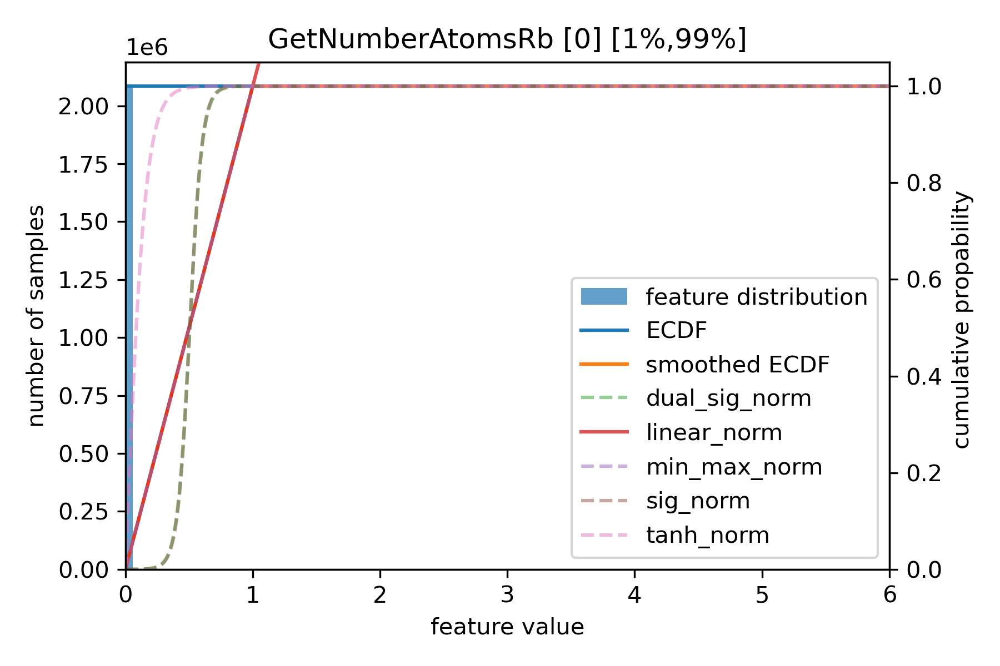

subfeats 0 missing
GetNumberAtomsRe_Featurizer
cannot create ecdf for GetNumberAtomsRe_Featurizer_0
subfeats 0 missing
GetNumberAtomsRf_Featurizer
cannot create ecdf for GetNumberAtomsRf_Featurizer_0
subfeats 0 missing
GetNumberAtomsRg_Featurizer
cannot create ecdf for GetNumberAtomsRg_Featurizer_0
subfeats 0 missing
GetNumberAtomsRh_Featurizer
cannot create ecdf for GetNumberAtomsRh_Featurizer_0
subfeats 0 missing
GetNumberAtomsRn_Featurizer
cannot create ecdf for GetNumberAtomsRn_Featurizer_0
subfeats 0 missing
GetNumberAtomsRu_Featurizer
cannot create ecdf for GetNumberAtomsRu_Featurizer_0
subfeats 0 missing
GetNumberAtomsSb_Featurizer
cannot create ecdf for GetNumberAtomsSb_Featurizer_0
subfeats 0 missing
GetNumberAtomsSc_Featurizer
cannot create ecdf for GetNumberAtomsSc_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsSe_Featurizer
2 2
3 3
fit GetNumberAtomsSe_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


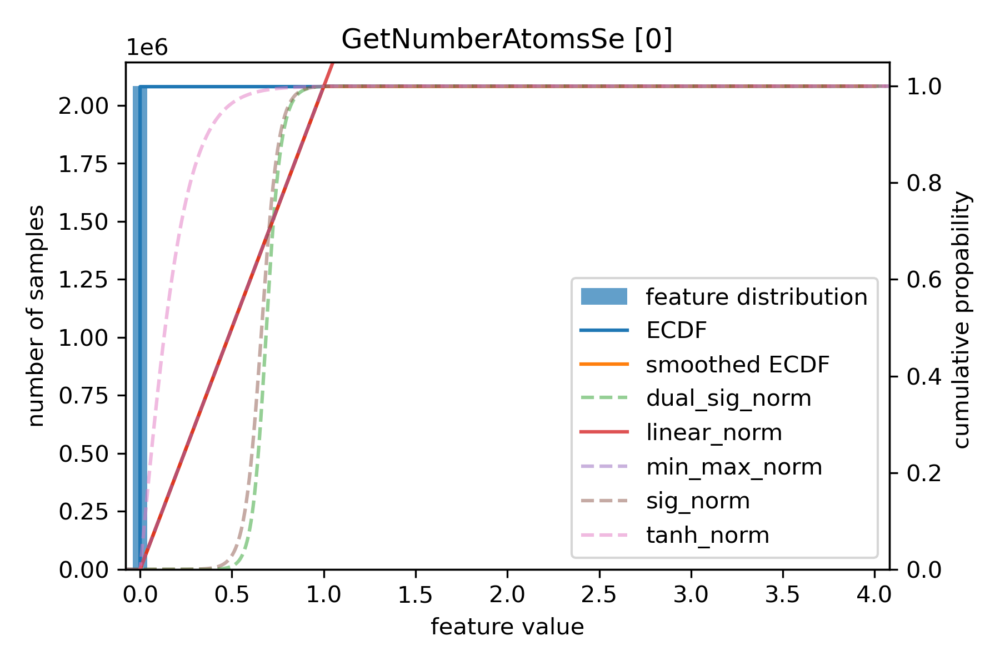

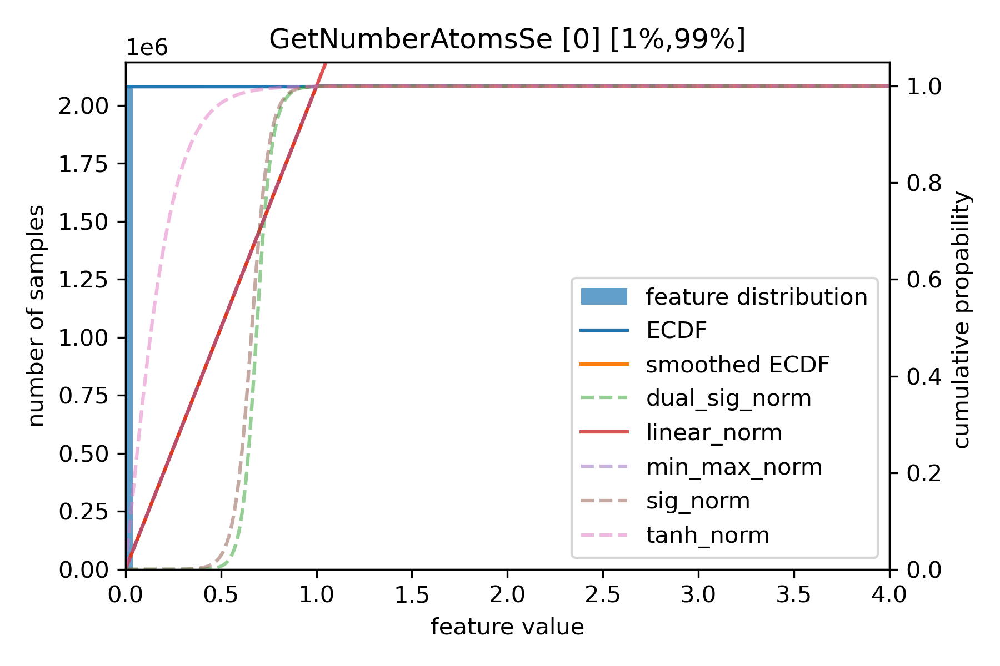

subfeats 0 missing
GetNumberAtomsSg_Featurizer
cannot create ecdf for GetNumberAtomsSg_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsSi_Featurizer
2 2
3 3
fit GetNumberAtomsSi_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


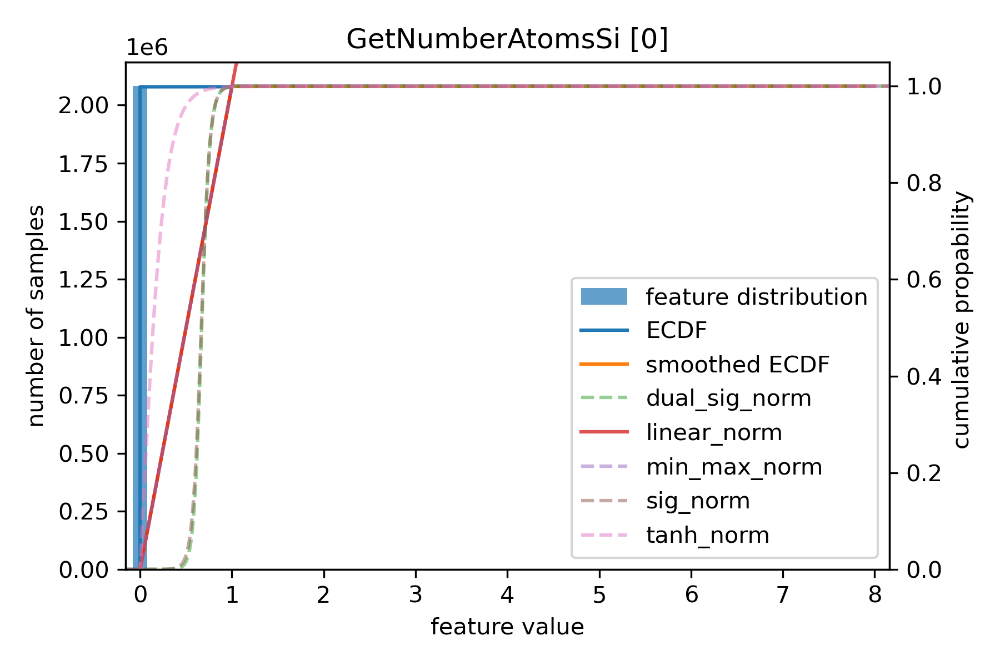

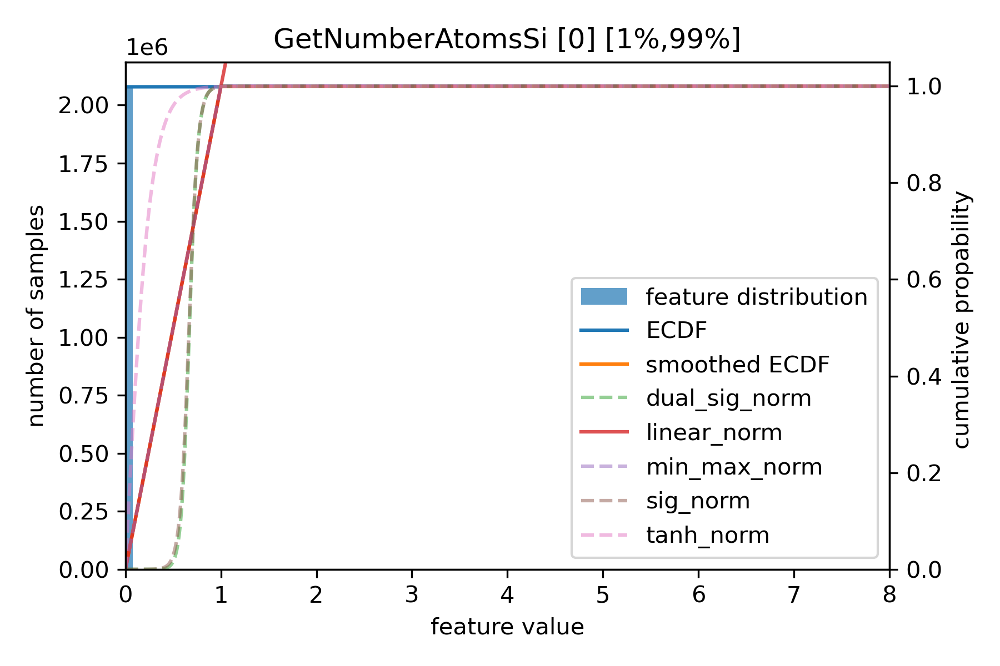

subfeats 0 missing
GetNumberAtomsSm_Featurizer
cannot create ecdf for GetNumberAtomsSm_Featurizer_0
subfeats 0 missing
GetNumberAtomsSn_Featurizer
cannot create ecdf for GetNumberAtomsSn_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsSr_Featurizer
2 2
3 3
fit GetNumberAtomsSr_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


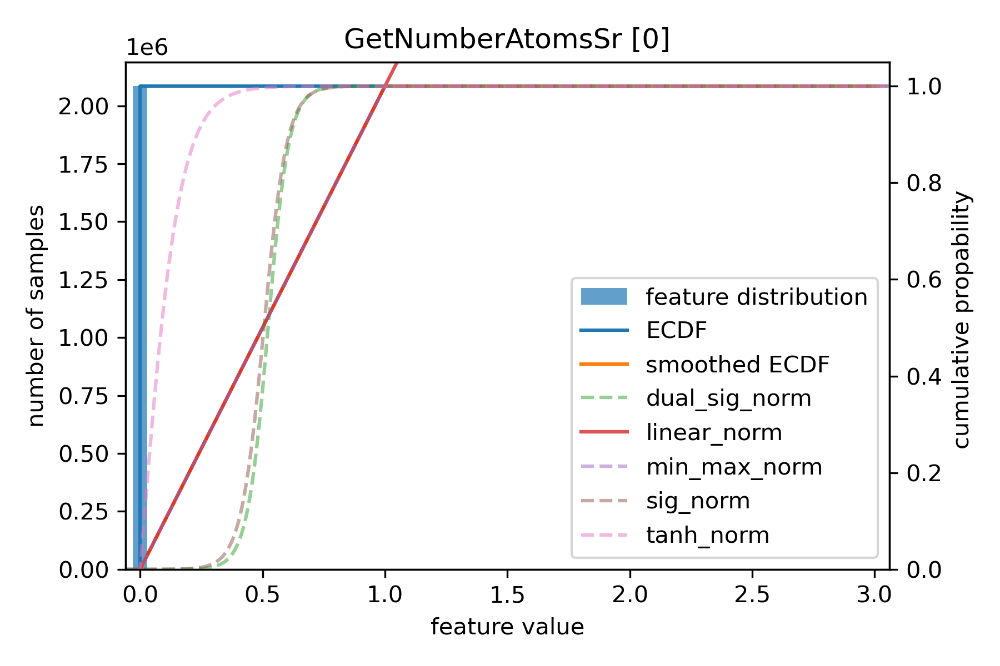

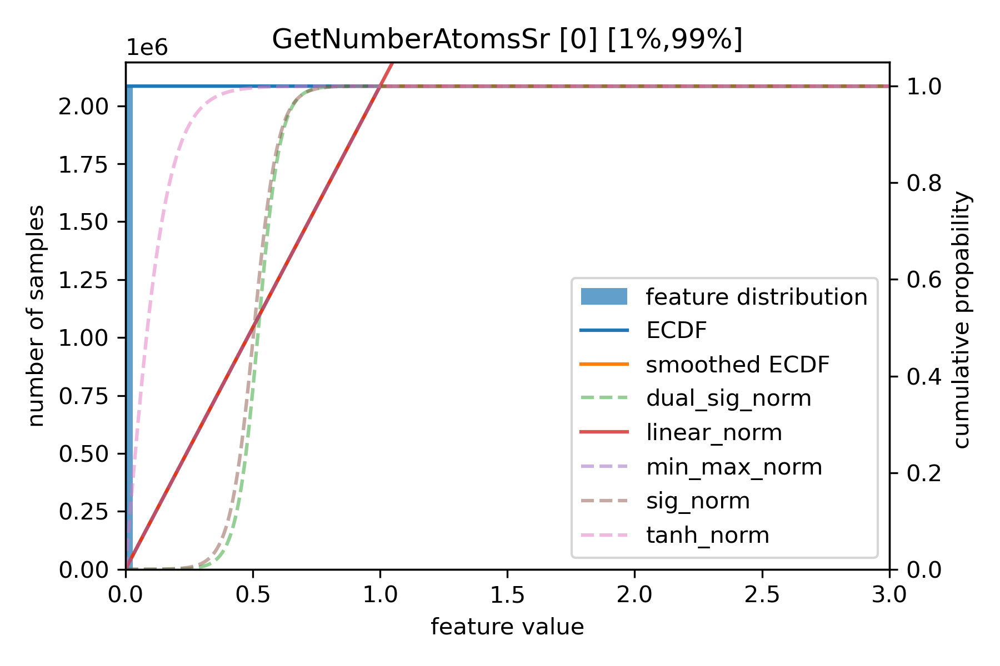

subfeats 0 missing
GetNumberAtomsTa_Featurizer
cannot create ecdf for GetNumberAtomsTa_Featurizer_0
subfeats 0 missing
GetNumberAtomsTb_Featurizer
cannot create ecdf for GetNumberAtomsTb_Featurizer_0
subfeats 0 missing
GetNumberAtomsTc_Featurizer
cannot create ecdf for GetNumberAtomsTc_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsTe_Featurizer
2 2
3 3
fit GetNumberAtomsTe_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


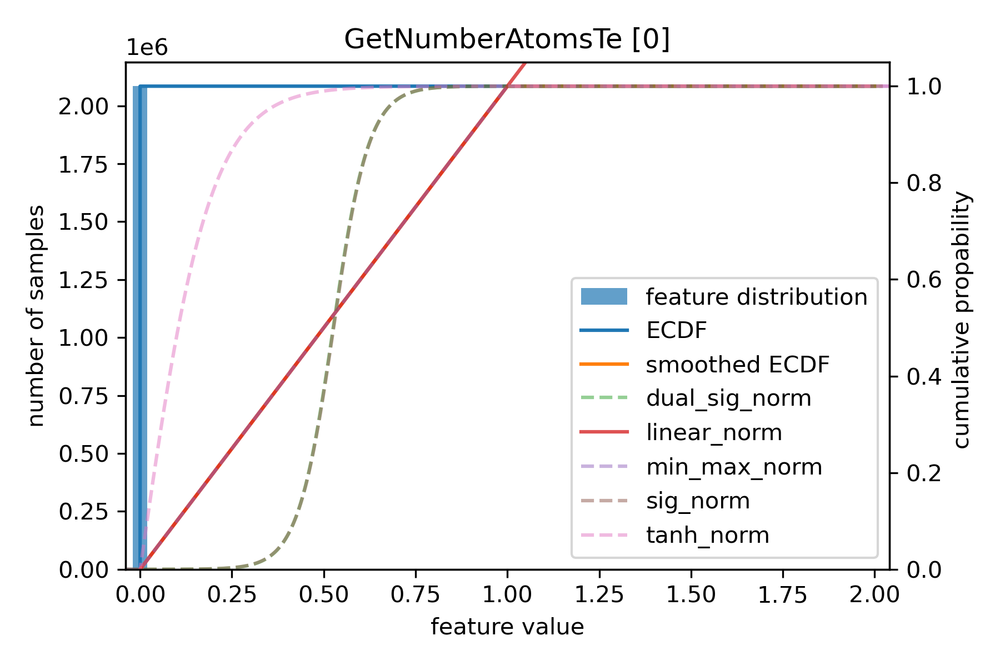

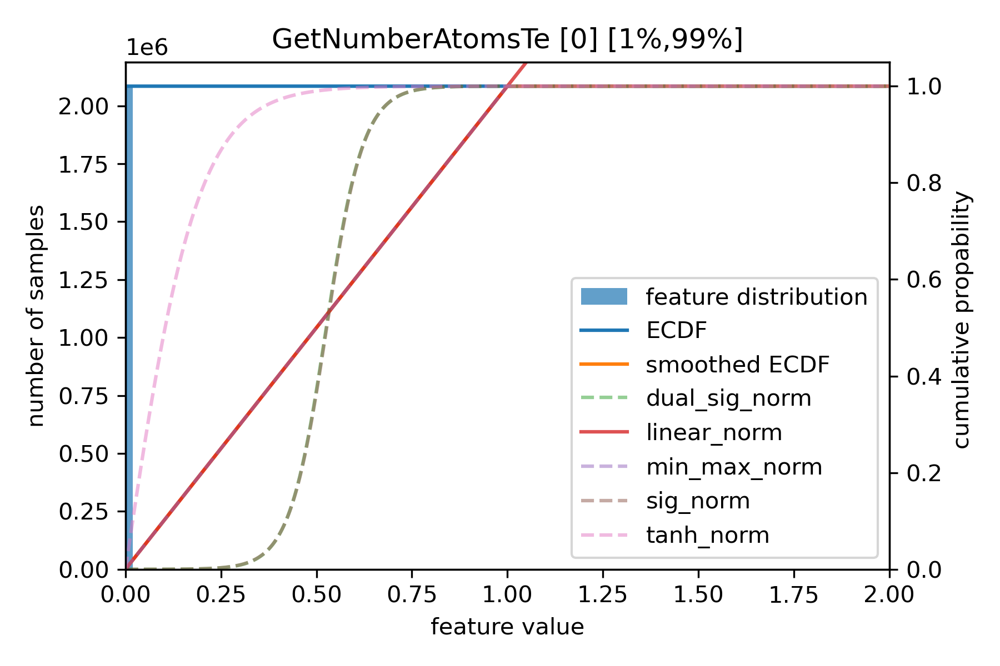

subfeats 0 missing
GetNumberAtomsTh_Featurizer
cannot create ecdf for GetNumberAtomsTh_Featurizer_0
subfeats 0 missing
GetNumberAtomsTi_Featurizer
cannot create ecdf for GetNumberAtomsTi_Featurizer_0
subfeats 0 missing
GetNumberAtomsTl_Featurizer
cannot create ecdf for GetNumberAtomsTl_Featurizer_0
subfeats 0 missing
GetNumberAtomsTm_Featurizer
cannot create ecdf for GetNumberAtomsTm_Featurizer_0
subfeats 0 missing
GetNumberAtomsTs_Featurizer
cannot create ecdf for GetNumberAtomsTs_Featurizer_0
subfeats 0 missing
GetNumberAtomsU_Featurizer
cannot create ecdf for GetNumberAtomsU_Featurizer_0
subfeats 0 missing
GetNumberAtomsV_Featurizer
cannot create ecdf for GetNumberAtomsV_Featurizer_0
subfeats 0 missing
GetNumberAtomsW_Featurizer
cannot create ecdf for GetNumberAtomsW_Featurizer_0
fits 0 dual_sig_norm missing
GetNumberAtomsXe_Featurizer
1 1
1 1
fit GetNumberAtomsXe_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetNumberAtomsXe_Featurizer_0 with genlog_norm using scip

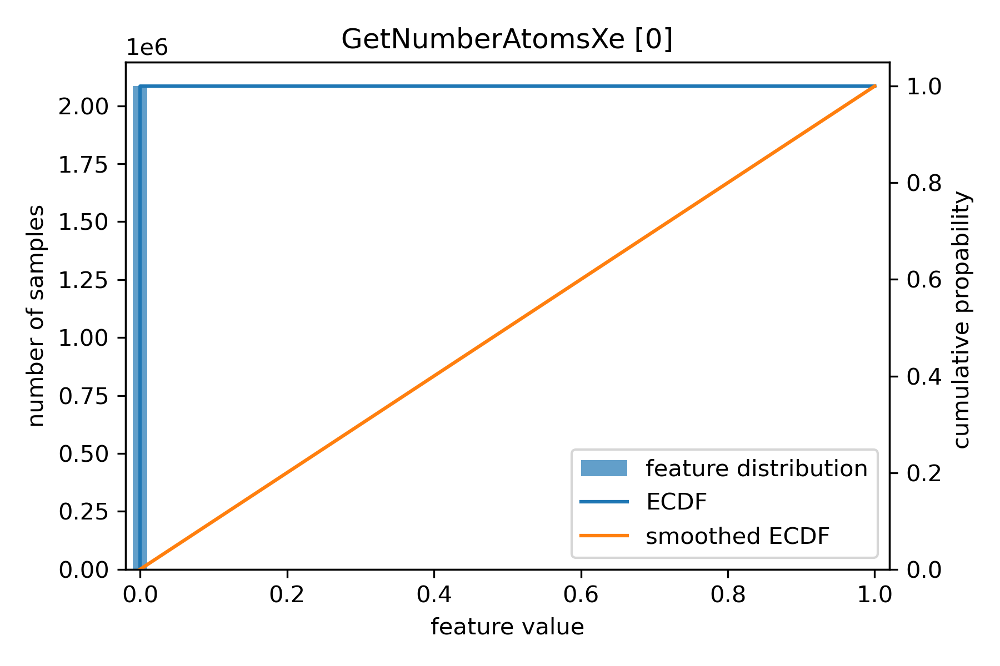

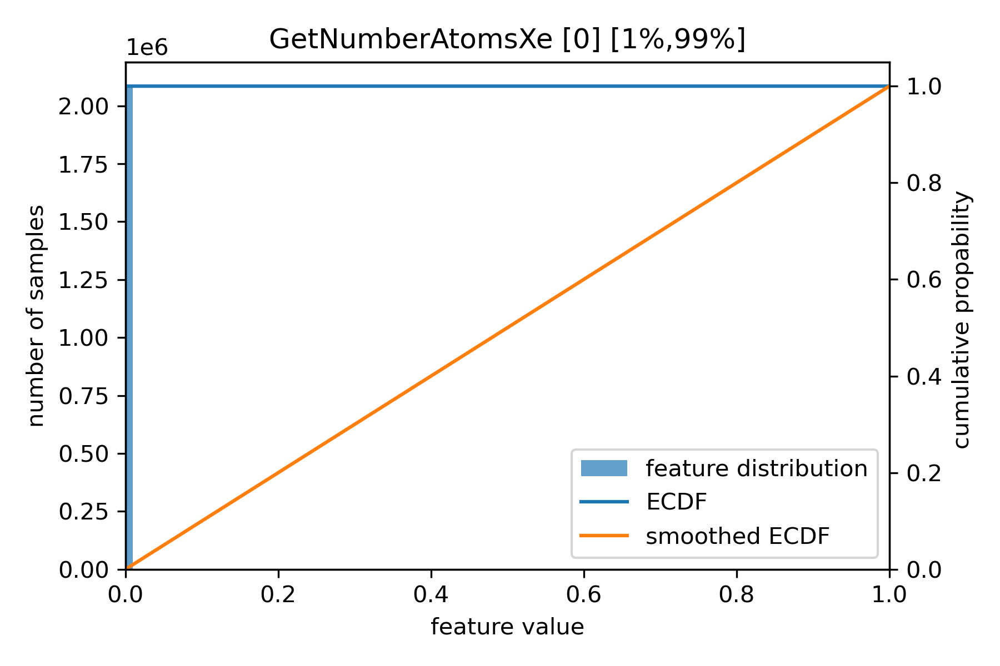

subfeats 0 missing
GetNumberAtomsY_Featurizer
cannot create ecdf for GetNumberAtomsY_Featurizer_0
subfeats 0 missing
GetNumberAtomsYb_Featurizer
cannot create ecdf for GetNumberAtomsYb_Featurizer_0
fits 0 genlog_norm missing
GetNumberAtomsZn_Featurizer
2 2
3 3
fit GetNumberAtomsZn_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


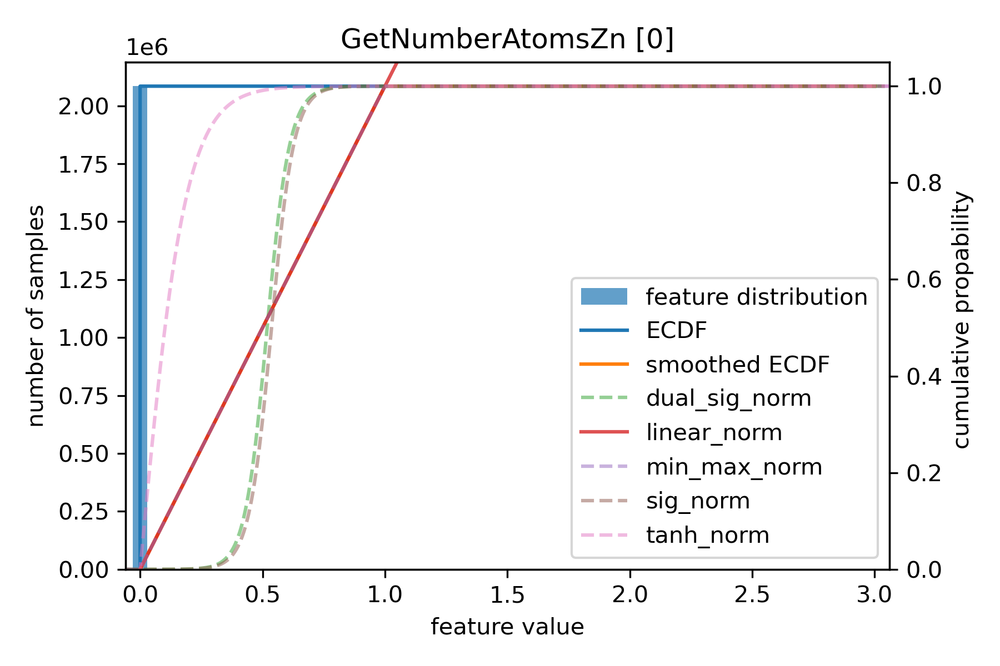

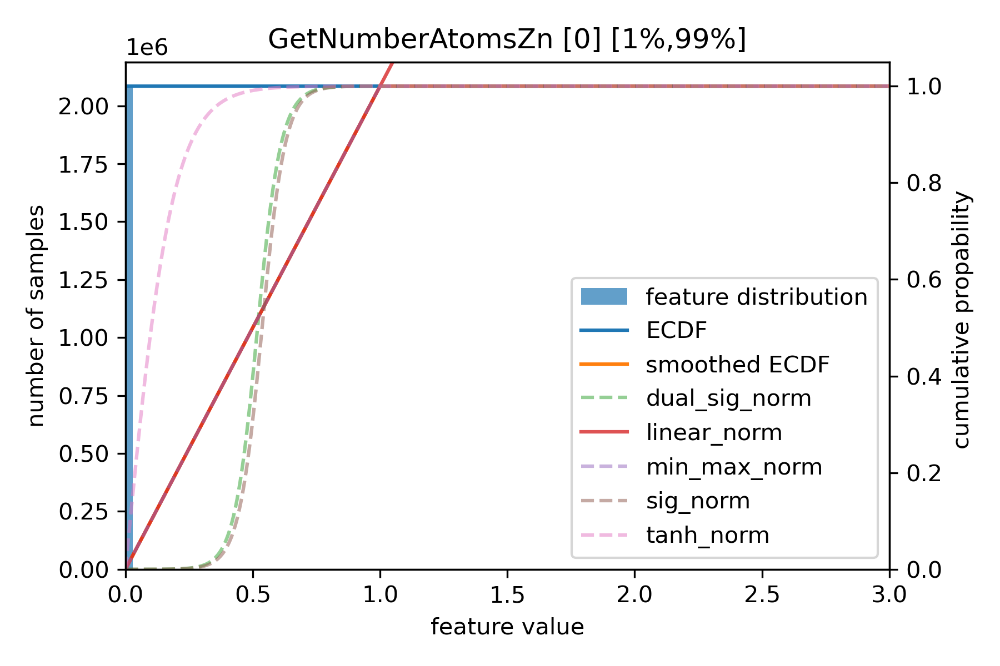

subfeats 0 missing
GetNumberAtomsZr_Featurizer
cannot create ecdf for GetNumberAtomsZr_Featurizer_0
subfeats 0 missing
GetRelativeContentAc_Featurizer
cannot create ecdf for GetRelativeContentAc_Featurizer_0
fits 0 genlog_norm missing
GetRelativeContentAg_Featurizer
2 2
3 3
fit GetRelativeContentAg_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


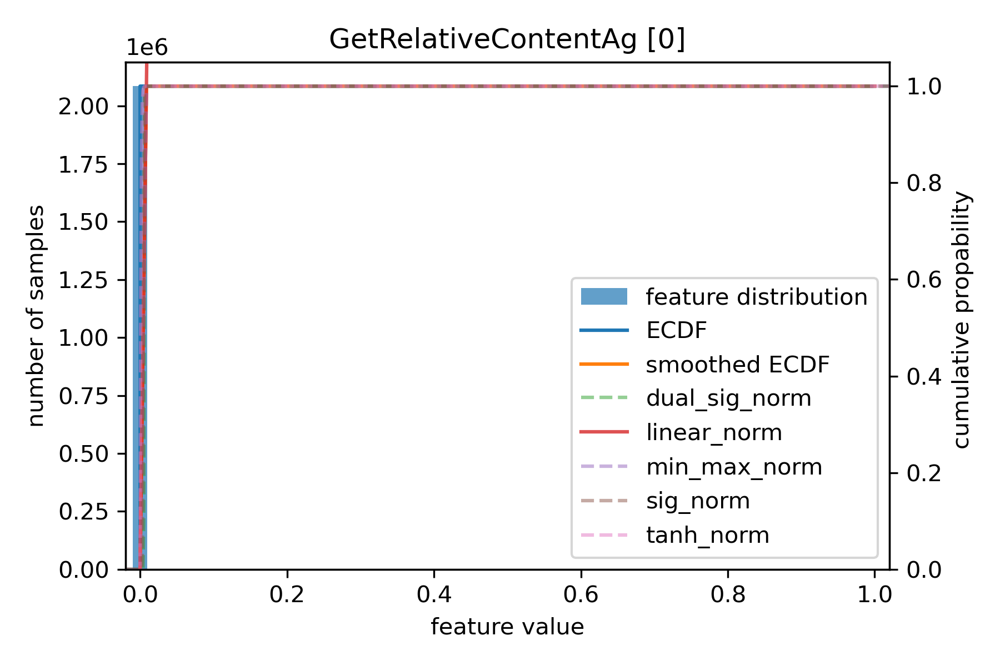

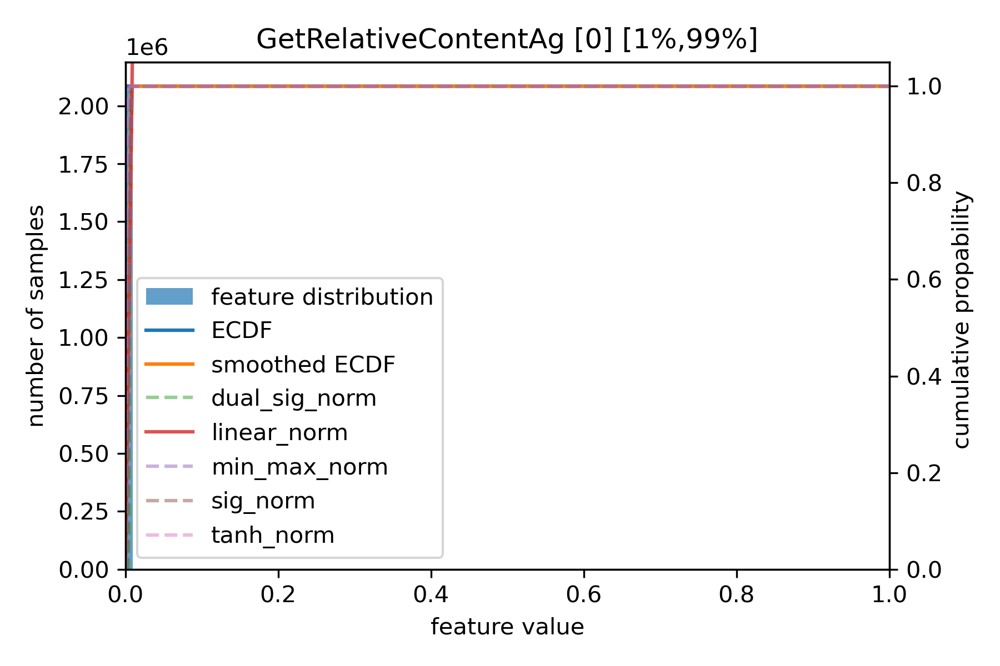

fits 0 genlog_norm missing
GetRelativeContentAl_Featurizer
2 2
3 3
fit GetRelativeContentAl_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


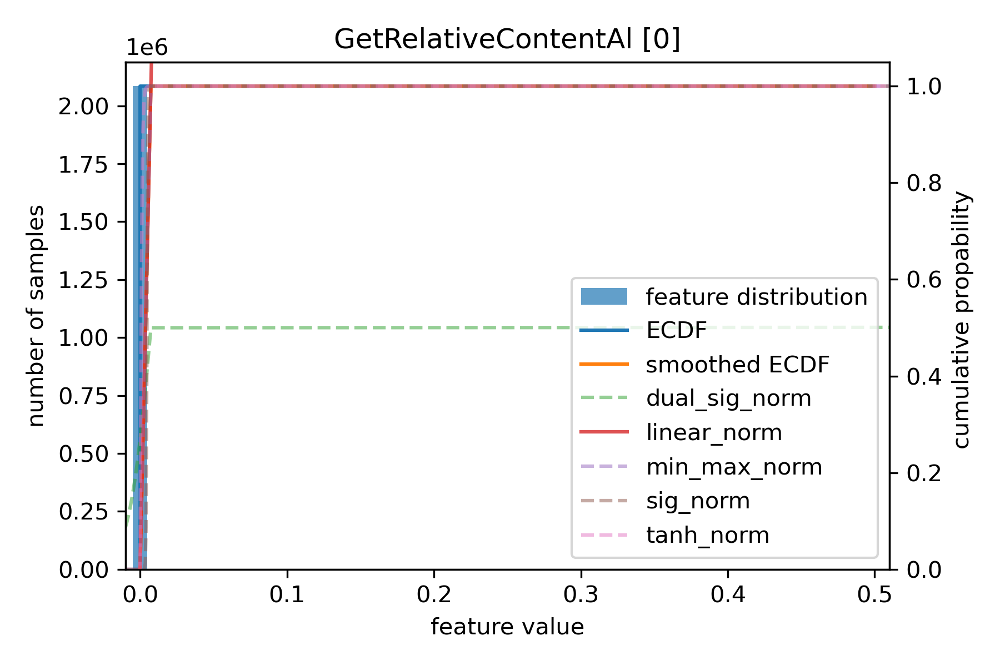

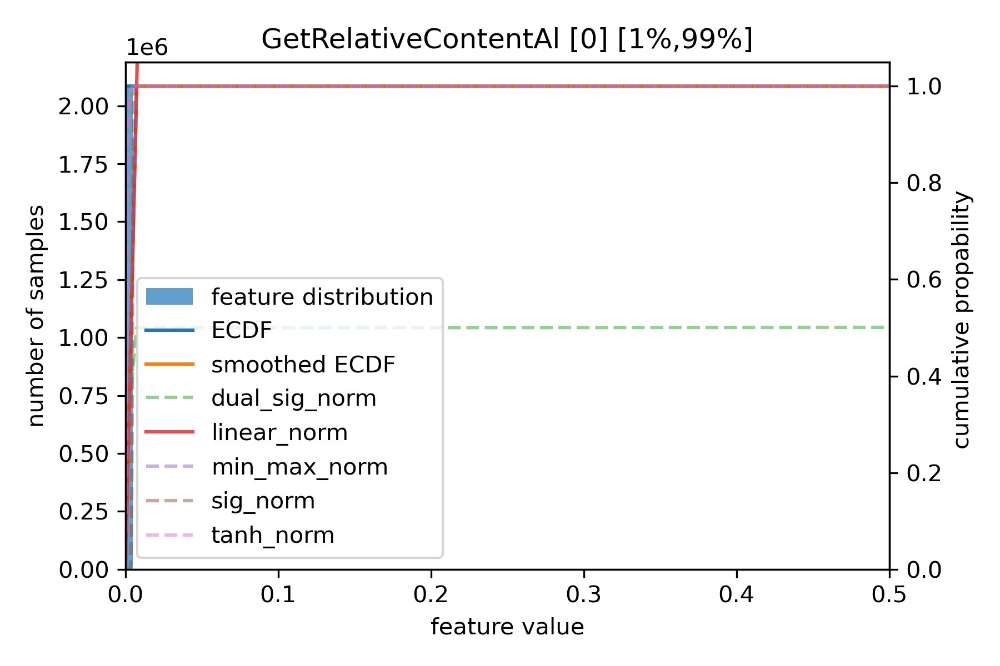

subfeats 0 missing
GetRelativeContentAm_Featurizer
cannot create ecdf for GetRelativeContentAm_Featurizer_0
subfeats 0 missing
GetRelativeContentAr_Featurizer
cannot create ecdf for GetRelativeContentAr_Featurizer_0
fits 0 genlog_norm missing
GetRelativeContentAs_Featurizer
2 2
3 3
fit GetRelativeContentAs_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


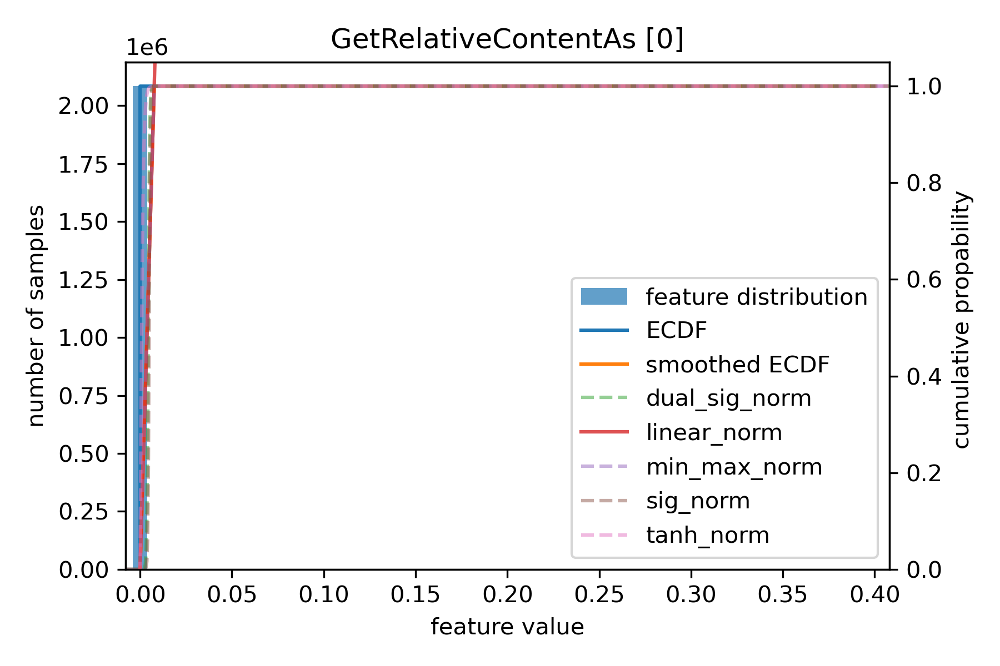

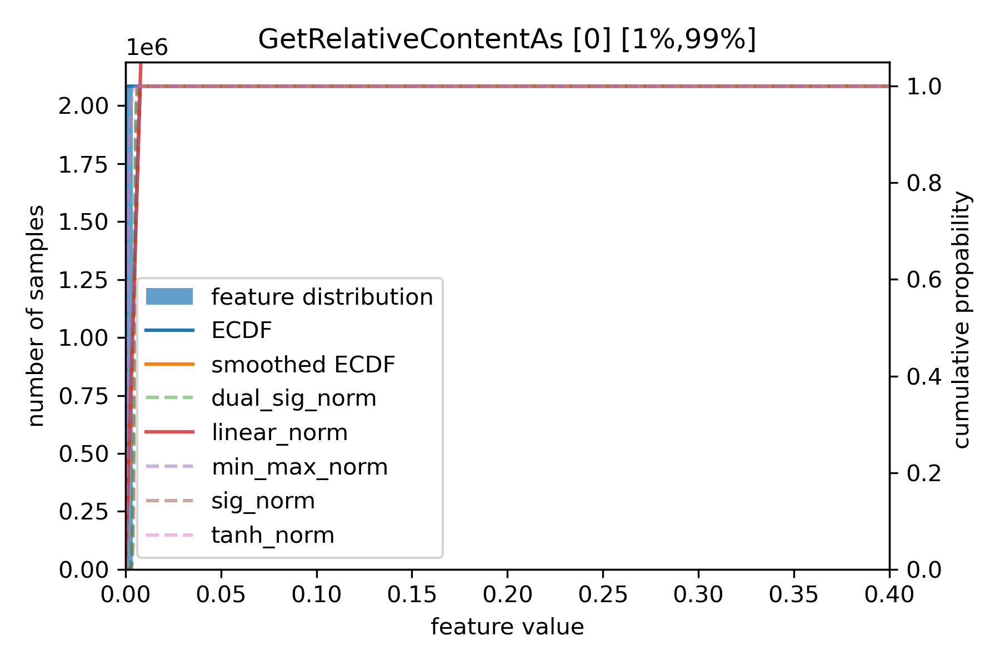

subfeats 0 missing
GetRelativeContentAt_Featurizer
cannot create ecdf for GetRelativeContentAt_Featurizer_0
subfeats 0 missing
GetRelativeContentAu_Featurizer
cannot create ecdf for GetRelativeContentAu_Featurizer_0
fits 0 genlog_norm missing
GetRelativeContentB_Featurizer
2 2
3 3
fit GetRelativeContentB_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


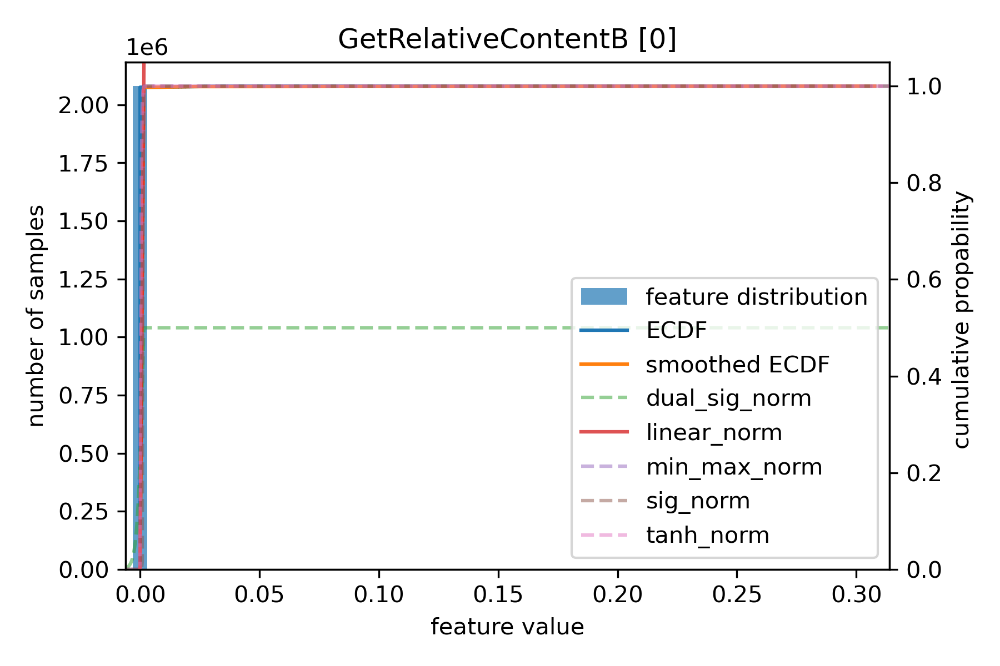

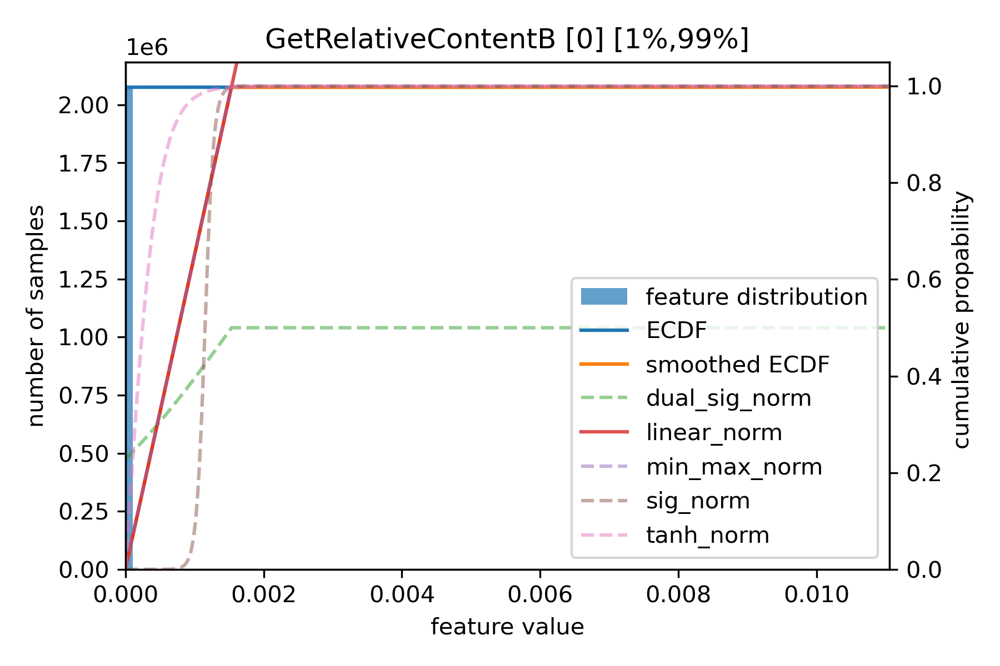

fits 0 genlog_norm missing
GetRelativeContentBa_Featurizer
2 2
3 3
fit GetRelativeContentBa_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


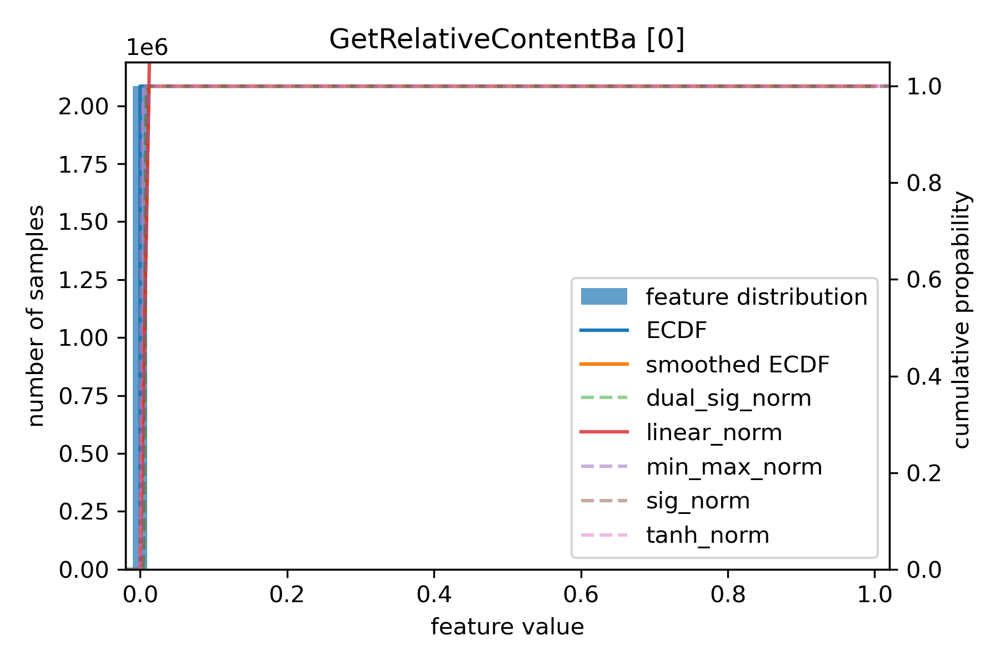

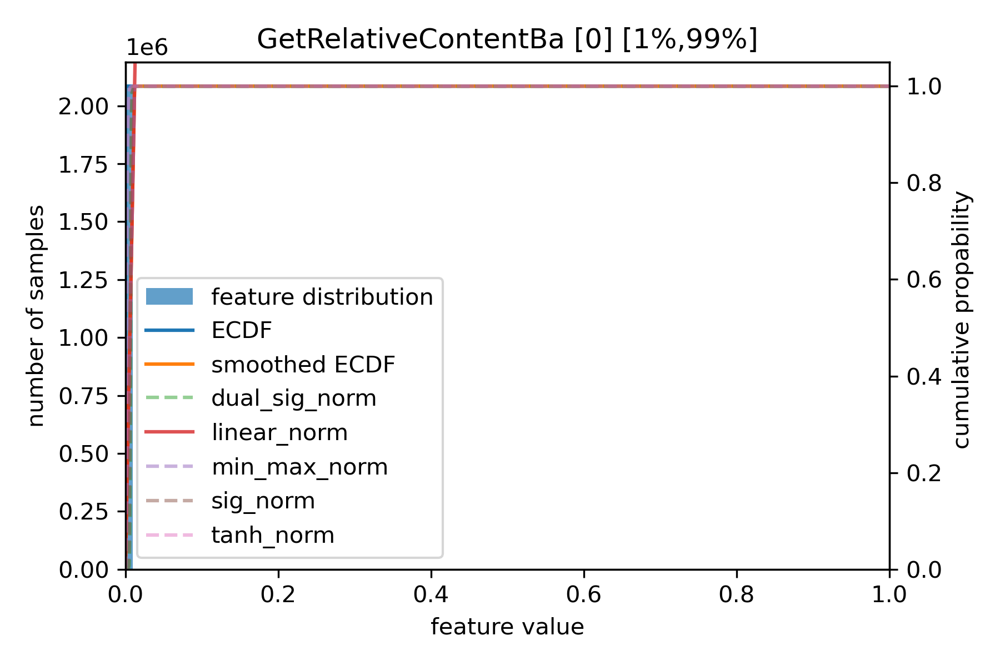

fits 0 genlog_norm missing
GetRelativeContentBe_Featurizer
2 2
3 3
fit GetRelativeContentBe_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


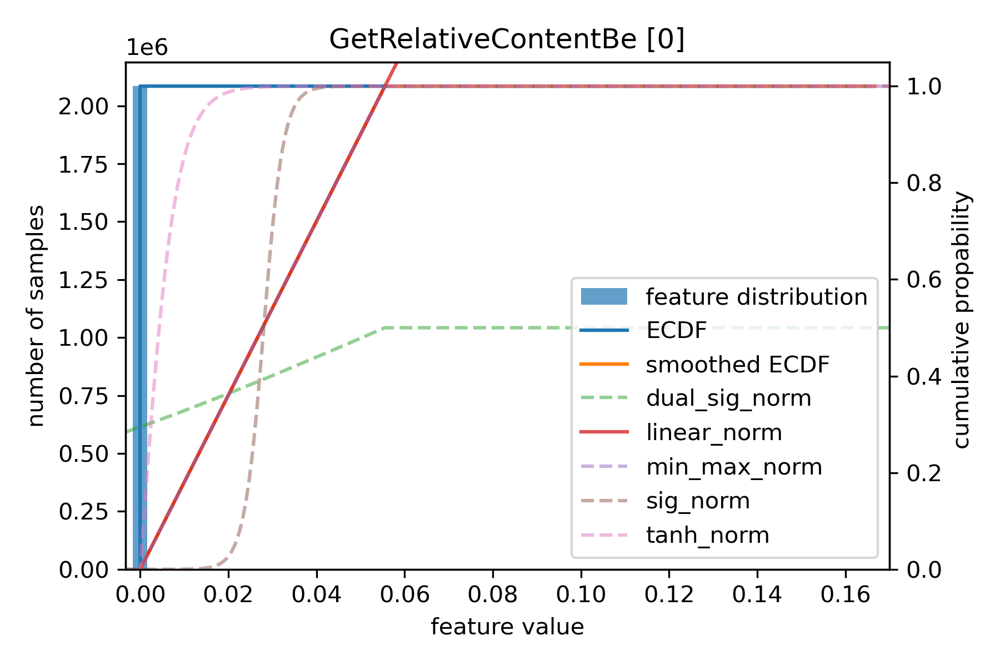

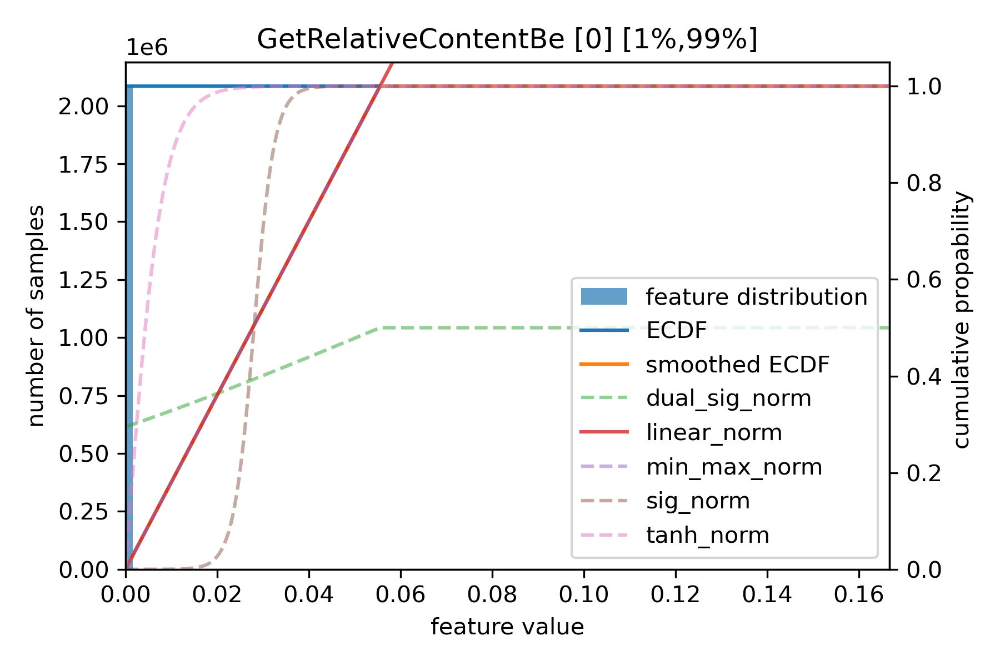

subfeats 0 missing
GetRelativeContentBh_Featurizer
cannot create ecdf for GetRelativeContentBh_Featurizer_0
fits 0 genlog_norm missing
GetRelativeContentBi_Featurizer
2 2
3 3
fit GetRelativeContentBi_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


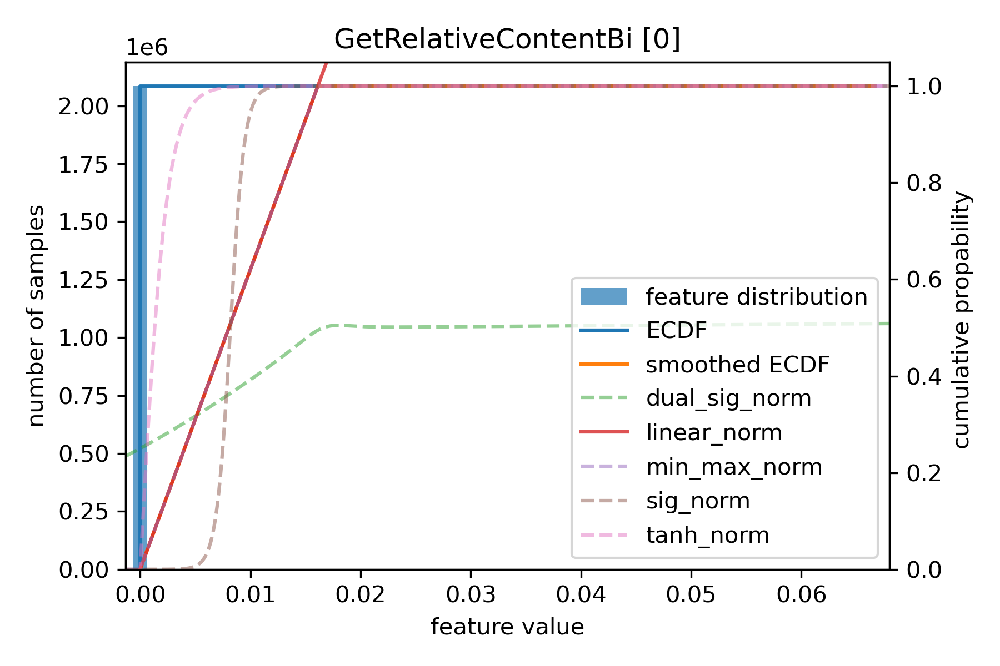

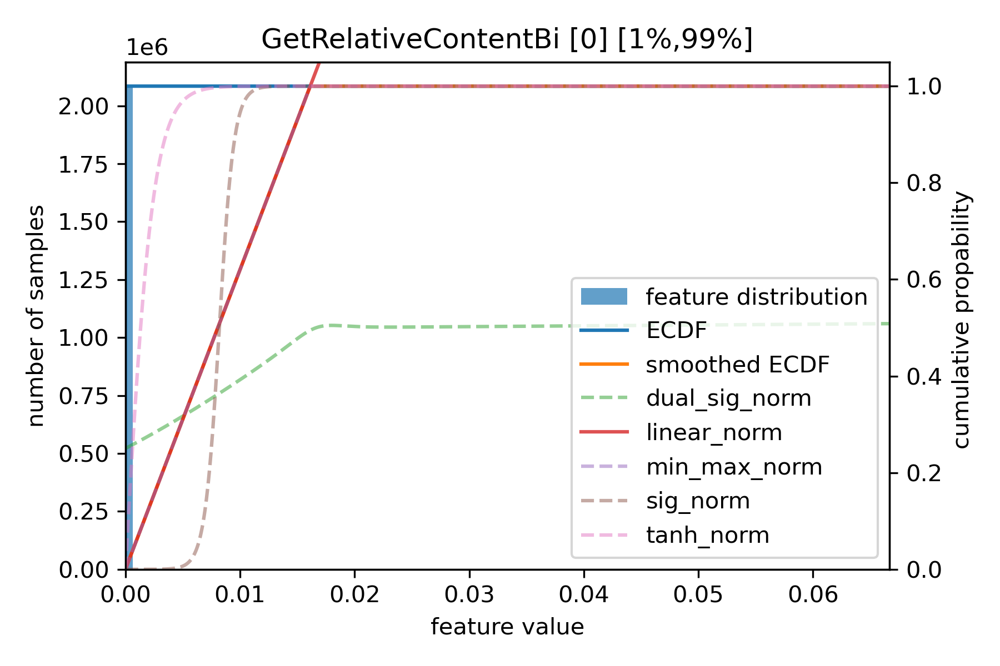

subfeats 0 missing
GetRelativeContentBk_Featurizer
cannot create ecdf for GetRelativeContentBk_Featurizer_0
fits 0 genlog_norm missing
GetRelativeContentCa_Featurizer
2 2
3 3
fit GetRelativeContentCa_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


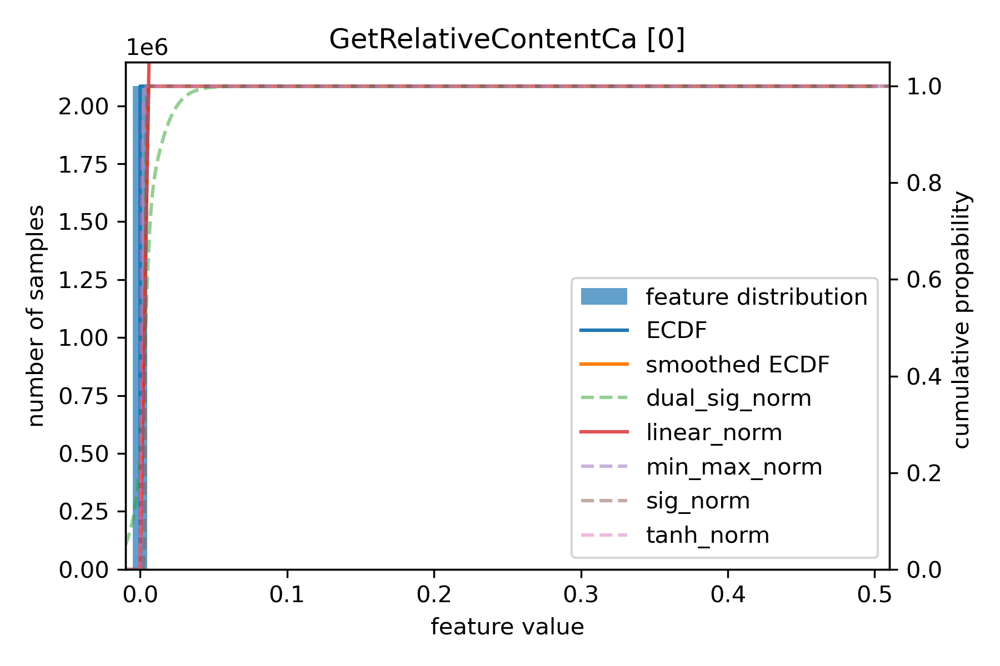

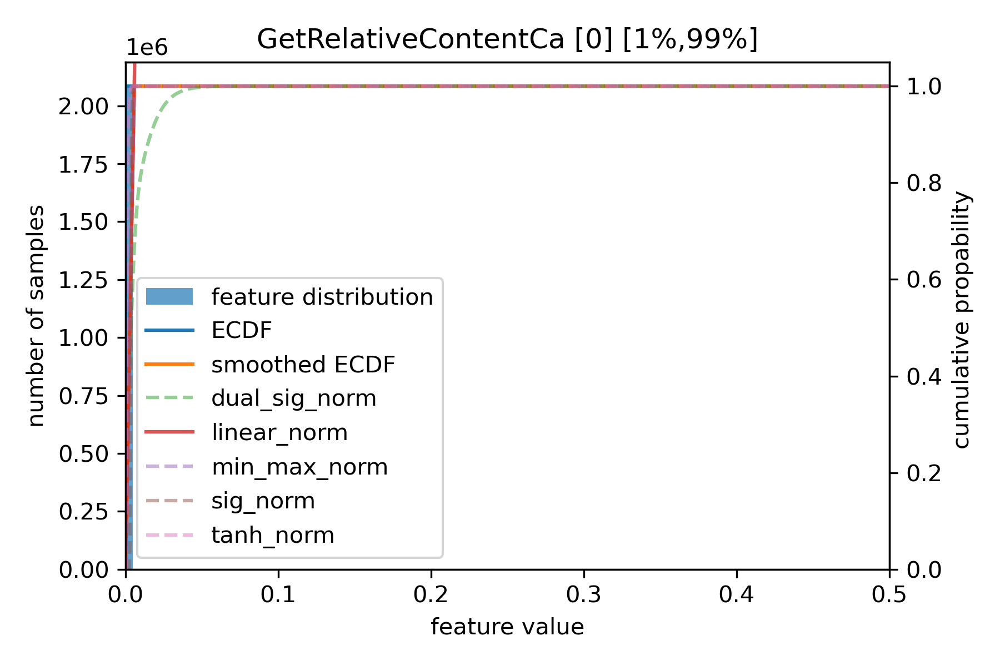

subfeats 0 missing
GetRelativeContentCd_Featurizer
cannot create ecdf for GetRelativeContentCd_Featurizer_0
subfeats 0 missing
GetRelativeContentCe_Featurizer
cannot create ecdf for GetRelativeContentCe_Featurizer_0
subfeats 0 missing
GetRelativeContentCf_Featurizer
cannot create ecdf for GetRelativeContentCf_Featurizer_0
subfeats 0 missing
GetRelativeContentCm_Featurizer
cannot create ecdf for GetRelativeContentCm_Featurizer_0
subfeats 0 missing
GetRelativeContentCn_Featurizer
cannot create ecdf for GetRelativeContentCn_Featurizer_0
subfeats 0 missing
GetRelativeContentCo_Featurizer
cannot create ecdf for GetRelativeContentCo_Featurizer_0
subfeats 0 missing
GetRelativeContentCr_Featurizer
cannot create ecdf for GetRelativeContentCr_Featurizer_0
fits 0 genlog_norm missing
GetRelativeContentCs_Featurizer
2 2
3 3
fit GetRelativeContentCs_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99


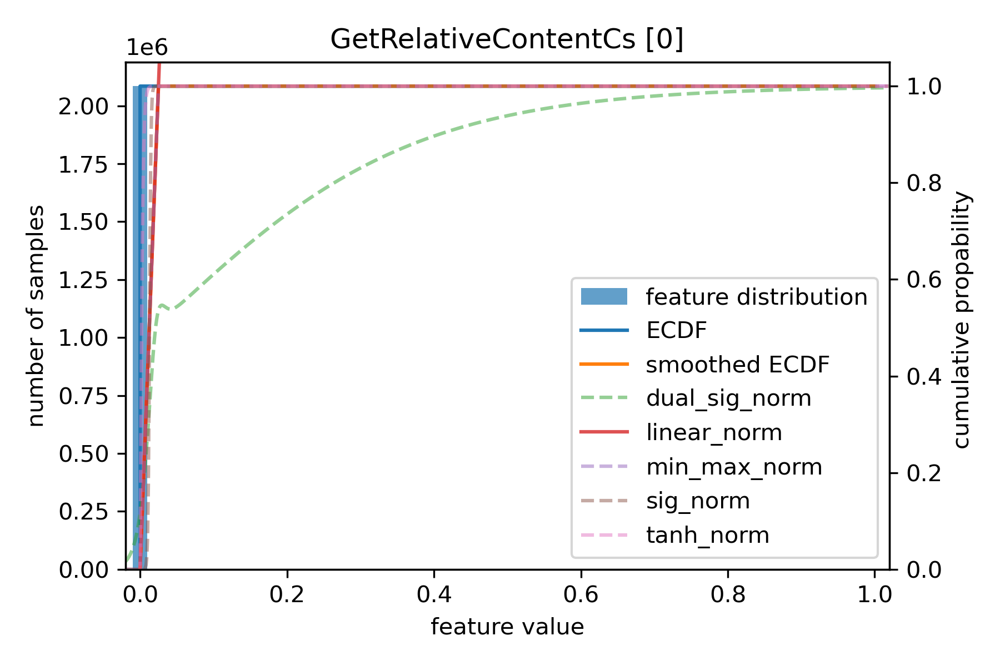

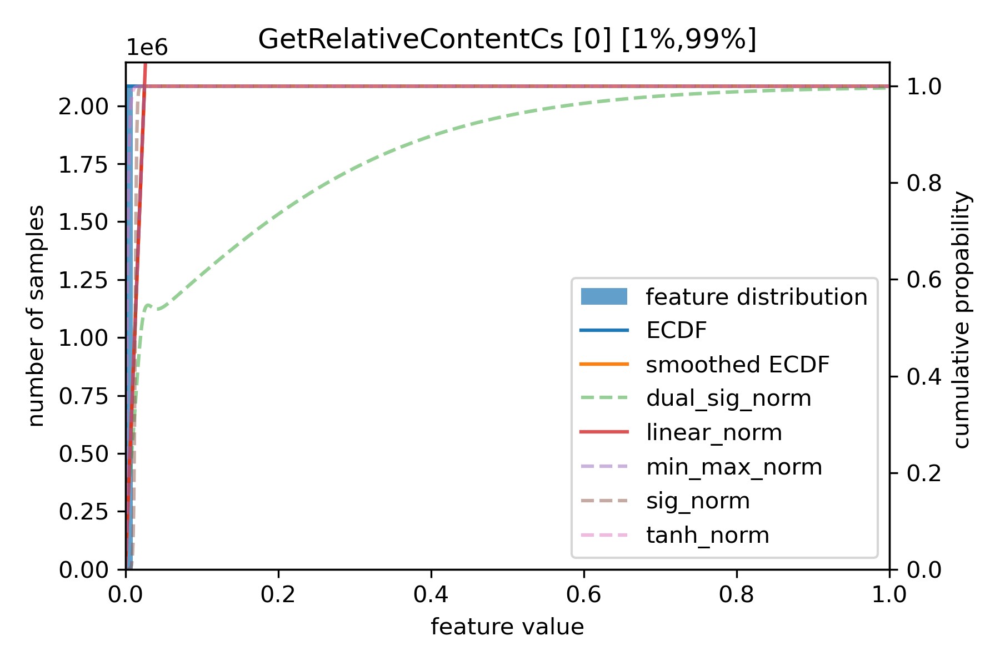

subfeats 0 missing
GetRelativeContentCu_Featurizer
cannot create ecdf for GetRelativeContentCu_Featurizer_0
subfeats 0 missing
GetRelativeContentDb_Featurizer
cannot create ecdf for GetRelativeContentDb_Featurizer_0
subfeats 0 missing
GetRelativeContentDs_Featurizer
cannot create ecdf for GetRelativeContentDs_Featurizer_0
subfeats 0 missing
GetRelativeContentDy_Featurizer
cannot create ecdf for GetRelativeContentDy_Featurizer_0
subfeats 0 missing
GetRelativeContentEr_Featurizer
cannot create ecdf for GetRelativeContentEr_Featurizer_0
subfeats 0 missing
GetRelativeContentEs_Featurizer
cannot create ecdf for GetRelativeContentEs_Featurizer_0
subfeats 0 missing
GetRelativeContentEu_Featurizer
cannot create ecdf for GetRelativeContentEu_Featurizer_0
subfeats 0 missing
GetRelativeContentFe_Featurizer
cannot create ecdf for GetRelativeContentFe_Featurizer_0
subfeats 0 missing
GetRelativeContentFl_Featurizer
cannot create ecdf for GetRelativeContentFl_Featurizer_0
subfeats 0 missing
GetRelati

/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:170: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:184: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:187: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


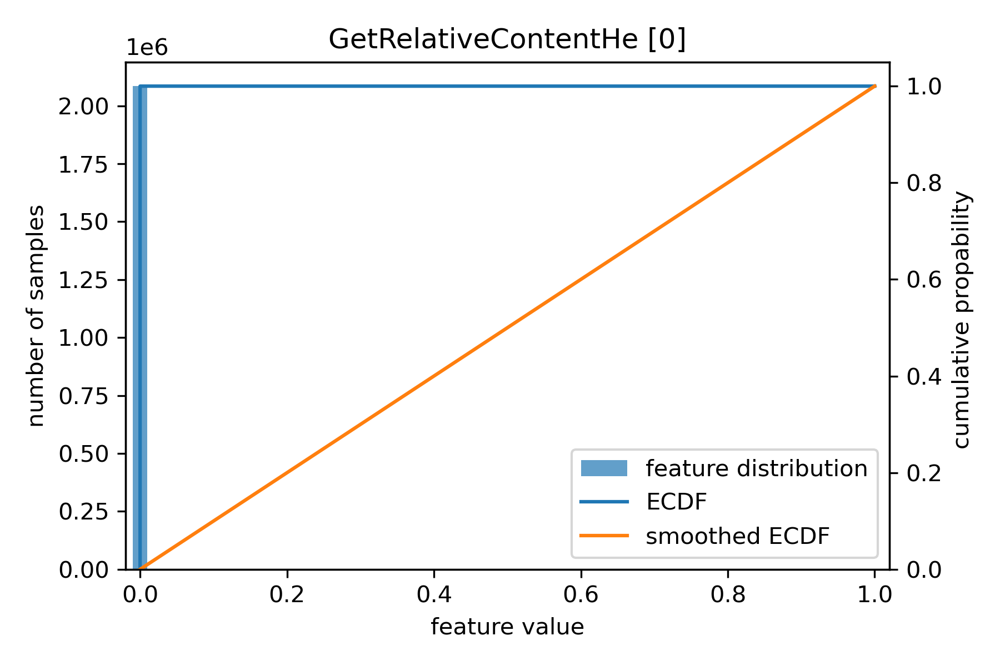

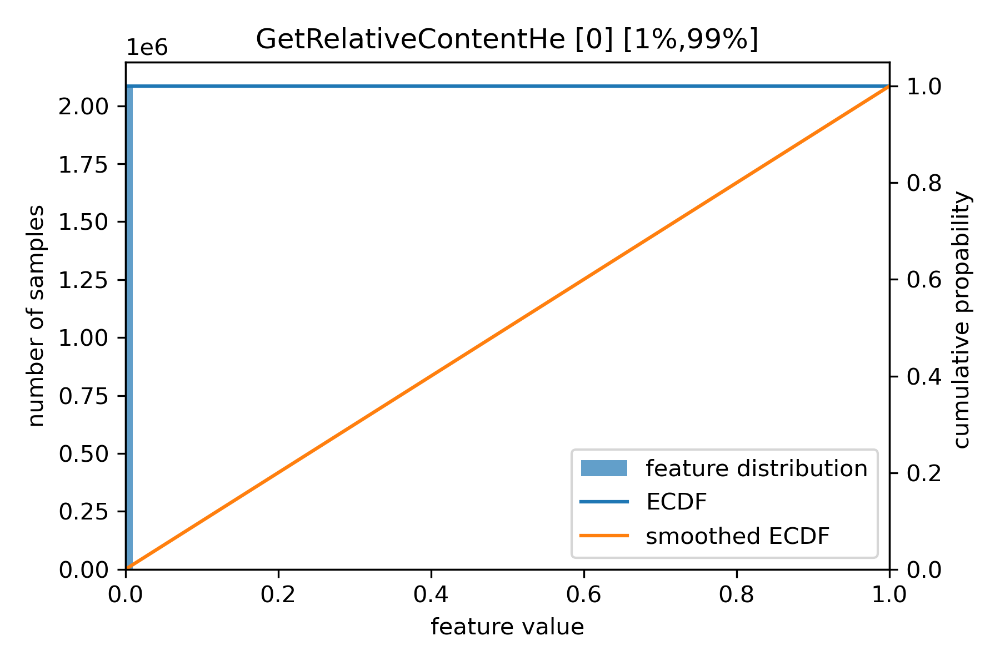

subfeats missing
GetRelativeContentHf_Featurizer
gen smooth ecdf for GetRelativeContentHf_Featurizer[0]
cannot create ecdf for GetRelativeContentHf_Featurizer_0
subfeats missing
GetRelativeContentHg_Featurizer
gen smooth ecdf for GetRelativeContentHg_Featurizer[0]
cannot create ecdf for GetRelativeContentHg_Featurizer_0
subfeats missing
GetRelativeContentHo_Featurizer
gen smooth ecdf for GetRelativeContentHo_Featurizer[0]
cannot create ecdf for GetRelativeContentHo_Featurizer_0
subfeats missing
GetRelativeContentHs_Featurizer
gen smooth ecdf for GetRelativeContentHs_Featurizer[0]
cannot create ecdf for GetRelativeContentHs_Featurizer_0
subfeats missing
GetRelativeContentI_Featurizer
gen smooth ecdf for GetRelativeContentI_Featurizer[0]
2 2
3 3
fit GetRelativeContentI_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99


/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


fit GetRelativeContentI_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentI_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentI_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentI_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetRelativeContentI_Featurizer_0 with min_max_norm using manual_1_99
fit GetRelativeContentI_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentI_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99
gen full ecdf for GetRelativeContentI_Featurizer[0]


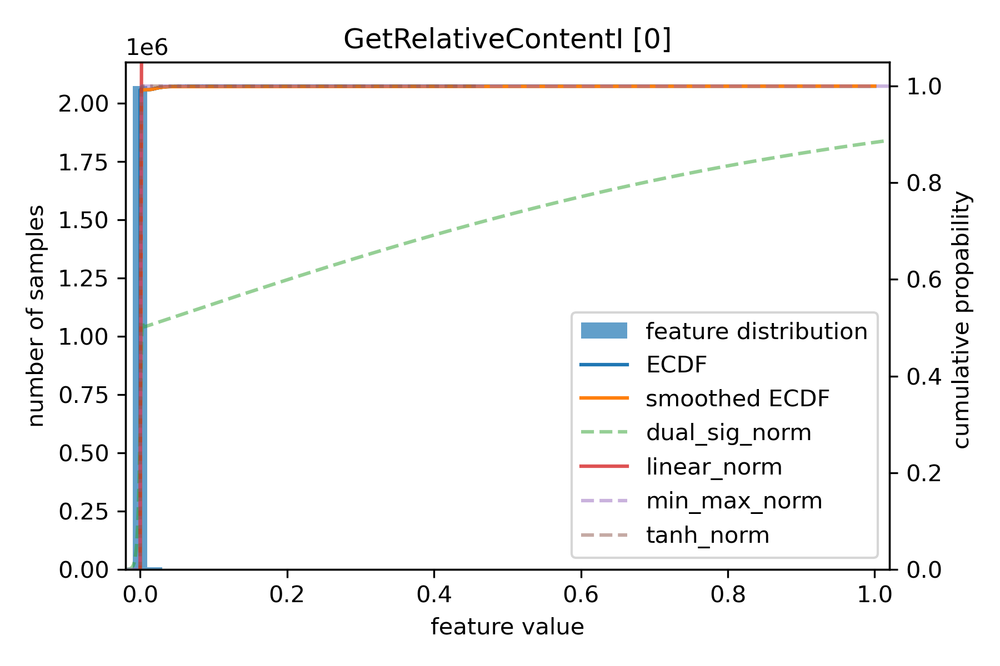

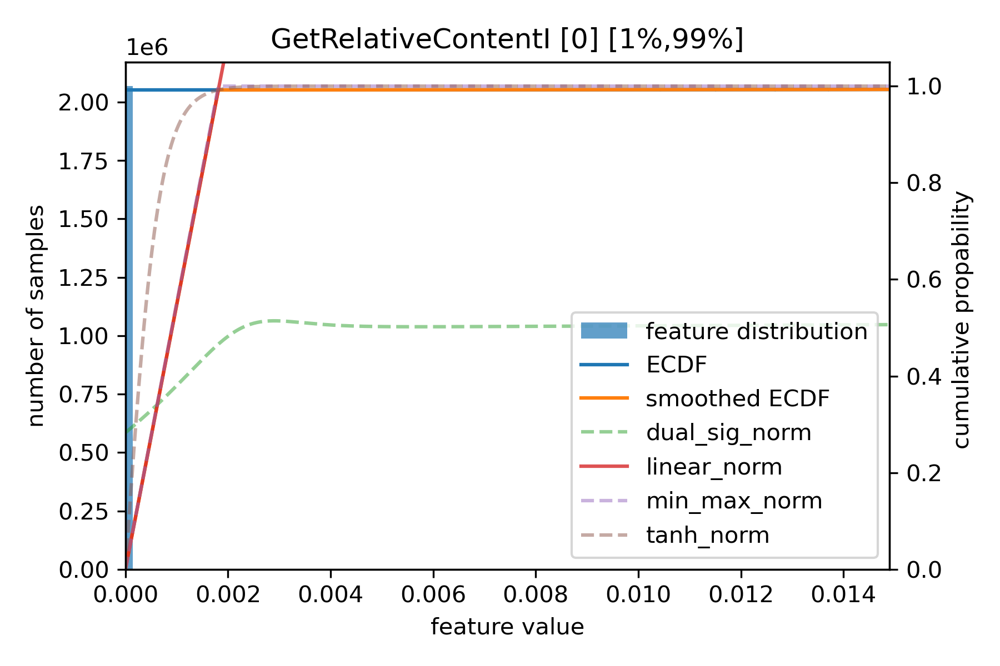

subfeats missing
GetRelativeContentIn_Featurizer
gen smooth ecdf for GetRelativeContentIn_Featurizer[0]
cannot create ecdf for GetRelativeContentIn_Featurizer_0
subfeats missing
GetRelativeContentIr_Featurizer
gen smooth ecdf for GetRelativeContentIr_Featurizer[0]
cannot create ecdf for GetRelativeContentIr_Featurizer_0
subfeats missing
GetRelativeContentK_Featurizer
gen smooth ecdf for GetRelativeContentK_Featurizer[0]
2 2
3 3
fit GetRelativeContentK_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentK_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentK_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentK_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentK_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetRelativeContentK_Featurizer_0 with min_max_norm using manual_1_99
fit GetRelativeContentK_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetRelativeCon

/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


gen full ecdf for GetRelativeContentK_Featurizer[0]


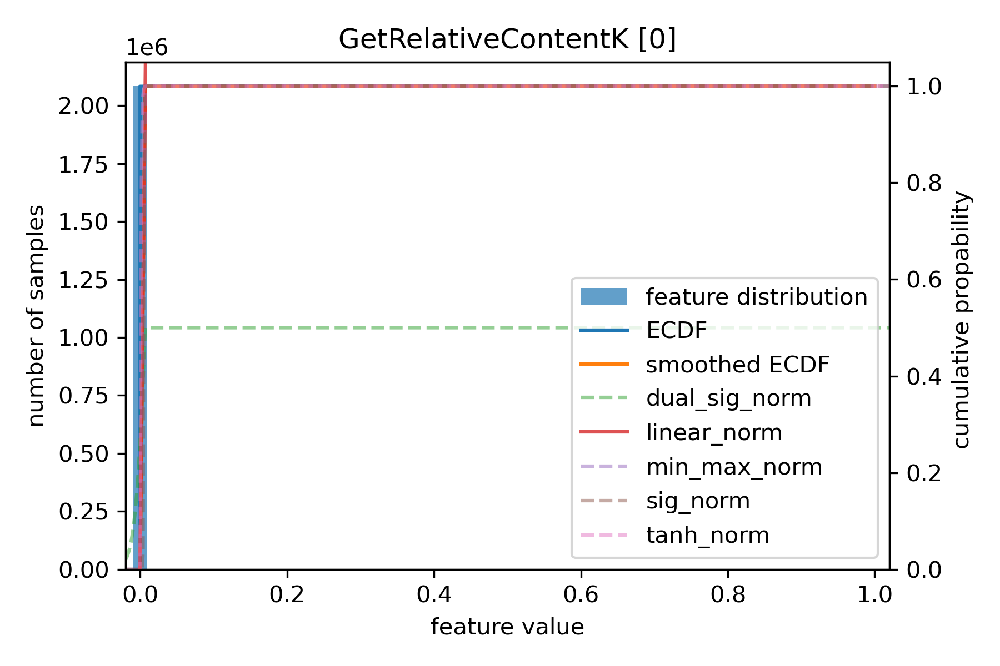

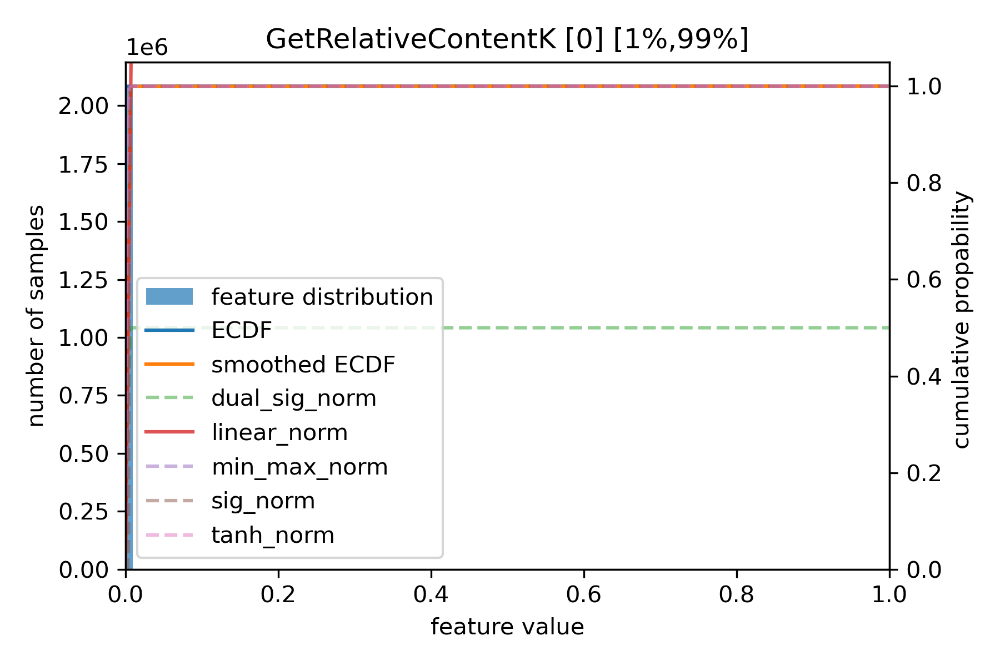

subfeats missing
GetRelativeContentKr_Featurizer
gen smooth ecdf for GetRelativeContentKr_Featurizer[0]
1 1
1 1
fit GetRelativeContentKr_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentKr_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentKr_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentKr_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentKr_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetRelativeContentKr_Featurizer_0 with min_max_norm using manual_1_99
fit GetRelativeContentKr_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentKr_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99
gen full ecdf for GetRelativeContentKr_Featurizer[0]


/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:170: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:184: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:187: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


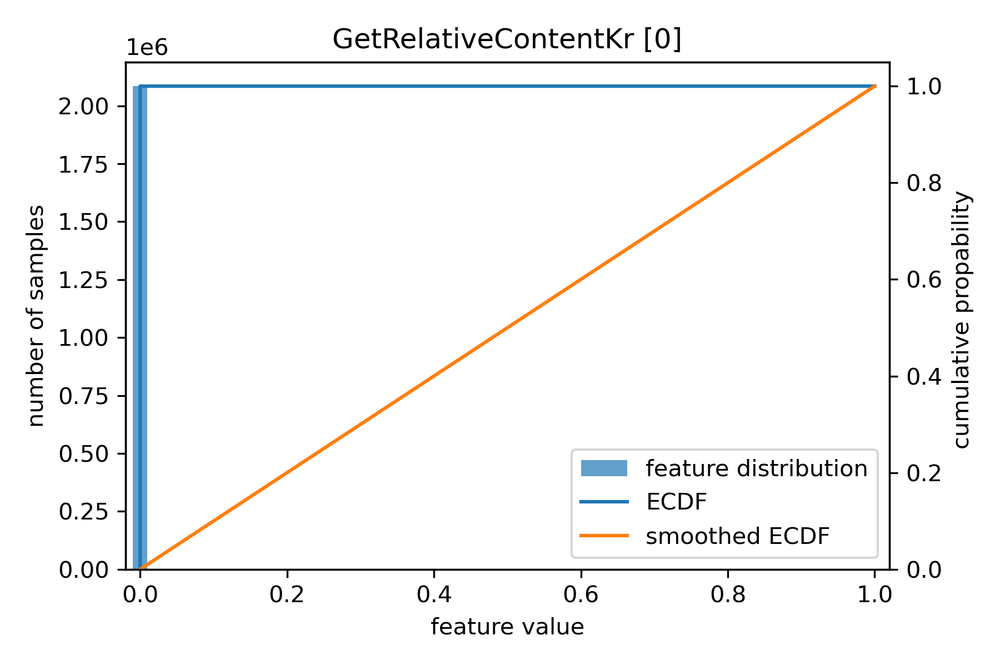

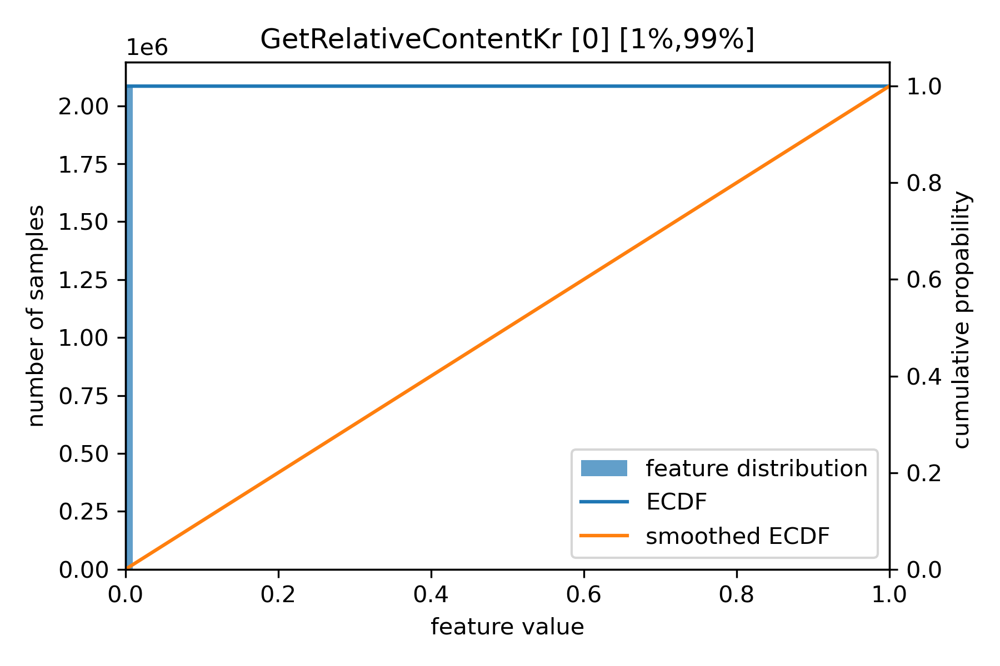

subfeats missing
GetRelativeContentLa_Featurizer
gen smooth ecdf for GetRelativeContentLa_Featurizer[0]
cannot create ecdf for GetRelativeContentLa_Featurizer_0
subfeats missing
GetRelativeContentLi_Featurizer
gen smooth ecdf for GetRelativeContentLi_Featurizer[0]
2 2
3 3
fit GetRelativeContentLi_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentLi_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentLi_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentLi_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentLi_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetRelativeContentLi_Featurizer_0 with min_max_norm using manual_1_99
fit GetRelativeContentLi_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentLi_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99


/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


gen full ecdf for GetRelativeContentLi_Featurizer[0]


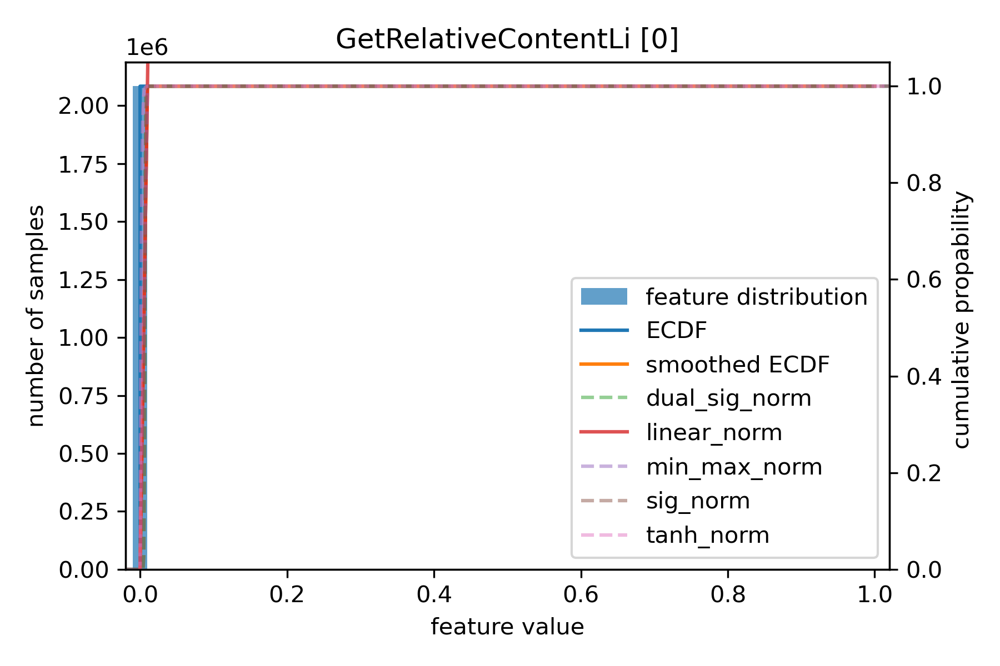

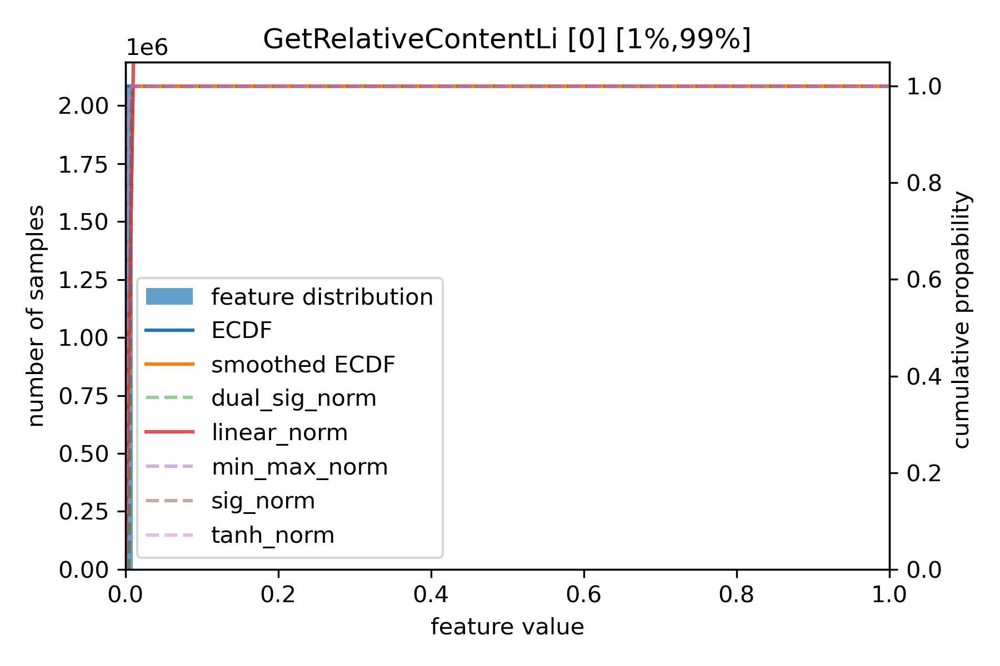

subfeats missing
GetRelativeContentLr_Featurizer
gen smooth ecdf for GetRelativeContentLr_Featurizer[0]
cannot create ecdf for GetRelativeContentLr_Featurizer_0
subfeats missing
GetRelativeContentLu_Featurizer
gen smooth ecdf for GetRelativeContentLu_Featurizer[0]
cannot create ecdf for GetRelativeContentLu_Featurizer_0
subfeats missing
GetRelativeContentLv_Featurizer
gen smooth ecdf for GetRelativeContentLv_Featurizer[0]
cannot create ecdf for GetRelativeContentLv_Featurizer_0
subfeats missing
GetRelativeContentMc_Featurizer
gen smooth ecdf for GetRelativeContentMc_Featurizer[0]
cannot create ecdf for GetRelativeContentMc_Featurizer_0
subfeats missing
GetRelativeContentMd_Featurizer
gen smooth ecdf for GetRelativeContentMd_Featurizer[0]
cannot create ecdf for GetRelativeContentMd_Featurizer_0
subfeats missing
GetRelativeContentMg_Featurizer
gen smooth ecdf for GetRelativeContentMg_Featurizer[0]
2 2
3 3
fit GetRelativeContentMg_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99

/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


fit GetRelativeContentMg_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentMg_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentMg_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentMg_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetRelativeContentMg_Featurizer_0 with min_max_norm using manual_1_99
fit GetRelativeContentMg_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentMg_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99
gen full ecdf for GetRelativeContentMg_Featurizer[0]


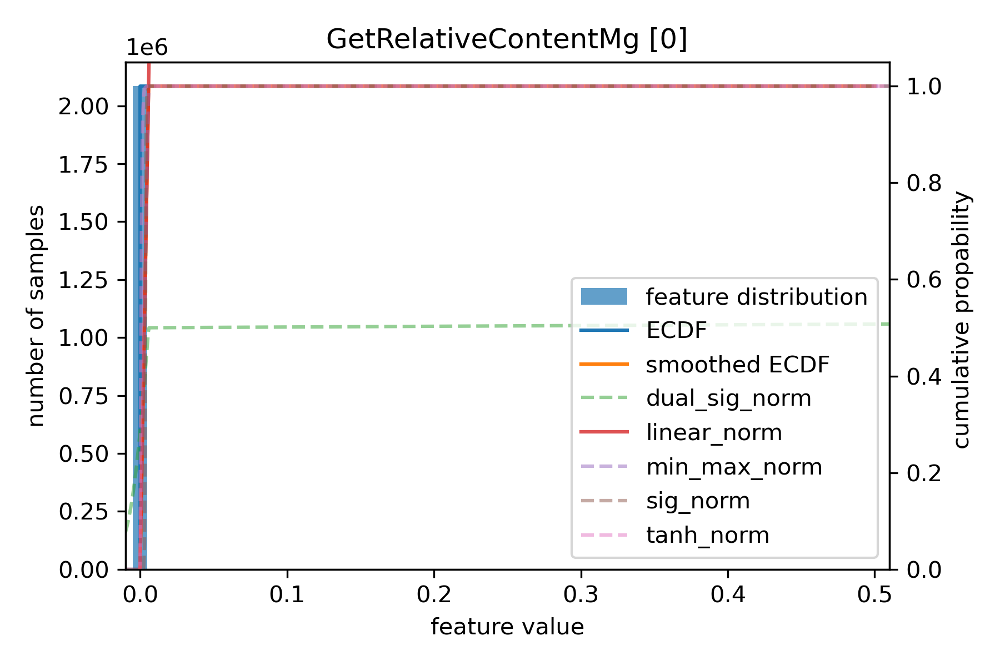

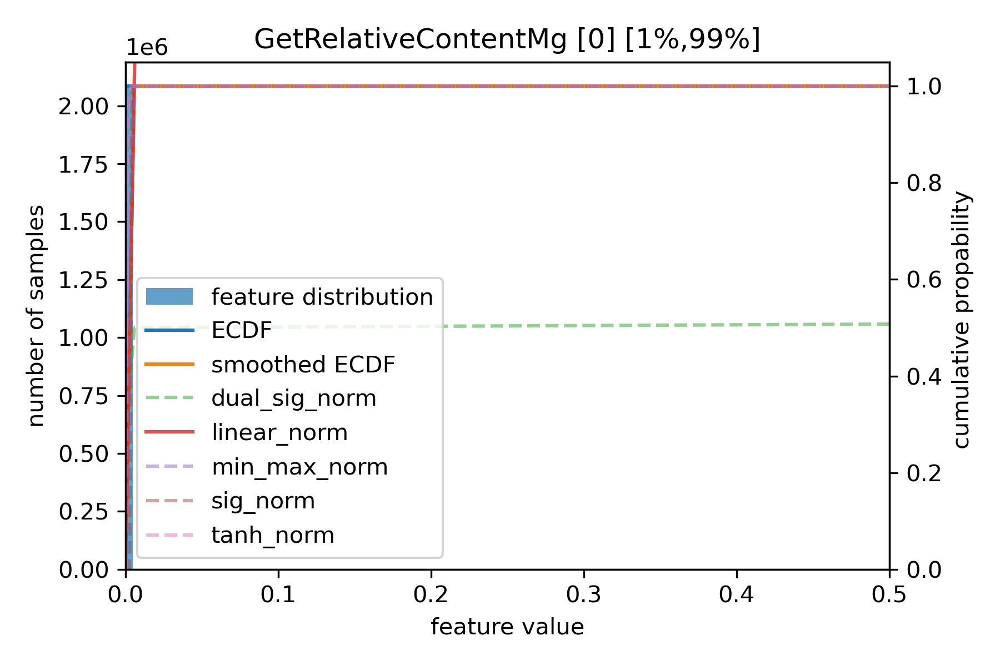

subfeats missing
GetRelativeContentMn_Featurizer
gen smooth ecdf for GetRelativeContentMn_Featurizer[0]
cannot create ecdf for GetRelativeContentMn_Featurizer_0
subfeats missing
GetRelativeContentMo_Featurizer
gen smooth ecdf for GetRelativeContentMo_Featurizer[0]
cannot create ecdf for GetRelativeContentMo_Featurizer_0
subfeats missing
GetRelativeContentMt_Featurizer
gen smooth ecdf for GetRelativeContentMt_Featurizer[0]
cannot create ecdf for GetRelativeContentMt_Featurizer_0
subfeats missing
GetRelativeContentN_Featurizer
gen smooth ecdf for GetRelativeContentN_Featurizer[0]
571 571
856 856
fit GetRelativeContentN_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentN_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentN_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentN_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentN_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99


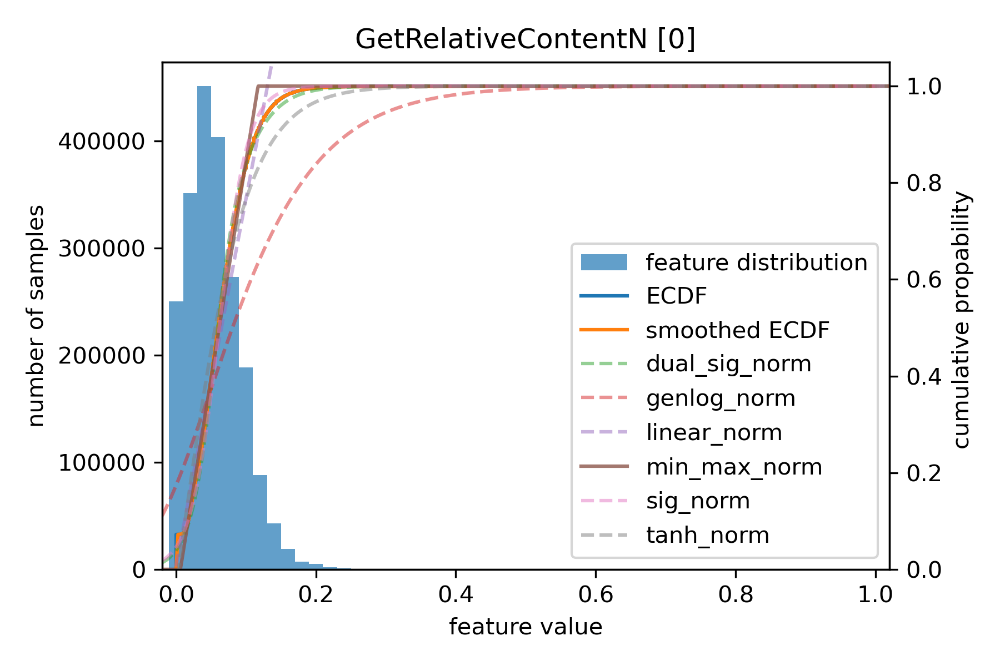

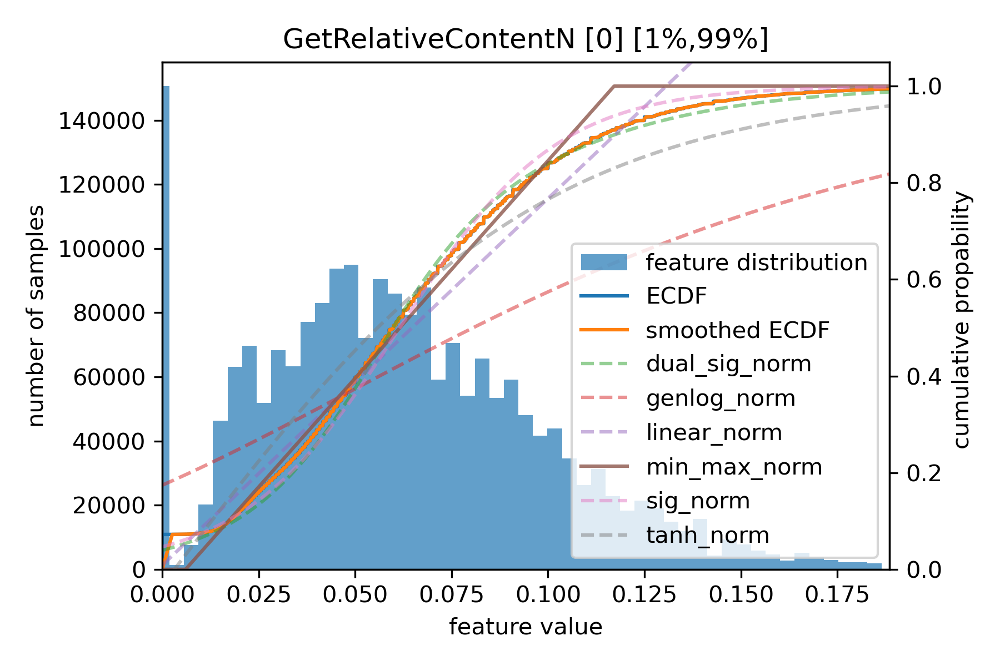

subfeats missing
GetRelativeContentNa_Featurizer
gen smooth ecdf for GetRelativeContentNa_Featurizer[0]
2 2
3 3
fit GetRelativeContentNa_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99


/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


fit GetRelativeContentNa_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentNa_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentNa_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentNa_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetRelativeContentNa_Featurizer_0 with min_max_norm using manual_1_99
fit GetRelativeContentNa_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentNa_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99
gen full ecdf for GetRelativeContentNa_Featurizer[0]


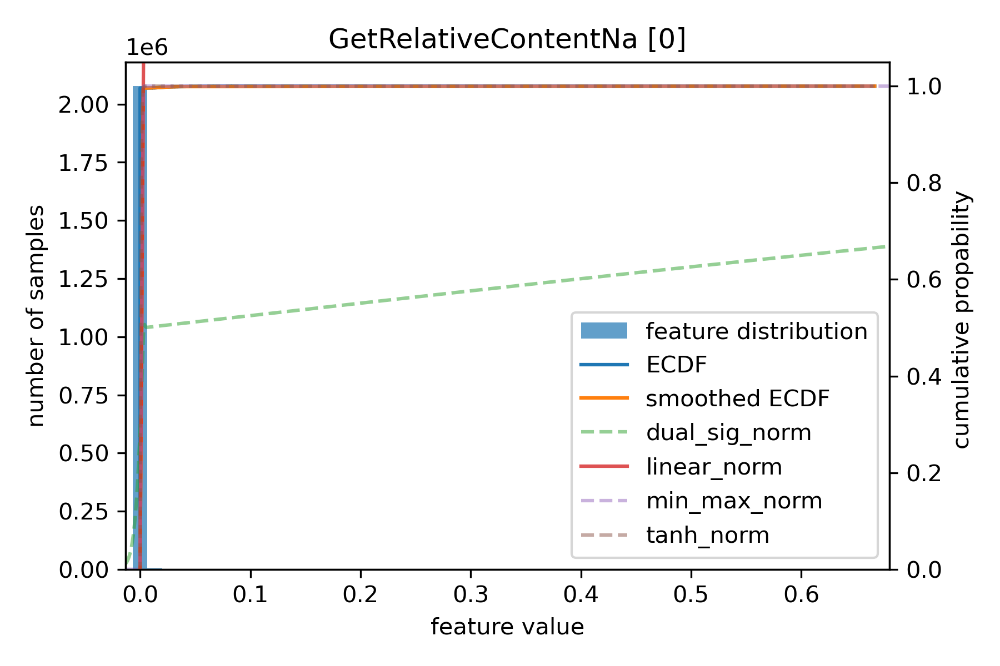

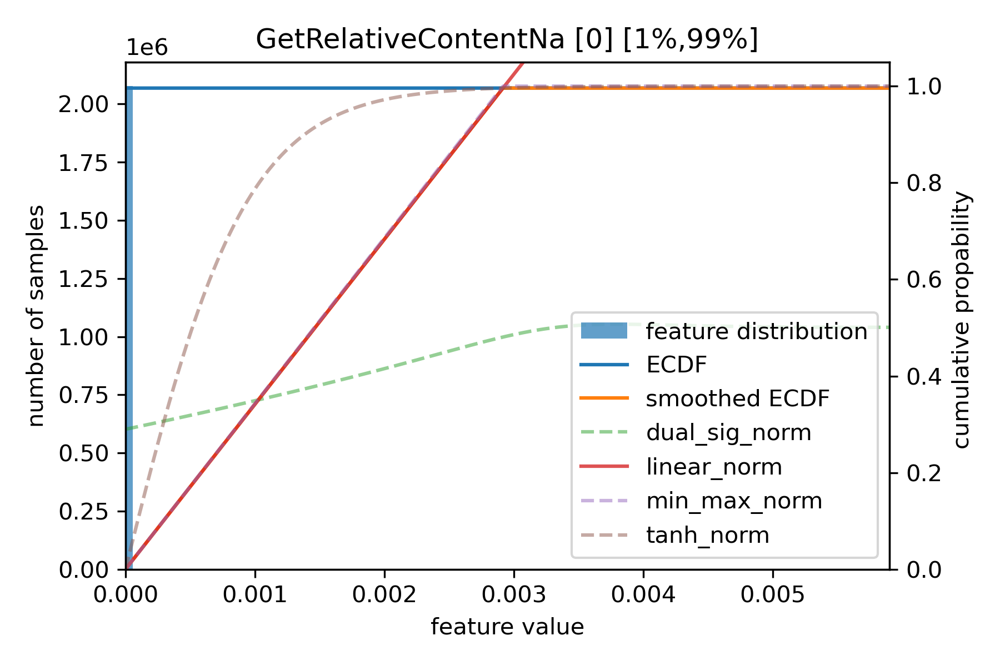

subfeats missing
GetRelativeContentNb_Featurizer
gen smooth ecdf for GetRelativeContentNb_Featurizer[0]
cannot create ecdf for GetRelativeContentNb_Featurizer_0
subfeats missing
GetRelativeContentNd_Featurizer
gen smooth ecdf for GetRelativeContentNd_Featurizer[0]
cannot create ecdf for GetRelativeContentNd_Featurizer_0
subfeats missing
GetRelativeContentNe_Featurizer
gen smooth ecdf for GetRelativeContentNe_Featurizer[0]
cannot create ecdf for GetRelativeContentNe_Featurizer_0
subfeats missing
GetRelativeContentNh_Featurizer
gen smooth ecdf for GetRelativeContentNh_Featurizer[0]
cannot create ecdf for GetRelativeContentNh_Featurizer_0
subfeats missing
GetRelativeContentNi_Featurizer
gen smooth ecdf for GetRelativeContentNi_Featurizer[0]
cannot create ecdf for GetRelativeContentNi_Featurizer_0
subfeats missing
GetRelativeContentNo_Featurizer
gen smooth ecdf for GetRelativeContentNo_Featurizer[0]
cannot create ecdf for GetRelativeContentNo_Featurizer_0
subfeats missing
GetRelativeConten

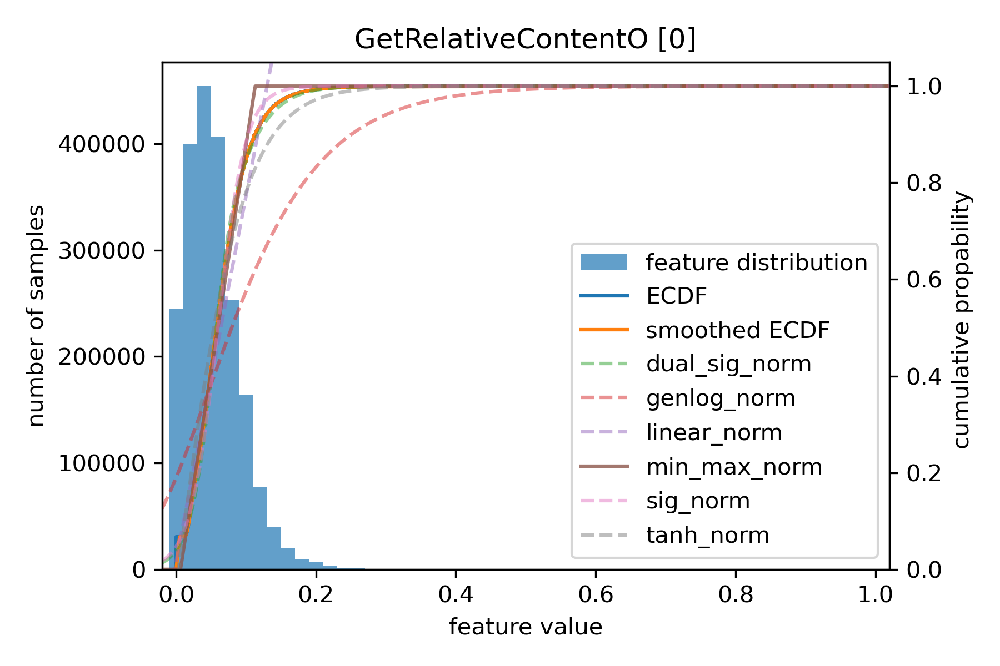

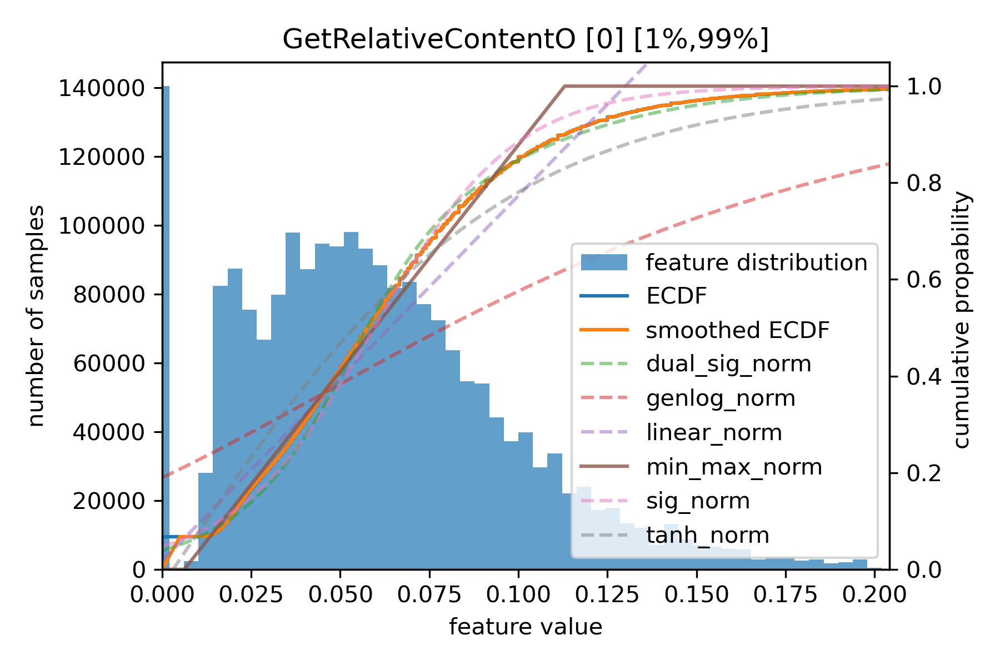

subfeats missing
GetRelativeContentOg_Featurizer
gen smooth ecdf for GetRelativeContentOg_Featurizer[0]
cannot create ecdf for GetRelativeContentOg_Featurizer_0
subfeats missing
GetRelativeContentOs_Featurizer
gen smooth ecdf for GetRelativeContentOs_Featurizer[0]
cannot create ecdf for GetRelativeContentOs_Featurizer_0
subfeats missing
GetRelativeContentP_Featurizer
gen smooth ecdf for GetRelativeContentP_Featurizer[0]
9 9
13 13
fit GetRelativeContentP_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentP_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentP_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentP_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentP_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetRelativeContentP_Featurizer_0 with min_max_norm using manual_1_99
fit GetRelativeContentP_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetRelativeC

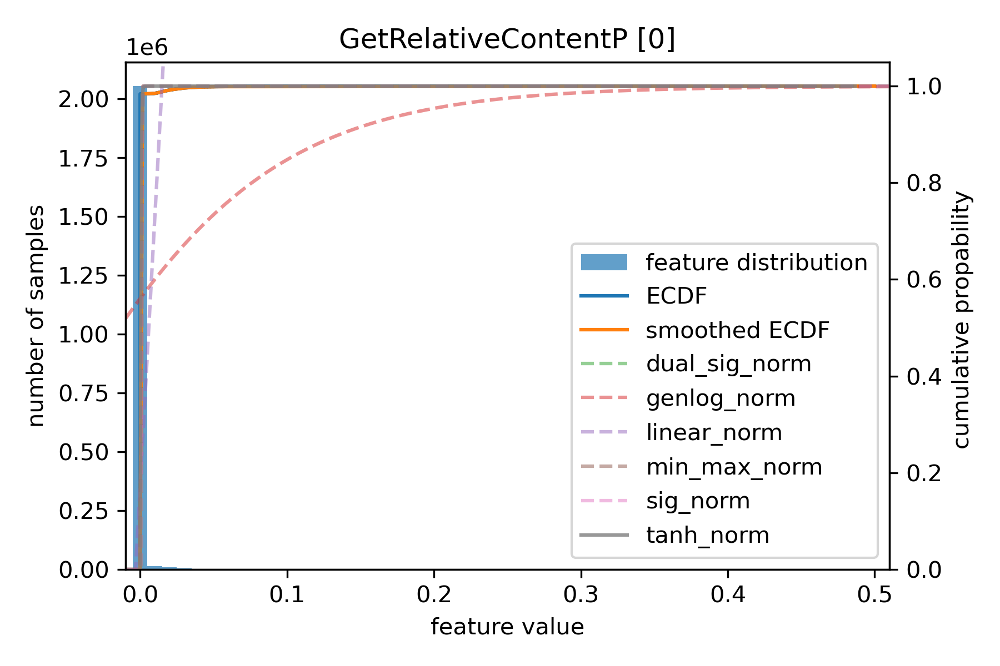

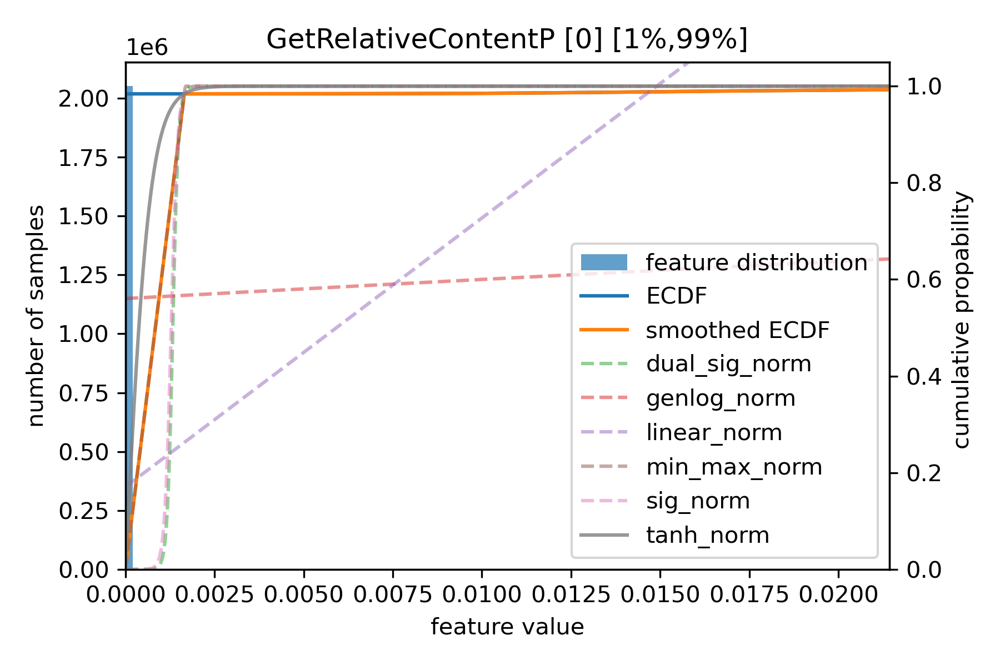

subfeats missing
GetRelativeContentPa_Featurizer
gen smooth ecdf for GetRelativeContentPa_Featurizer[0]
cannot create ecdf for GetRelativeContentPa_Featurizer_0
subfeats missing
GetRelativeContentPb_Featurizer
gen smooth ecdf for GetRelativeContentPb_Featurizer[0]
cannot create ecdf for GetRelativeContentPb_Featurizer_0
subfeats missing
GetRelativeContentPd_Featurizer
gen smooth ecdf for GetRelativeContentPd_Featurizer[0]
cannot create ecdf for GetRelativeContentPd_Featurizer_0
subfeats missing
GetRelativeContentPm_Featurizer
gen smooth ecdf for GetRelativeContentPm_Featurizer[0]
cannot create ecdf for GetRelativeContentPm_Featurizer_0
subfeats missing
GetRelativeContentPo_Featurizer
gen smooth ecdf for GetRelativeContentPo_Featurizer[0]
cannot create ecdf for GetRelativeContentPo_Featurizer_0
subfeats missing
GetRelativeContentPr_Featurizer
gen smooth ecdf for GetRelativeContentPr_Featurizer[0]
cannot create ecdf for GetRelativeContentPr_Featurizer_0
subfeats missing
GetRelativeConten

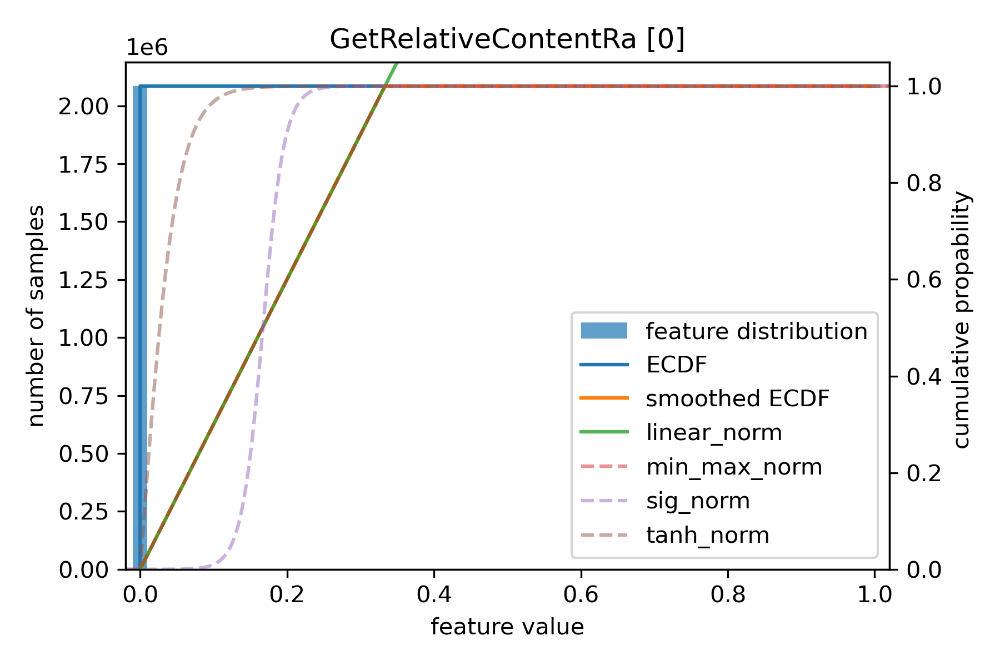

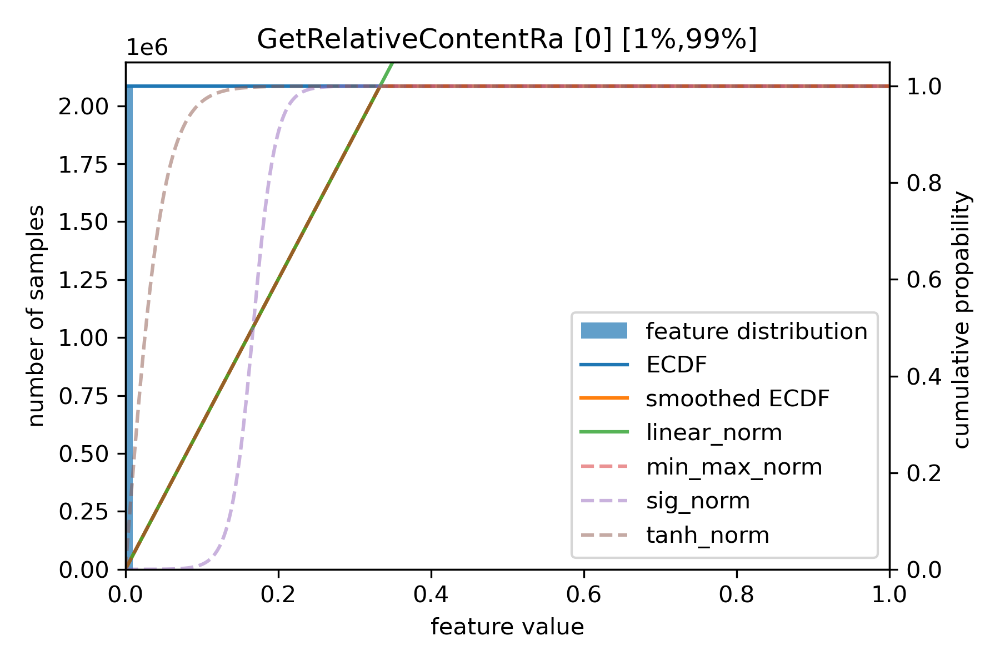

subfeats missing
GetRelativeContentRb_Featurizer
gen smooth ecdf for GetRelativeContentRb_Featurizer[0]
2 2
3 3
fit GetRelativeContentRb_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99


/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


fit GetRelativeContentRb_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentRb_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentRb_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentRb_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetRelativeContentRb_Featurizer_0 with min_max_norm using manual_1_99
fit GetRelativeContentRb_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentRb_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99
gen full ecdf for GetRelativeContentRb_Featurizer[0]


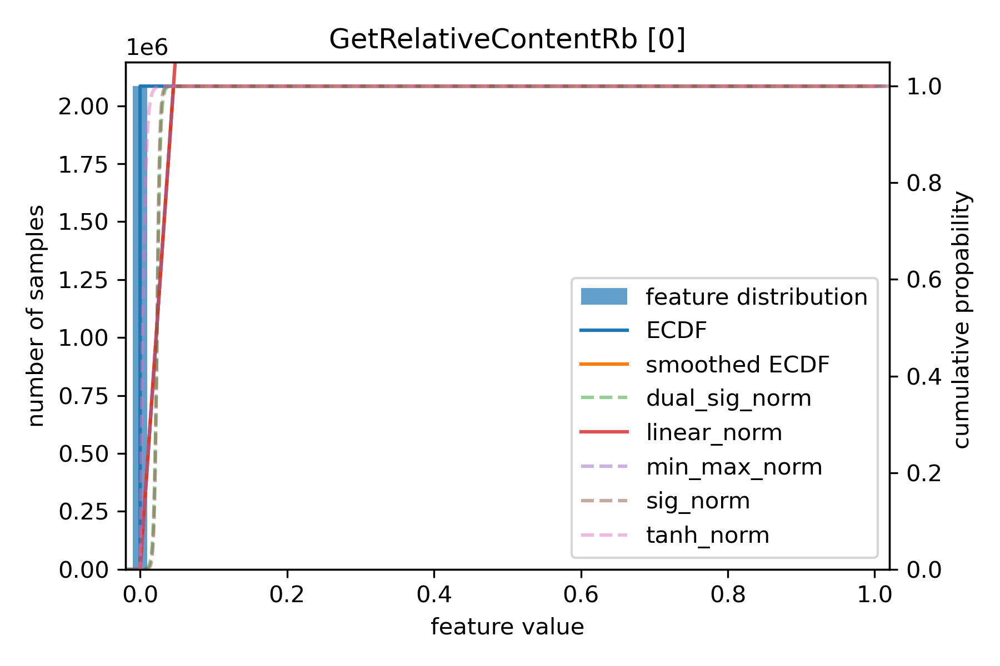

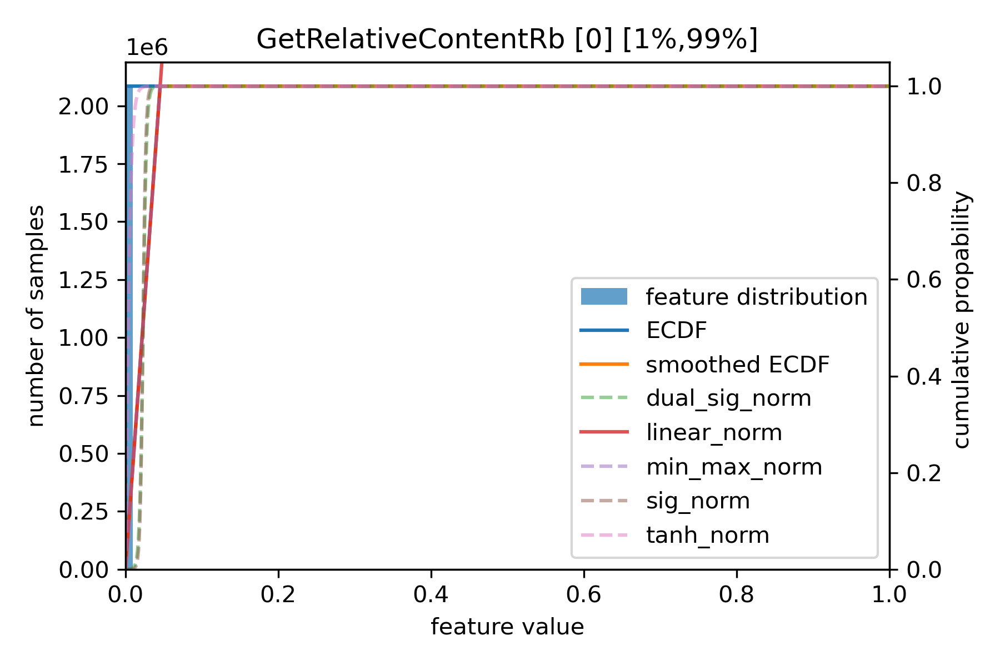

subfeats missing
GetRelativeContentRe_Featurizer
gen smooth ecdf for GetRelativeContentRe_Featurizer[0]
cannot create ecdf for GetRelativeContentRe_Featurizer_0
subfeats missing
GetRelativeContentRf_Featurizer
gen smooth ecdf for GetRelativeContentRf_Featurizer[0]
cannot create ecdf for GetRelativeContentRf_Featurizer_0
subfeats missing
GetRelativeContentRg_Featurizer
gen smooth ecdf for GetRelativeContentRg_Featurizer[0]
cannot create ecdf for GetRelativeContentRg_Featurizer_0
subfeats missing
GetRelativeContentRh_Featurizer
gen smooth ecdf for GetRelativeContentRh_Featurizer[0]
cannot create ecdf for GetRelativeContentRh_Featurizer_0
subfeats missing
GetRelativeContentRn_Featurizer
gen smooth ecdf for GetRelativeContentRn_Featurizer[0]
cannot create ecdf for GetRelativeContentRn_Featurizer_0
subfeats missing
GetRelativeContentRu_Featurizer
gen smooth ecdf for GetRelativeContentRu_Featurizer[0]
cannot create ecdf for GetRelativeContentRu_Featurizer_0
subfeats missing
GetRelativeConten

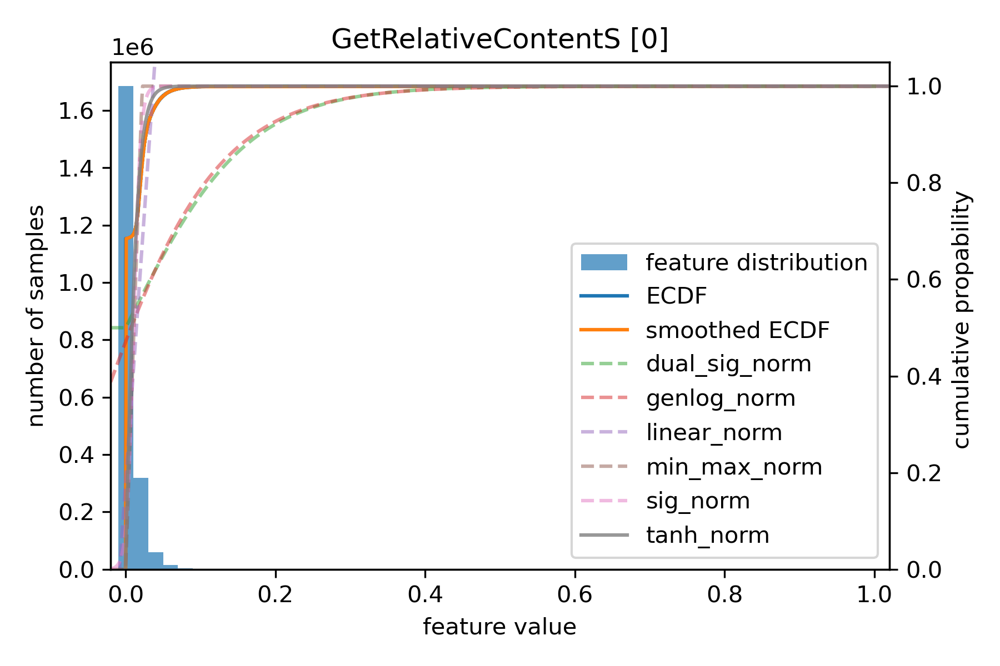

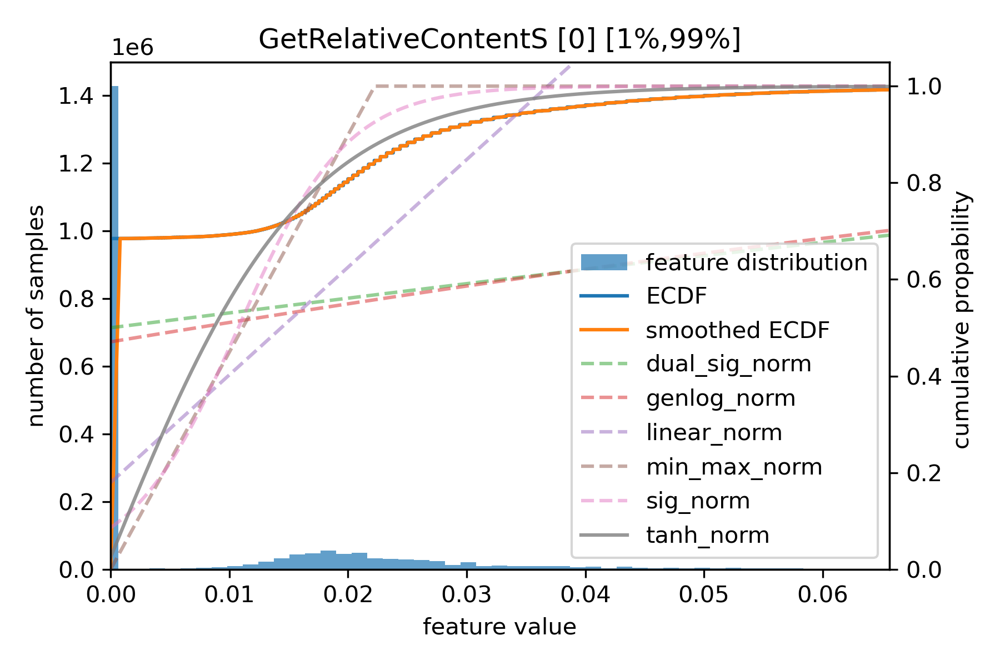

subfeats missing
GetRelativeContentSb_Featurizer
gen smooth ecdf for GetRelativeContentSb_Featurizer[0]
cannot create ecdf for GetRelativeContentSb_Featurizer_0
subfeats missing
GetRelativeContentSc_Featurizer
gen smooth ecdf for GetRelativeContentSc_Featurizer[0]
cannot create ecdf for GetRelativeContentSc_Featurizer_0
subfeats missing
GetRelativeContentSe_Featurizer
gen smooth ecdf for GetRelativeContentSe_Featurizer[0]
2 2
3 3
fit GetRelativeContentSe_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99


/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


fit GetRelativeContentSe_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentSe_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentSe_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentSe_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetRelativeContentSe_Featurizer_0 with min_max_norm using manual_1_99
fit GetRelativeContentSe_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentSe_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99
gen full ecdf for GetRelativeContentSe_Featurizer[0]


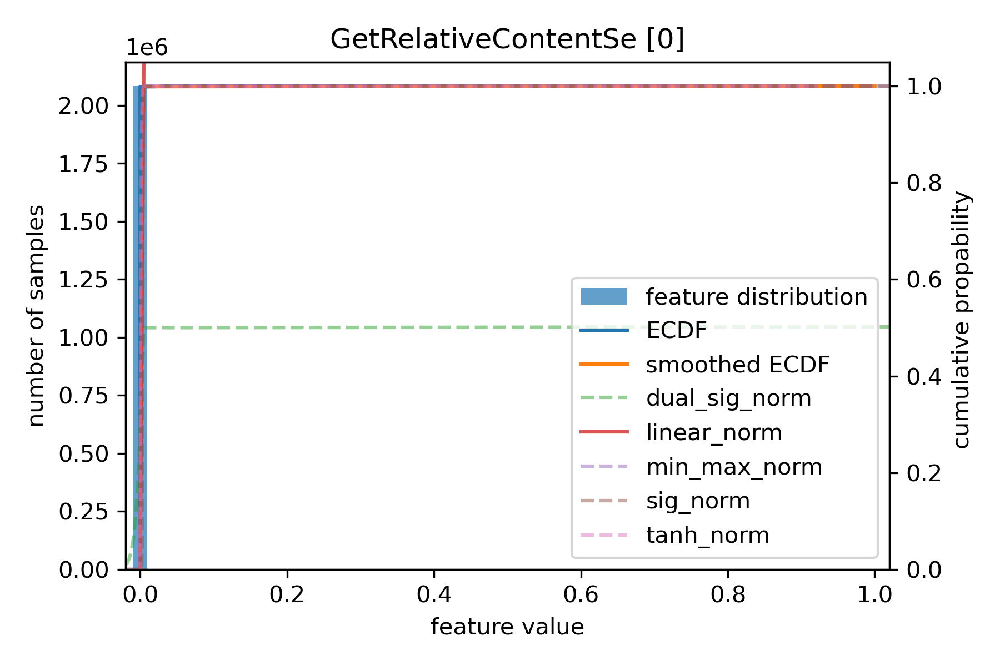

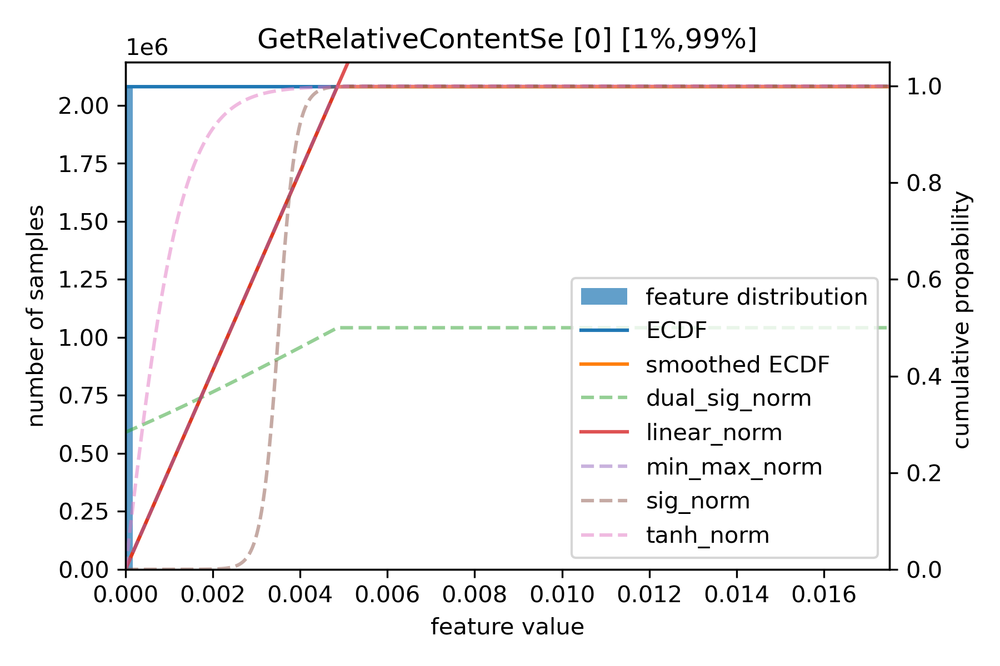

subfeats missing
GetRelativeContentSg_Featurizer
gen smooth ecdf for GetRelativeContentSg_Featurizer[0]
cannot create ecdf for GetRelativeContentSg_Featurizer_0
subfeats missing
GetRelativeContentSi_Featurizer
gen smooth ecdf for GetRelativeContentSi_Featurizer[0]
2 2
3 3
fit GetRelativeContentSi_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99


/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


fit GetRelativeContentSi_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentSi_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentSi_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentSi_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetRelativeContentSi_Featurizer_0 with min_max_norm using manual_1_99
fit GetRelativeContentSi_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentSi_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99
gen full ecdf for GetRelativeContentSi_Featurizer[0]


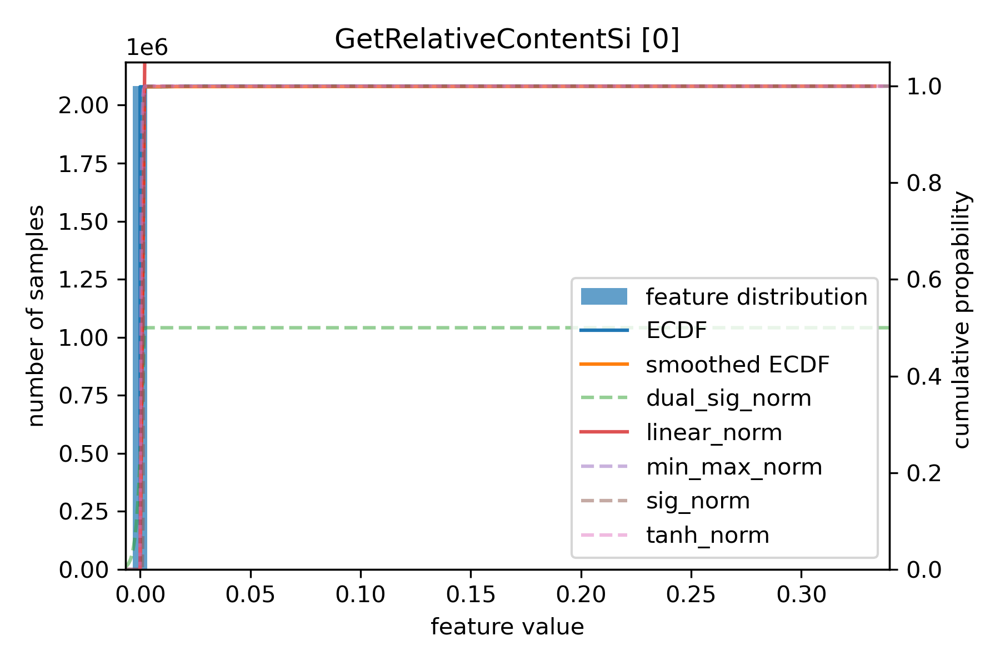

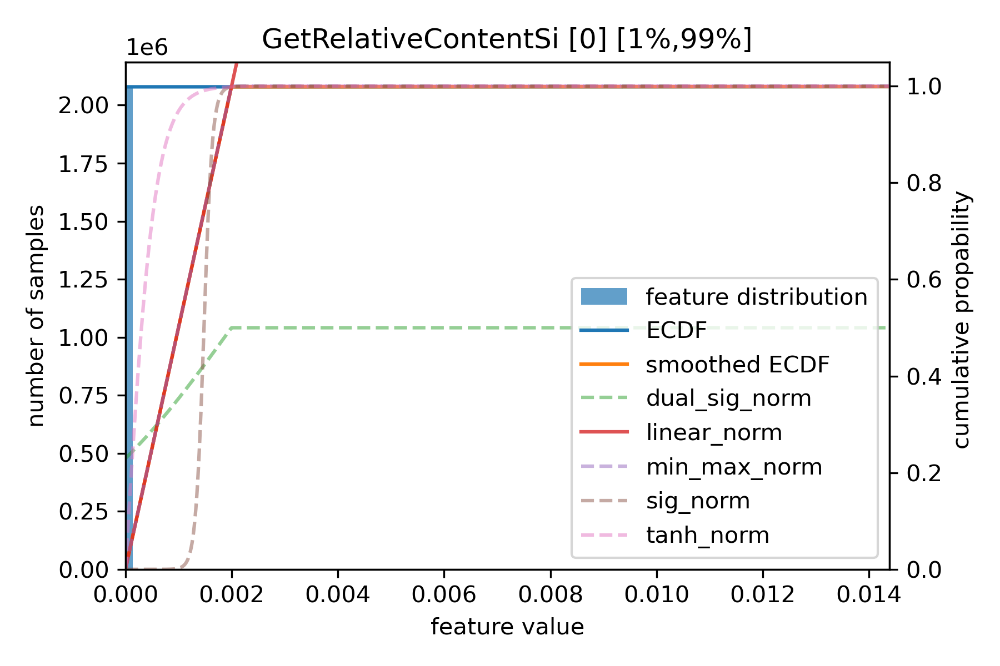

subfeats missing
GetRelativeContentSm_Featurizer
gen smooth ecdf for GetRelativeContentSm_Featurizer[0]
cannot create ecdf for GetRelativeContentSm_Featurizer_0
subfeats missing
GetRelativeContentSn_Featurizer
gen smooth ecdf for GetRelativeContentSn_Featurizer[0]
cannot create ecdf for GetRelativeContentSn_Featurizer_0
subfeats missing
GetRelativeContentSr_Featurizer
gen smooth ecdf for GetRelativeContentSr_Featurizer[0]
2 2
3 3
fit GetRelativeContentSr_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99


/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


fit GetRelativeContentSr_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentSr_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentSr_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentSr_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetRelativeContentSr_Featurizer_0 with min_max_norm using manual_1_99
fit GetRelativeContentSr_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentSr_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99
gen full ecdf for GetRelativeContentSr_Featurizer[0]


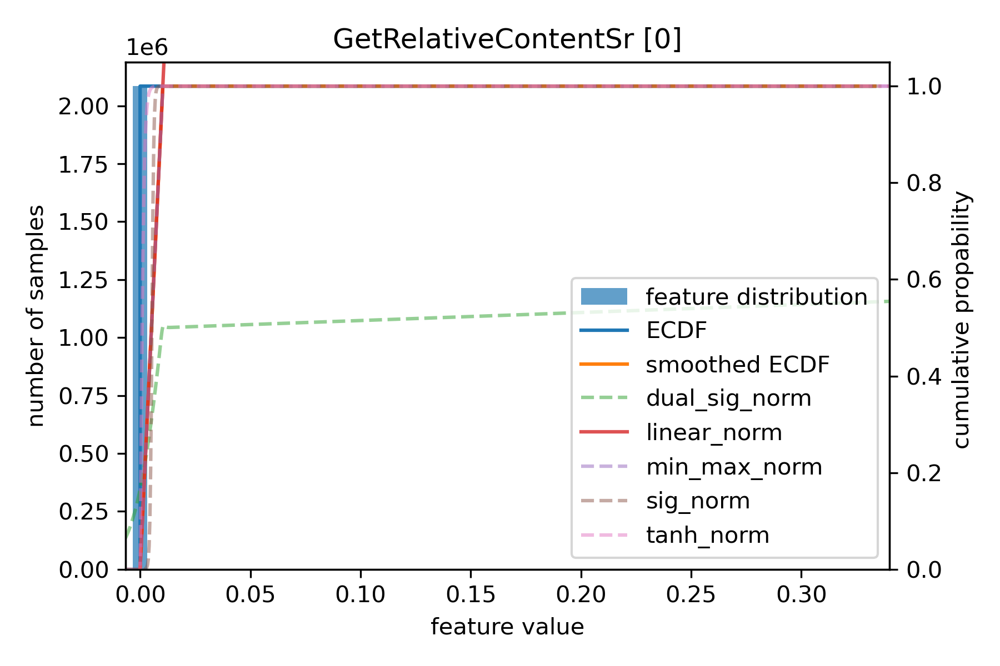

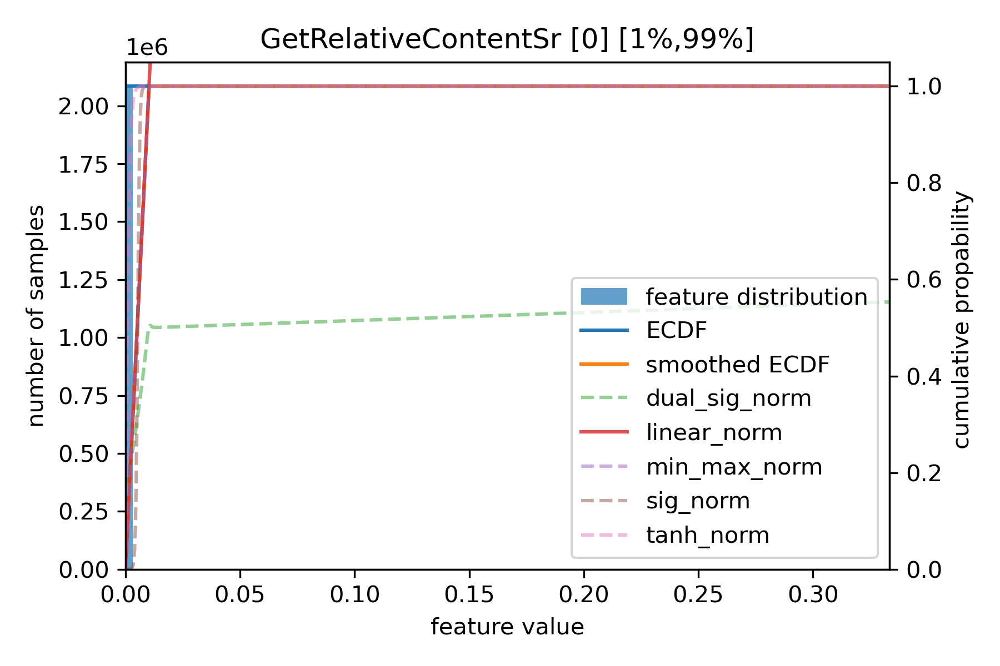

subfeats missing
GetRelativeContentTa_Featurizer
gen smooth ecdf for GetRelativeContentTa_Featurizer[0]
cannot create ecdf for GetRelativeContentTa_Featurizer_0
subfeats missing
GetRelativeContentTb_Featurizer
gen smooth ecdf for GetRelativeContentTb_Featurizer[0]
cannot create ecdf for GetRelativeContentTb_Featurizer_0
subfeats missing
GetRelativeContentTc_Featurizer
gen smooth ecdf for GetRelativeContentTc_Featurizer[0]
cannot create ecdf for GetRelativeContentTc_Featurizer_0
subfeats missing
GetRelativeContentTe_Featurizer
gen smooth ecdf for GetRelativeContentTe_Featurizer[0]
2 2
3 3
fit GetRelativeContentTe_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentTe_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentTe_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentTe_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentTe_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
f

/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


gen full ecdf for GetRelativeContentTe_Featurizer[0]


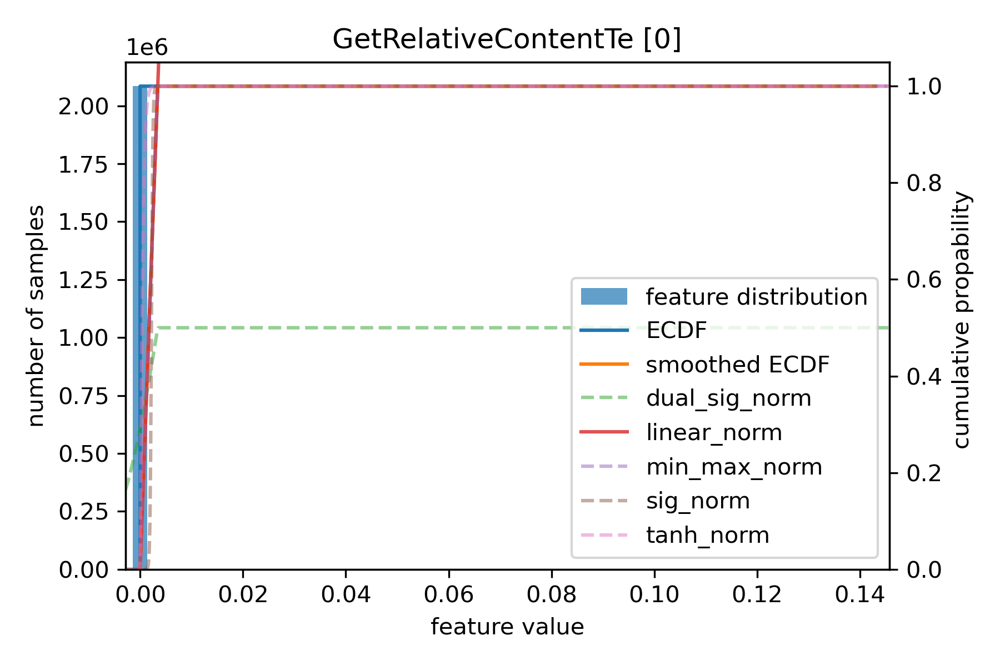

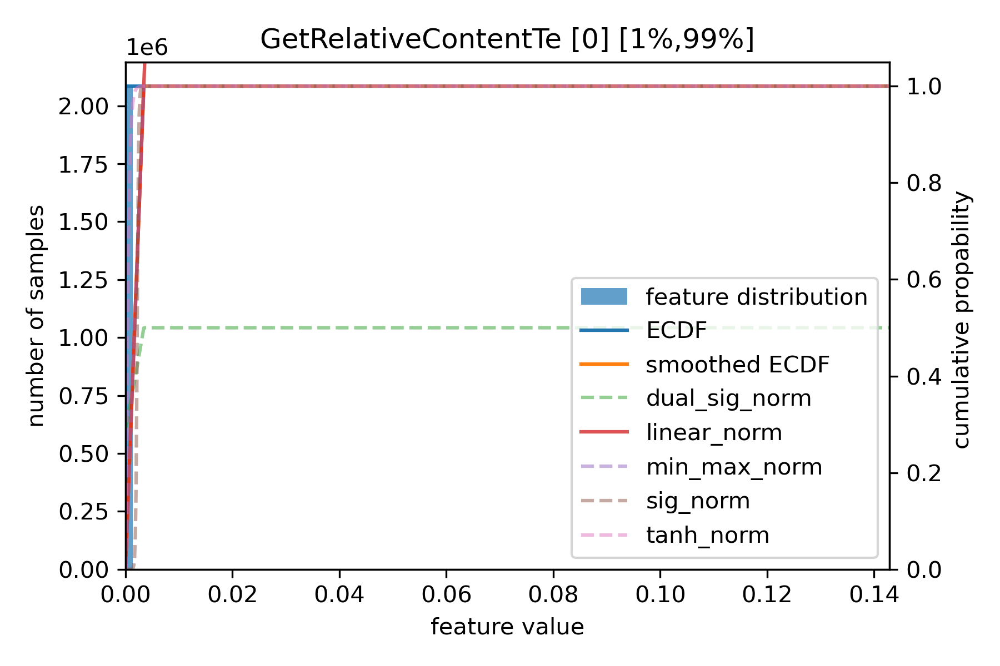

subfeats missing
GetRelativeContentTh_Featurizer
gen smooth ecdf for GetRelativeContentTh_Featurizer[0]
cannot create ecdf for GetRelativeContentTh_Featurizer_0
subfeats missing
GetRelativeContentTi_Featurizer
gen smooth ecdf for GetRelativeContentTi_Featurizer[0]
cannot create ecdf for GetRelativeContentTi_Featurizer_0
subfeats missing
GetRelativeContentTl_Featurizer
gen smooth ecdf for GetRelativeContentTl_Featurizer[0]
cannot create ecdf for GetRelativeContentTl_Featurizer_0
subfeats missing
GetRelativeContentTm_Featurizer
gen smooth ecdf for GetRelativeContentTm_Featurizer[0]
cannot create ecdf for GetRelativeContentTm_Featurizer_0
subfeats missing
GetRelativeContentTs_Featurizer
gen smooth ecdf for GetRelativeContentTs_Featurizer[0]
cannot create ecdf for GetRelativeContentTs_Featurizer_0
subfeats missing
GetRelativeContentU_Featurizer
gen smooth ecdf for GetRelativeContentU_Featurizer[0]
cannot create ecdf for GetRelativeContentU_Featurizer_0
subfeats missing
GetRelativeContentV_

/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:170: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:184: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:187: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


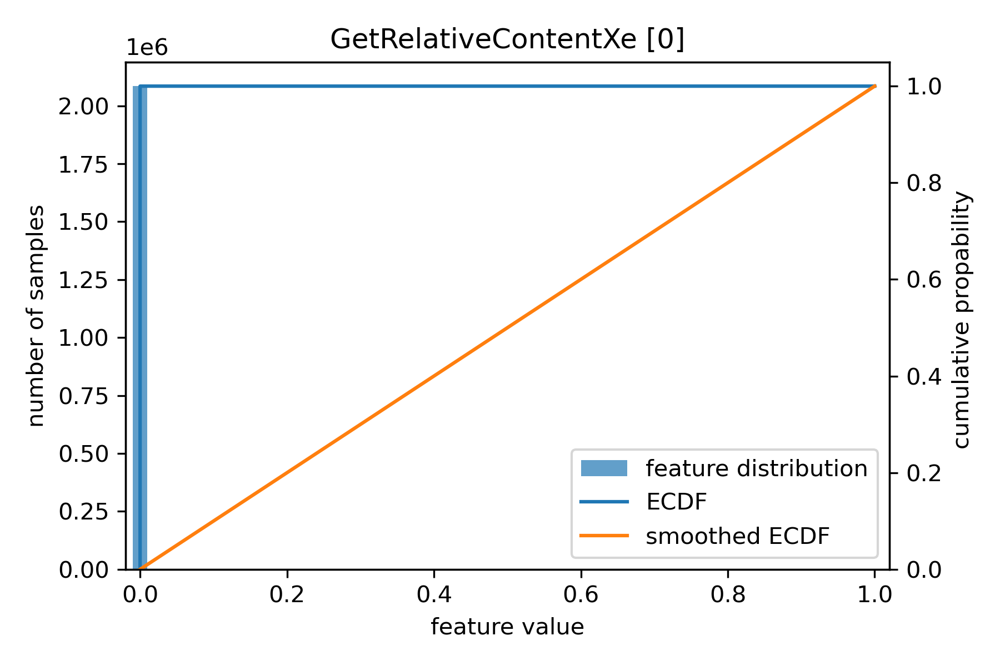

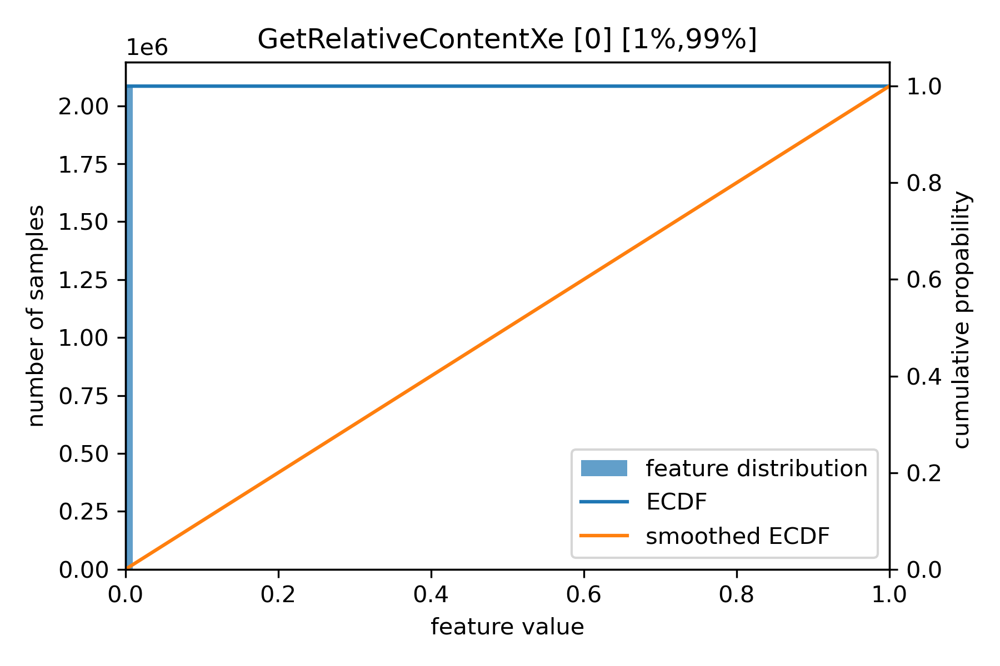

subfeats missing
GetRelativeContentY_Featurizer
gen smooth ecdf for GetRelativeContentY_Featurizer[0]
cannot create ecdf for GetRelativeContentY_Featurizer_0
subfeats missing
GetRelativeContentYb_Featurizer
gen smooth ecdf for GetRelativeContentYb_Featurizer[0]
cannot create ecdf for GetRelativeContentYb_Featurizer_0
subfeats missing
GetRelativeContentZn_Featurizer
gen smooth ecdf for GetRelativeContentZn_Featurizer[0]
2 2
3 3
fit GetRelativeContentZn_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99


/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


fit GetRelativeContentZn_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetRelativeContentZn_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetRelativeContentZn_Featurizer_0 with linear_norm using manual_1_99
fit GetRelativeContentZn_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetRelativeContentZn_Featurizer_0 with min_max_norm using manual_1_99
fit GetRelativeContentZn_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetRelativeContentZn_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99
gen full ecdf for GetRelativeContentZn_Featurizer[0]


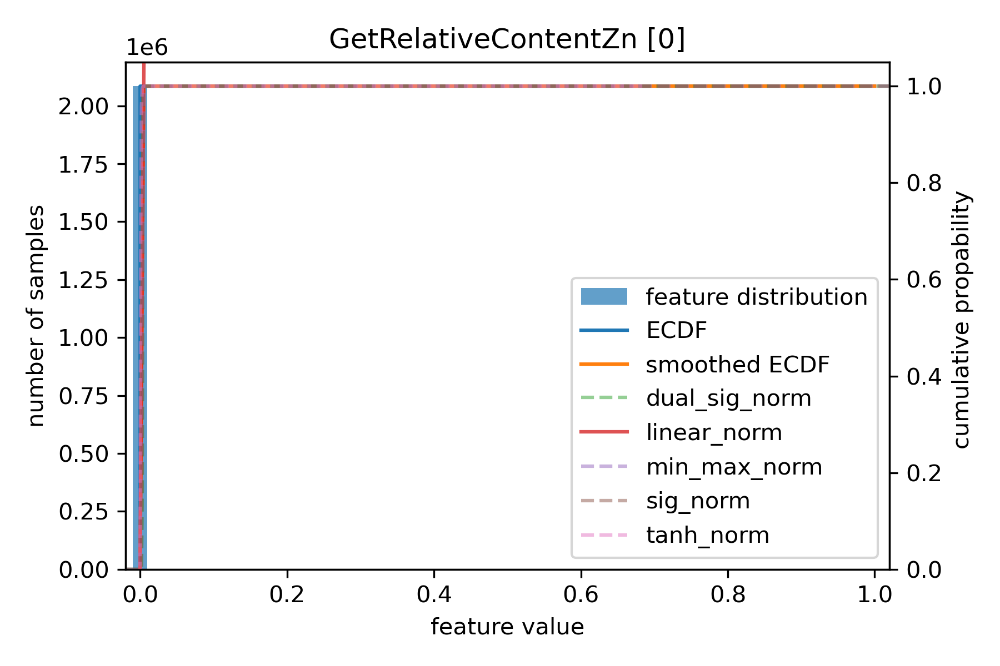

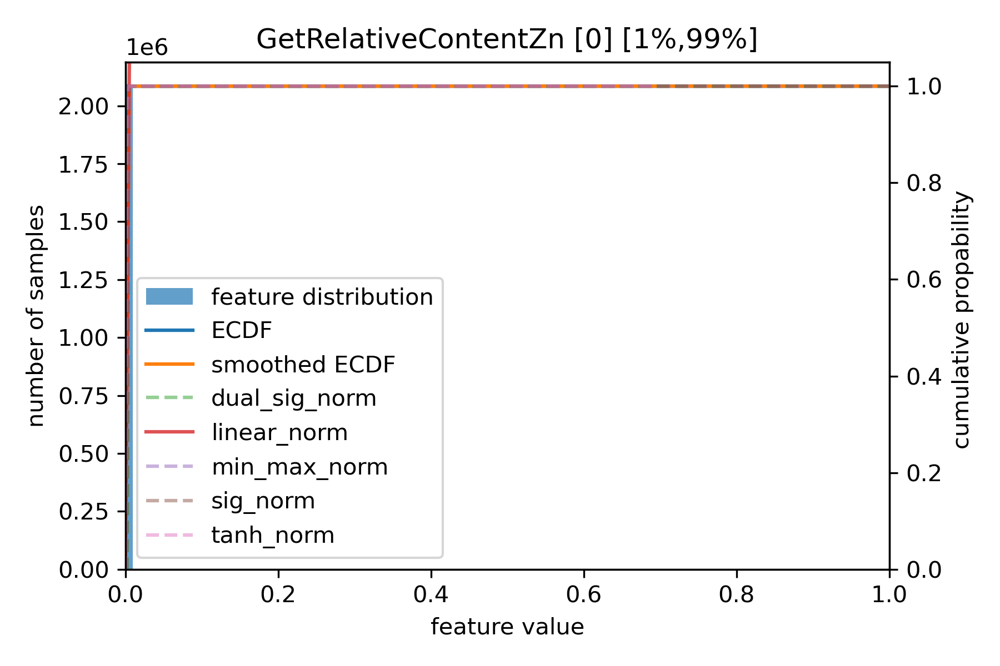

subfeats missing
GetRelativeContentZr_Featurizer
gen smooth ecdf for GetRelativeContentZr_Featurizer[0]
cannot create ecdf for GetRelativeContentZr_Featurizer_0
subfeats missing
GetSSSR_Featurizer
gen smooth ecdf for GetSSSR_Featurizer[0]
10 10
15 15
fit GetSSSR_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit GetSSSR_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit GetSSSR_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit GetSSSR_Featurizer_0 with linear_norm using manual_1_99
fit GetSSSR_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit GetSSSR_Featurizer_0 with min_max_norm using manual_1_99
fit GetSSSR_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit GetSSSR_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99
gen full ecdf for GetSSSR_Featurizer[0]


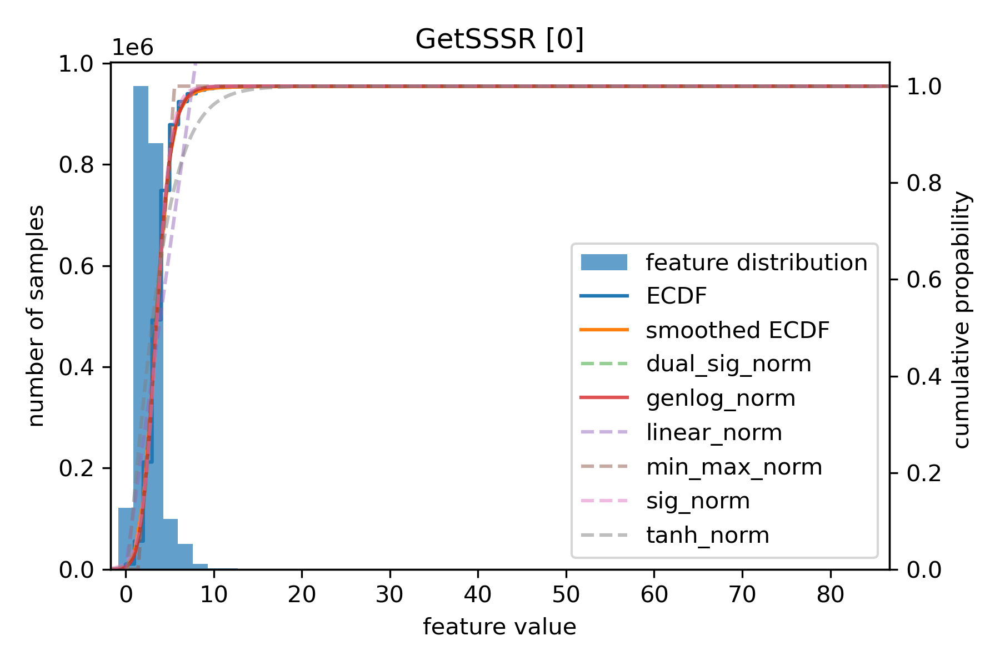

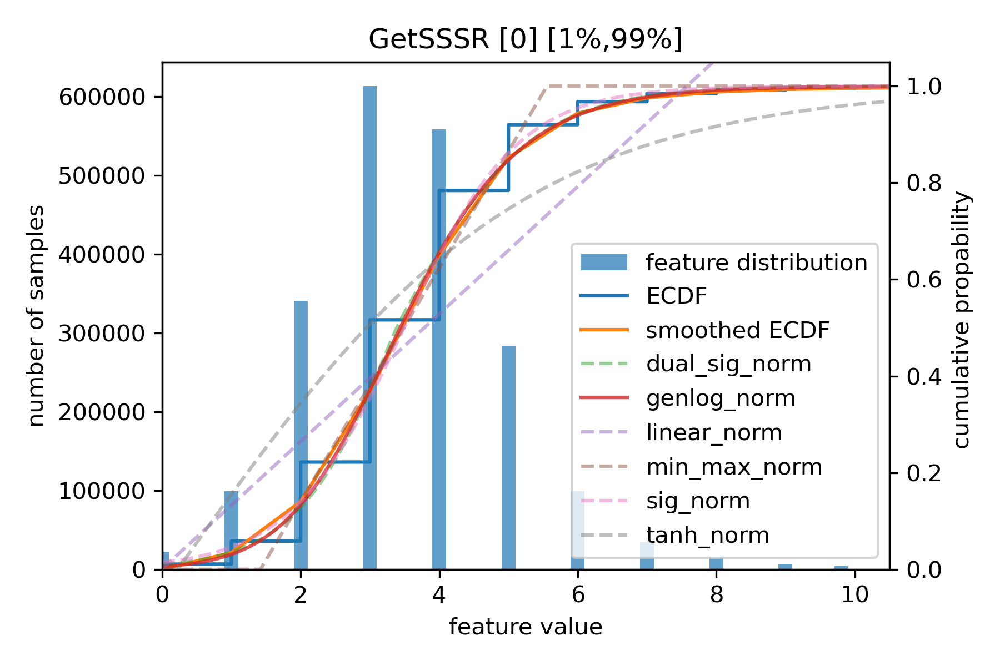

subfeats missing
HallKierAlpha_Featurizer
gen smooth ecdf for HallKierAlpha_Featurizer[0]
834 834
1251 1251
fit HallKierAlpha_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit HallKierAlpha_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit HallKierAlpha_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit HallKierAlpha_Featurizer_0 with linear_norm using manual_1_99
fit HallKierAlpha_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit HallKierAlpha_Featurizer_0 with min_max_norm using manual_1_99
fit HallKierAlpha_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit HallKierAlpha_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99
gen full ecdf for HallKierAlpha_Featurizer[0]


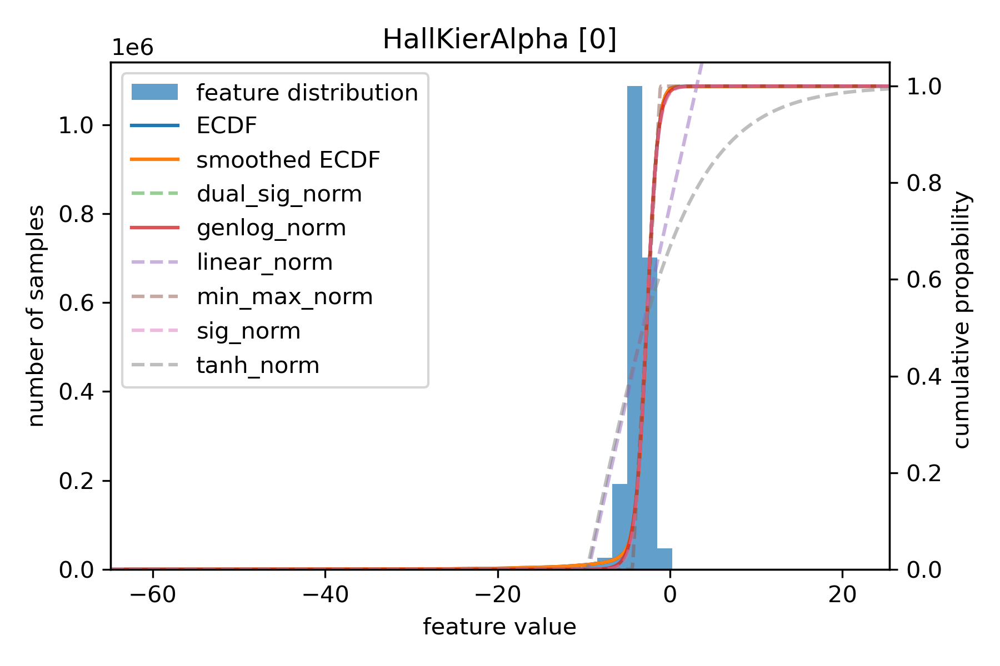

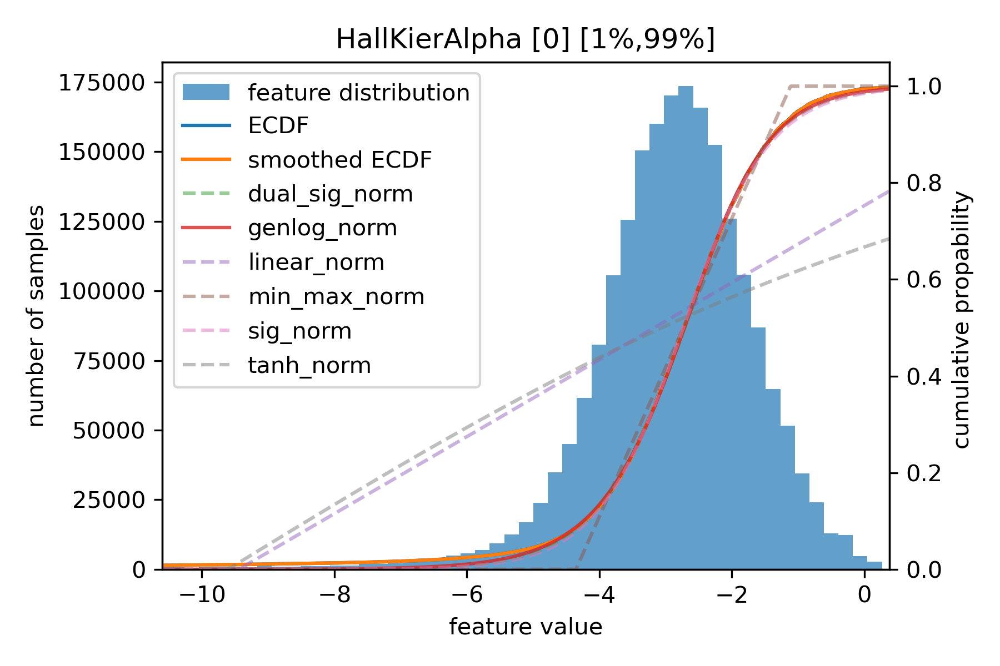

subfeats missing
HeavyAtomCount_Featurizer
gen smooth ecdf for HeavyAtomCount_Featurizer[0]
69 69
103 103
fit HeavyAtomCount_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit HeavyAtomCount_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit HeavyAtomCount_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit HeavyAtomCount_Featurizer_0 with linear_norm using manual_1_99
fit HeavyAtomCount_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99
fit HeavyAtomCount_Featurizer_0 with min_max_norm using manual_1_99
fit HeavyAtomCount_Featurizer_0 with sig_norm using scipy_curve_fit_1_99
fit HeavyAtomCount_Featurizer_0 with tanh_norm using scipy_curve_fit_1_99


/home/julian/anaconda3/envs/graph_chem_unit/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


gen full ecdf for HeavyAtomCount_Featurizer[0]


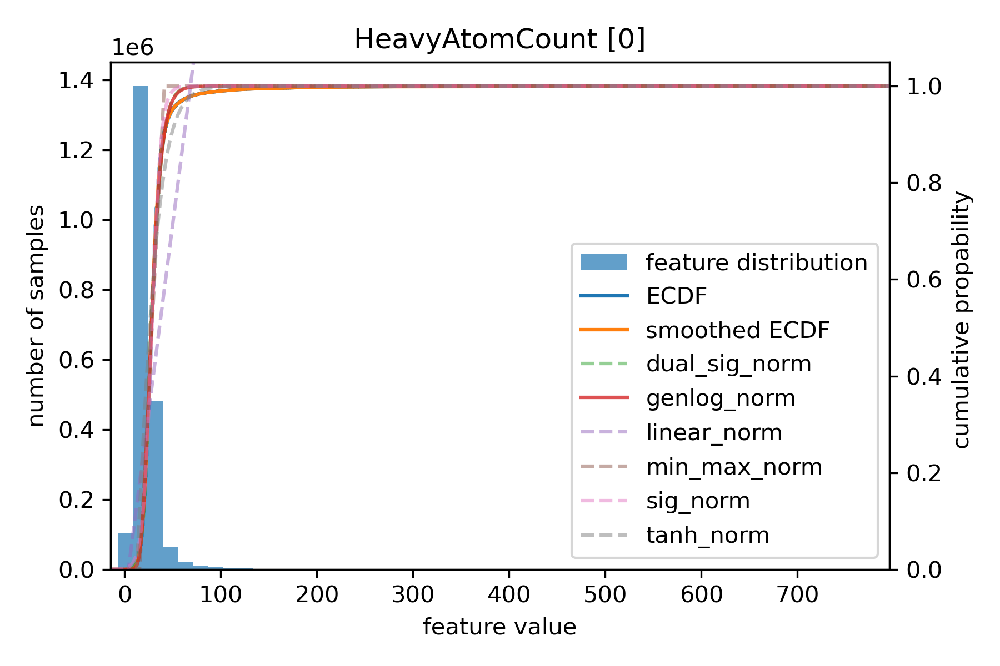

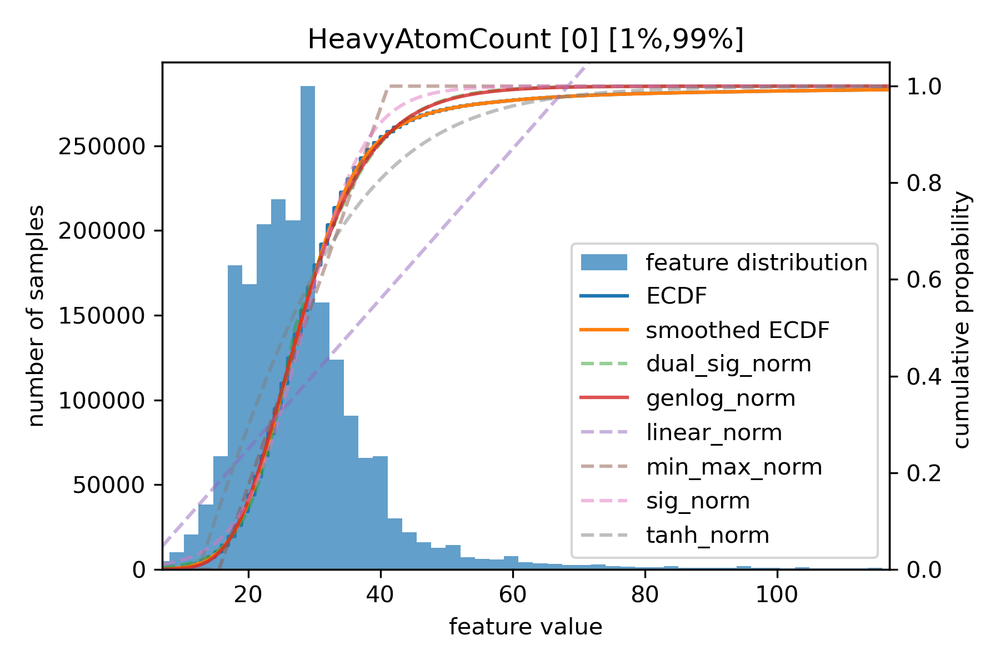

subfeats missing
HeavyAtomMolWt_Featurizer
gen smooth ecdf for HeavyAtomMolWt_Featurizer[0]
981 981
1471 1471
fit HeavyAtomMolWt_Featurizer_0 with dual_sig_norm using scipy_curve_fit_1_99
fit HeavyAtomMolWt_Featurizer_0 with genlog_norm using scipy_curve_fit_1_99
fit HeavyAtomMolWt_Featurizer_0 with linear_norm using scipy_curve_fit_1_99
fit HeavyAtomMolWt_Featurizer_0 with linear_norm using manual_1_99
fit HeavyAtomMolWt_Featurizer_0 with min_max_norm using scipy_curve_fit_1_99


ZeroDivisionError: division by zero

In [23]:
REFIT=False
for f,eg in egs.items():
    #if not "GetNumberAtomsAm" in str(eg):
    #    continue
    #break
    info=get_info(f)
    all_done=True and not REFIT
    if all_done:
        if 'shape' in info:
            dims=info["shape"][0]
            for i in range(dims):
                if "subfeats" not in info:
                    print(f"subfeats missing")
                    all_done=False
                    break
                if str(i) not in info["subfeats"]:
                    print(f"subfeats {i} missing")
                    all_done=False
                    break
                sub_info = info["subfeats"][str(i)]
                if "fits" not in sub_info:
                    print(f"fits {i} missing")
                    all_done=False
                    break
                for nf in ["scipy_curve_fit_1_99","manual_1_99"]:
                    if nf not in sub_info["fits"]:
                        print(f"fits {i} {nf} missing")
                        all_done=False
                        break
                if not all_done:
                    break

                for p in fit_norm_classic_p:
                    if p  not in sub_info["fits"]["manual_1_99"]:
                        print(f"fits {i} {p} missing")
                        all_done=False
                        break
                if not all_done:
                    break

                for p in fit_norm_scipy_curve_p:
                    if p  not in sub_info["fits"]["scipy_curve_fit_1_99"]:
                        print(f"fits {i} {p} missing")
                        all_done=False
                        break
                if not all_done:
                    break

                if not all_done:
                    break

                for p in [
                        os.path.join(eg.dirname, str(eg) + f"_{i}_full_range.png"),
                        os.path.join(eg.dirname, str(eg) + f"_{i}_1_99.png")
                    ]:
                    if not os.path.exists(p):
                        print(f"full image {i} missing")
                        all_done=False
                if not all_done:
                    break


        else:
            print("shape missing")
            all_done=False

    if all_done:
        #display(Image(imgpath,width=200))
        
        for i in range(dims):
            for p in [
                   os.path.join(eg.dirname, str(eg) + f"_{i}_full_range.png"),
                   os.path.join(eg.dirname, str(eg) + f"_{i}_1_99.png")
                ]:
                continue
                display(Image(p,width=200))
        continue
    #pprint(info)
    
    print(str(eg))
    eg.check_ecdfs()
    
    
    
    if "subfeats" not in info:
        info["subfeats"]={}
    for ecdf in eg.ecdfs:
        redraw=True
        fit_changed=False or REFIT
        
        dist_data=ecdf.dist_data
        dist_data=dist_data[np.isfinite(dist_data)]
        secfdx,secfdy = ecdf.smooth_ecdf
        if len(secfdx)<=1:
            print(f"cannot create ecdf for {ecdf}")
            continue
        if str(ecdf.n) not in info["subfeats"]:
            info["subfeats"][str(ecdf.n)]={}
        sub_info = info["subfeats"][str(ecdf.n)]
        sub_info["min"]=dist_data.min()
        sub_info["max"]=dist_data.max()
                                            
        eix1 = max(0,(secfdy>=0.01).argmax()-1)
        eix99 = min((secfdy>=0.99).argmax()+1, len(secfdx)-1)
        perc_dev=0.05
        ex1=secfdx[eix1]
        ex99=secfdx[eix99]
        outdiff=(ex99-ex1)*0.05
        ex1=max(sub_info["min"],ex1-outdiff)
        ex99=min(sub_info["max"],ex99+outdiff)
        
        #display(secfdx)
        #display(secfdy)
        #max_x=secfdx.max()
        #min_x=secfdx.min()
        #xlin = np.linspace(min_x,max_x,res)
        #xinds = np.arange(0,len(secfdx))
        #indices=np.unique(np.round(np.interp(xlin, secfdx, xinds)).astype(int))
        #secdf_dragx=secfdx[indices]
        #secdf_dragy= np.gradient(secfdy[indices],secdf_dragx)
        
        if "fits" not in sub_info or fit_changed:
            sub_info["fits"]={}
            fit_changed=True
        #do fits
        fit_x1_99 = secfdx[eix1:eix99]
        fit_y1_99 = secfdy[eix1:eix99]
        print(len(fit_x1_99),len(fit_y1_99))
        fit_x1_99=np.concatenate([
            fit_x1_99,
            fit_x1_99[:1].tolist()*int(0.5*len(fit_x1_99))
        ])
        
        fit_y1_99=np.concatenate([
            fit_y1_99,
            fit_y1_99[:1].tolist()*int(0.5*len(fit_y1_99))
        ])
        print(len(fit_x1_99),len(fit_y1_99))
        
        
        for nf,nfcall in norm_functions.items():
            if "scipy_curve_fit_1_99" not in sub_info["fits"]:
                sub_info["fits"]["scipy_curve_fit_1_99"] = {}
            if nf not in sub_info["fits"]["scipy_curve_fit_1_99"] and nf in fit_norm_scipy_curve_p:
                print(f"fit {ecdf} with {nf} using scipy_curve_fit_1_99")
                fr = fit_norm_scipy_curve(nfcall,fit_x1_99,fit_y1_99)
                if fr is not None:
                    sub_info["fits"]["scipy_curve_fit_1_99"][nf] = fr
                    fit_changed=True
                    
            if "manual_1_99" not in sub_info["fits"]:
                sub_info["fits"]["manual_1_99"] = {}
            if nf not in sub_info["fits"]["manual_1_99"] and nf in fit_norm_classic_p:
                print(f"fit {ecdf} with {nf} using manual_1_99")
                fr=fit_norm_classic(nfcall,fit_x1_99,fit_y1_99)
                if fr is not None:
                    sub_info["fits"]["manual_1_99"][nf] = fr
                    fit_changed=True
        
        if fit_changed:
            redraw = True
            #get best fit per cat
            best_fits={}
            for fitcat, fc in sub_info["fits"].items():
                for fitname,fitddata in fc.items():
                    if fitname in best_fits and fitddata["error"]>=best_fits[fitname]["error"]:
                        continue
                    best_fits[fitname]=fitddata.copy()
                    best_fits[fitname]["fitcat"]=fitcat
            sub_info["fits"]["best_fits"]=best_fits


            #get best fit
            best_fit={"error":np.inf}
            for fitname,fitddata in sub_info["fits"]["best_fits"].items():
                if fitddata["error"]>=best_fit["error"]:
                        continue
                if fitddata["output_range"][0]>0.2 or fitddata["output_range"][1]<0.8:
                    continue
                best_fit=fitddata.copy()
                best_fit["fitname"]=fitname
            sub_info["best_fit"]=best_fit
            
        
        #print(indices)
        
        
        #secdf_dragy=np.array([a.mean() for a in np.array_split(ecdf_drag,indices[1:])])
        #secdf_dragx=np.array([a.min() for a in np.array_split(secfdx,indices)[1:]])
        
        title=str(ecdf).replace("_Featurizer_","_").split("_")
        title=" ".join(title[:-1])+f" [{title[-1]}]"
        deltaminmax=secfdx.max()-secfdx.min()
        
        for lower_x_lim, upper_x_lim,t,imgpath in [
            [secfdx.min()-deltaminmax*0.02,secfdx.max()+deltaminmax*0.02,title,os.path.join(ecdf.dirname, str(ecdf) + "_full_range.png")],
            [ex1,ex99,title+" [1%,99%]",os.path.join(ecdf.dirname, str(ecdf) + "_1_99.png")]
        ]:
            if not os.path.exists(imgpath) or redraw:
                x_range=np.linspace(lower_x_lim,upper_x_lim,1000)
                
                fig, ax1 = plt.subplots()
                labelplots=[]
                ax2 = ax1.twinx() 
                histn, edges = np.histogram(dist_data[(dist_data>=lower_x_lim) & (dist_data<=upper_x_lim)], bins=50)

                labels=edges[1:]-np.diff(edges)
                lns1 = ax1.bar(labels, histn,width=edges[1]-edges[0], align='center',
                              alpha=0.7
                              )

                labelplots.extend(
                    ax2.plot(*ecdf.full_ecdf,label="ECDF")
                )

                labelplots.extend(
                   ax2.plot(secfdx,secfdy,label="smoothed ECDF")
                )

                for fitname,fitddata in sub_info["fits"]["best_fits"].items():
                    if np.isfinite(fitddata["error"]):
                        labelplots.extend(
                            plt.plot(x_range,norm_functions[fitname](x_range,**fitddata['parameter']),
                                     label=fitname,
                                     linestyle = "--"if sub_info["best_fit"]["fitname"]!=fitname else "-",
                                    alpha=0.5 if sub_info["best_fit"]["fitname"]!=fitname else 0.8,
                                    )
                        )

                lns = [lns1[0]]+labelplots #+ lns4
                labs = ["feature distribution"]+[l.get_label() for l in lns[1:]]

                plt.legend(lns, labs, loc=0)        
                plt.title(t)

                ax1.set_ylabel("number of samples")
                ax1.set_xlabel("feature value")
                ax2.set_ylabel("cumulative propability ")
                ax2.set_ylim(0,1.05)
                plt.xlim(lower_x_lim,upper_x_lim)
                plt.tight_layout()
                plt.savefig(imgpath,dpi=300)
                plt.close()
            display(Image(imgpath,width=200))
      
     #   olims=plt.xlim()
     #   plt.show()
     #   plt.close()
        
        
   
        
        
        
        #labels=edges[:-1]+np.diff(edges)
        
        #histn,bins,lns1 = ax1.hist(dist_data[(dist_data>=ex1) & (dist_data<=ex99)],50,alpha=0.7,label="feature distribution")
        #bw=bins[1]-bins[0]
        
        
        #secdf_dragy=np.array([a.mean() for a in np.array_split(ecdf_drag,100)])
        #secdf_dragx=np.array([a.min() for a in np.array_split(secfdx,100)])
        #lns4 = ax1.plot(secdf_dragx+bw/2,histn.max()*secdf_dragy/secdf_dragy.max(),"red",label="grad ECDF")
        
        
        
        
        
        
      #  
    #print(info)
    save_info(info,f)
    

In [11]:
for f,ips in images.items():
    print(f)
    for ip in ips:
        display(Image(ip))
    
    

NameError: name 'images' is not defined

In [16]:
for f,eg in egs.items():
    info=get_info(f)
    if "subfeats" in info:
        del info["subfeats"]
    save_info(info,f)
    
    for file in os.listdir(eg.dirname):
        if file.startswith(str(eg)) and file.endswith("png"):
            os.remove(os.path.join(eg.dirname,file))
            

In [ ]:
def work_feat(feat_dist_file):
    #print(feat_dist_file)
    folder=os.path.dirname(feat_dist_file)
    feat_bn=os.path.basename(feat_dist_file).replace("_feature_dist.pckl","")
    for file in os.listdir(folder):
        if file.startswith(feat_bn):
            if file.endswith(".png"):
                print(file)
                display(Image(os.path.join(folder,file)))
        
available_ds=[]
for d in os.listdir(ecdf_conf.DATADIR):
    try:
        intd=int(d)
    except ValueError:
        continue
    if not os.path.isdir(os.path.join(ecdf_conf.DATADIR,d)):
        continue
        
    available_ds.append(intd)
    

available_ds=sorted(available_ds,reverse=True) 

samples_dir=os.path.join(ecdf_conf.DATADIR,str(available_ds[0]))
for feat_group in os.listdir(samples_dir):
    if not feat_group.startswith("_autogen_"):
        continue
    fg_dir=os.path.join(samples_dir,feat_group)
    if not os.path.isdir(fg_dir):
        continue
        
    
    feature_dists=[os.path.join(fg_dir,f) for f in os.listdir(fg_dir) if f.endswith("_feature_dist.pckl")]
    
    
    for feature_dist in sorted(feature_dists):
        work_feat(feature_dist)
    

In [25]:
def sig_norm(x, m: float = 0, d: float = 1):
    return 1 / (1 + np.exp(-d * (x - m)))

def sig_deriv(x, m: float = 0, d: float = 1):
    s=sig_norm(x,m,d)
    return s*(1-s)



def tanh_norm(x,m:float=0,d:float=1):
    ex = np.exp(d*(x-m))
    enx= np.exp(-d*(x-m))
    return ((ex-enx)/(ex+enx))

def tanh_norm2(x,m:float=0,d:float=1):
    return np.tanh(d*(x-m))

0.16146866299095564
0.31671743499464355


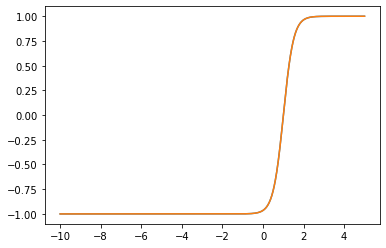

In [26]:
import timeit
x=np.linspace(-10,5,1500)
def tth1():
    return tanh_norm(x,m=1,d=2)

def tth2():
    return tanh_norm2(x,m=1,d=2)

print(timeit.timeit(tth1,number=10000))
print(timeit.timeit(tth2,number=10000))


plt.plot(x,tanh_norm(x,m=1,d=2))
plt.plot(x,tanh_norm2(x,m=1,d=2))

1.0


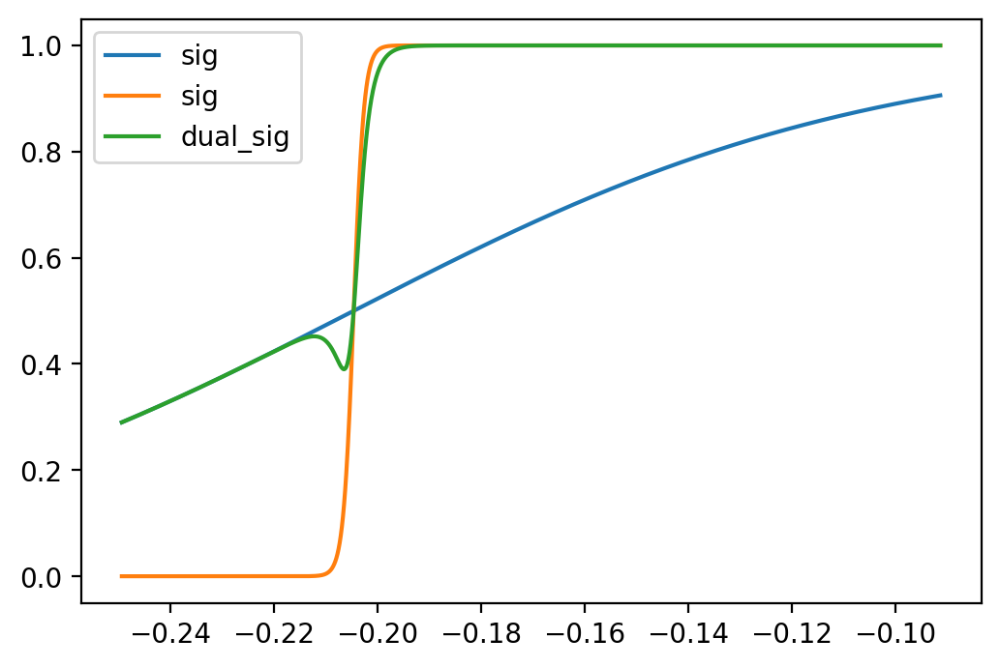

In [72]:
def sig_norm2(x,m,d1,d2):
    dt=max(d1/d2,d2/d1)*10
    s1=sig_norm(x, m, d1)
    s2=sig_norm(x, m, d2)
    st=sig_norm(x, m, dt)
    print(st.max())
    return s1*(1-st)+s2*st

plt.figure(dpi=200)
x=np.linspace(-0.24928776919841766,-0.09125697612762451,1500)
m=2
d2=2
d1=1

idx=np.abs(x-m).argmin()

x1=x[:idx]
x2=x[idx:]


#plt.plot(x,sig_norm(x,m,d1),label="sig1")
#plt.plot(x,sig_norm(x,m,d2),label="sig2")


#dev=np.concatenate([sig_deriv(x1,m=m,d=d1),sig_deriv(x2,m=m,d=d2),])
#plt.plot(x,dev)

#cs=np.cumsum(dev)

#plt.plot(x,cs*sig.max()/cs.max())
plt.plot(x,sig_norm(x,-0.204521478465873228,20),label="sig")
plt.plot(x,sig_norm(x,-0.204521478465873228,1000),label="sig")
plt.plot(x,sig_norm2(x,-0.204521478465873228,20,1000),label="dual_sig")

sig=np.concatenate([sig_norm(x1,m=m,d=d1),sig_norm(x2,m=m,d=d2),])
#plt.plot(x,sig,"--",label="concat sig")

plt.legend()



In [ ]:
x=np.linspace(-4,2,20)
a1=np.linspace(0,1,100)
a2=sig_norm(x)
indices = np.abs(np.subtract.outer(a2,a1)).argmin(0)

plt.plot(x,a2)
display(a1)
#display(a2)
plt.plot(x[indices],a2[indices],"o")
indices